# Selecting the city for our investment

In [ ]:
#connecting my google drive to save the figures and data there 

from google.colab import drive
drive.mount('/content/drive')
%cd drive/MyDrive/Coursera Capstone


Mounted at /content/drive
/content/drive/MyDrive/Coursera Capstone


In [ ]:
%pwd

'/content/drive/MyDrive/Coursera Capstone'

In [ ]:
import sys
sys.path.insert(0, '/functions')

In [ ]:
# first install the needed libraries
!pip install bs4
!pip install requests

In [ ]:
# next import the needed libraries for the web scraping 
from bs4 import BeautifulSoup # this helps us to make objects from the HTML document (tree like manner)
import requests  # this is for requests making using HTTP requests
import pandas as pd # this is for the dataframe structure

In [ ]:
url = "https://www.globalpropertyguide.com/most-expensive-cities"

In [ ]:
# use the request library to retrieve the HTML from the page, in a text format
data  = requests.get(url).text

In [ ]:
soup = BeautifulSoup(data,"html5lib")

In [ ]:
table = soup.find('table')

In [ ]:
# let's make an empty list for holding the dictionaries that we will retrieve from our Wikipedia table 
dict_list = []

In [ ]:
dict_table = {}
list_city = []
list_house = []
list_ratio = []
list_rent = []

i = 0 

for k,row in enumerate(table.findAll('td')):
    #print(k)
    if(k % 5 == 0):
        if(k == 0):
            pass
        else:
            i = 0
            dict_list.append(dict_table)
            dict_table = {}
    #print(i)
    #print((row["data-sort-value"]))
    if i == 0:
        list_city.append(row["data-sort-value"])
        
    elif i == 1:
        list_house.append(row["data-sort-value"])
        
    elif i == 2:
        list_ratio.append(row["data-sort-value"])

    elif i == 3:
        list_rent.append(row["data-sort-value"])
        
    elif i == 4:
        pass

    i += 1

dict_table["City"] = list_city
dict_table["Average buying price per sq.m.($)"] = list_house
dict_table["Price/Rent ratio(x)"] = list_ratio
dict_table["Rent/Month ($)"] = list_rent


print(dict_table)

{'City': ['Hong Kong, Hong Kong Island', 'UK, London', 'US, New York', 'Israel, Tel Aviv', 'Switzerland, Geneva', 'Japan, Tokyo', 'France, Paris', 'Singapore', 'Austria, Vienna', 'China, Beijing', 'Canada, Toronto', 'India, Mumbai', 'Finland, Helsinki', 'Taiwan, Taipei', 'Norway, Oslo', 'Australia, Sydney', 'Sweden, Stockholm', 'Netherlands, Amsterdam', 'Czech Republic, Prague', 'Italy, Rome', 'Russia, Moscow', 'Germany, Berlin', 'Bermuda', 'BVI, Tortola', 'Spain, Madrid', 'UAE, Dubai', 'Luxembourg', 'Turkey, Istanbul', 'Malta, Valleta', 'Denmark, Copenhagen', 'New Zealand, Auckland', 'Thailand, Bangkok', 'Brazil, Sao Paolo', 'Portugal, Lisbon', 'Slovenia, Ljubljana', 'Greece, Athens', 'Barbados, St James', 'South Africa, Cape Town', 'Cayman Is., Grand Cayman', 'Estonia, Tallinn', 'Philippines, Metro Manila', 'Belgium, Brussels', 'Turks and Caicos Is., Providenciales', 'Lebanon, Beirut', 'Argentina, Buenos Aires', 'Bahamas', 'Andorra', 'Slovakia, Bratislava', 'Panama, Panama City', 'An

In [ ]:
cities_df = pd.DataFrame(dict_table)


In [ ]:
cities_df.head()

,City,Average buying price per sq.m.($),Price/Rent ratio(x),Rent/Month ($)
0,"Hong Kong, Hong Kong Island",28570,43,7267
1,"UK, London",26262,36,5846
2,"US, New York",17191,34,4942
3,"Israel, Tel Aviv",17149,37,4591
4,"Switzerland, Geneva",16467,32,4122


In [ ]:
cities_df.shape

(93, 4)

In [ ]:
cities_df.describe()

,City,Average buying price per sq.m.($),Price/Rent ratio(x),Rent/Month ($)
count,93,93,93,93
unique,93,92,35,86
top,"Hong Kong, Hong Kong Island",1455,0,0
freq,1,2,8,8


In [ ]:
cities_df.dtypes

City                                 object
Average buying price per sq.m.($)    object
Price/Rent ratio(x)                  object
Rent/Month ($)                       object
dtype: object

In [ ]:
cities_df[['Average buying price per sq.m.($)', 'Price/Rent ratio(x)', 'Rent/Month ($)']] = cities_df[['Average buying price per sq.m.($)', 'Price/Rent ratio(x)', 'Rent/Month ($)']].astype(float)

In [ ]:
cities_df.head()

,City,Average buying price per sq.m.($),Price/Rent ratio(x),Rent/Month ($)
0,"Hong Kong, Hong Kong Island",28570.0,43.0,7267.0
1,"UK, London",26262.0,36.0,5846.0
2,"US, New York",17191.0,34.0,4942.0
3,"Israel, Tel Aviv",17149.0,37.0,4591.0
4,"Switzerland, Geneva",16467.0,32.0,4122.0


In [ ]:
bar_df = cities_df[['City', 'Average buying price per sq.m.($)']]
bar_df = bar_df.sort_values(by=['Average buying price per sq.m.($)'], ascending=True).reset_index()
bar_df['index'] += 1
bar_df.rename(columns ={'index' : 'PlaceInList'}, inplace= True )
bar_df


,PlaceInList,City,Average buying price per sq.m.($)
0,93,"Tanzania, Dar es Salaam",700.0
1,92,"Egypt, Cairo",831.0
2,91,"Nicaragua, Managua",893.0
3,90,"Puerto Rico, San Juan",1007.0
4,89,"El Salvador, San Salvador",1193.0
...,...,...,...
88,5,"Switzerland, Geneva",16467.0
89,4,"Israel, Tel Aviv",17149.0
90,3,"US, New York",17191.0
91,2,"UK, London",26262.0


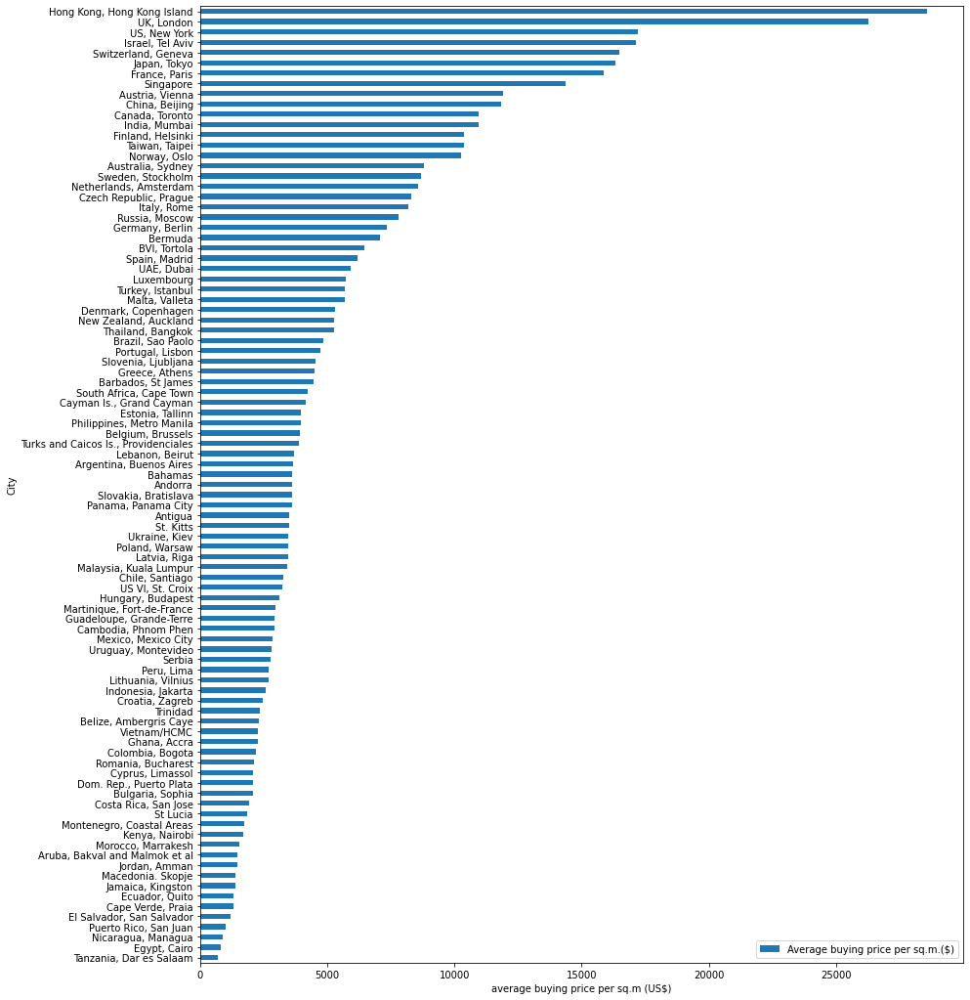

In [ ]:
import matplotlib.pyplot as plt

bar_df.plot(x='City', y='Average buying price per sq.m.($)', kind = 'barh' , figsize = (14,18))
plt.xlabel('average buying price per sq.m (US$)');
plt.savefig('figures/average_buying_sq.png')

In [ ]:
cities_df.describe()

,Average buying price per sq.m.($),Price/Rent ratio(x),Rent/Month ($)
count,93.000000,93.000000,93.00000
mean,5522.268817,21.817204,1836.88172
std,5167.366063,11.489074,1360.96830
min,700.000000,0.000000,0.00000
25%,2322.000000,15.000000,1055.00000
50%,3615.000000,21.000000,1535.00000
75%,6469.000000,29.000000,2479.00000
max,28570.000000,52.000000,7267.00000


In [ ]:
choosen = cities_df[cities_df['Average buying price per sq.m.($)'] < 6000.0]

In [ ]:
choosen.head()

,City,Average buying price per sq.m.($),Price/Rent ratio(x),Rent/Month ($)
25,"UAE, Dubai",5918.0,19.0,3070.0
26,Luxembourg,5710.0,23.0,1955.0
27,"Turkey, Istanbul",5680.0,52.0,887.0
28,"Malta, Valleta",5674.0,30.0,1540.0
29,"Denmark, Copenhagen",5306.0,21.0,2071.0


In [ ]:
choosen.sort_values(by=['Average buying price per sq.m.($)'], ascending=False)

,City,Average buying price per sq.m.($),Price/Rent ratio(x),Rent/Month ($)
25,"UAE, Dubai",5918.0,19.0,3070.0
26,Luxembourg,5710.0,23.0,1955.0
27,"Turkey, Istanbul",5680.0,52.0,887.0
28,"Malta, Valleta",5674.0,30.0,1540.0
29,"Denmark, Copenhagen",5306.0,21.0,2071.0
...,...,...,...,...
88,"El Salvador, San Salvador",1193.0,12.0,1013.0
89,"Puerto Rico, San Juan",1007.0,14.0,717.0
90,"Nicaragua, Managua",893.0,13.0,1146.0
91,"Egypt, Cairo",831.0,11.0,977.0


In [ ]:
avg_list = choosen['Average buying price per sq.m.($)'].tolist()
ratio_list = choosen['Price/Rent ratio(x)'].tolist()
month_list = choosen['Rent/Month ($)'].tolist()


In [ ]:
choosen.describe()

,Average buying price per sq.m.($),Price/Rent ratio(x),Rent/Month ($)
count,68.000000,68.000000,68.000000
mean,3050.088235,17.852941,1326.897059
std,1342.992545,9.246645,744.070293
min,700.000000,0.000000,0.000000
25%,2074.000000,13.000000,962.750000
50%,2959.500000,18.500000,1328.000000
75%,3896.000000,22.000000,1614.250000
max,5918.000000,52.000000,3070.000000


In [ ]:
from mpl_toolkits import mplot3d

In [ ]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/tsatools.py:117: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


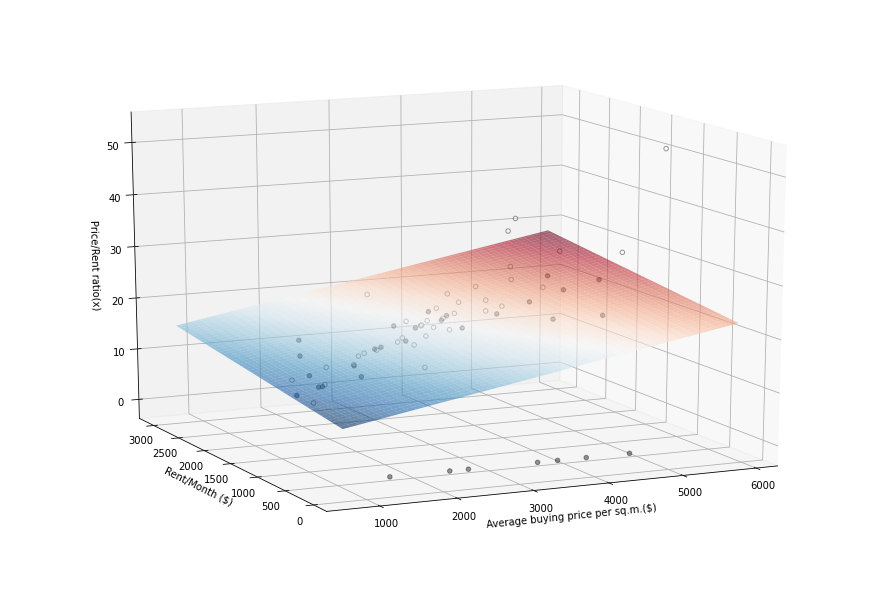

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
import statsmodels.api as sm


X = choosen[['Average buying price per sq.m.($)', 'Rent/Month ($)']]
y = choosen['Price/Rent ratio(x)']

X = sm.add_constant(X)
est = sm.OLS(y, X).fit()

xx1, xx2 = np.meshgrid(np.linspace(X['Average buying price per sq.m.($)'].min(), X['Average buying price per sq.m.($)'].max(), 100), 
                       np.linspace(X['Rent/Month ($)'].min(), X['Rent/Month ($)'].max(), 100))

# plot the hyperplane by evaluating the parameters on the grid
Z = est.params[0] + est.params[1] * xx1 + est.params[2] * xx2

# create matplotlib 3d axes
fig = plt.figure(figsize=(12, 8))
ax = Axes3D(fig, azim=-115, elev=15)

# plot hyperplane
surf = ax.plot_surface(xx1, xx2, Z, cmap=plt.cm.RdBu_r, alpha=0.6, linewidth=0)

# plot data points - points over the HP are white, points below are black
resid = y - est.predict(X)
ax.scatter(X[resid >= 0]['Average buying price per sq.m.($)'], X[resid >= 0]['Rent/Month ($)'], y[resid >= 0], color='black', alpha=0.4, facecolor='white')
ax.scatter(X[resid < 0]['Average buying price per sq.m.($)'], X[resid < 0]['Rent/Month ($)'], y[resid < 0], color='black', alpha=0.4)

# set axis labels
ax.set_xlabel('Average buying price per sq.m.($)')
ax.set_ylabel('Rent/Month ($)')
ax.set_zlabel('Price/Rent ratio(x)')
plt.savefig('figures/3dplot.png')

In [ ]:
# rent higher than 1500 $ and ratio below 25

In [ ]:
limited_choosen = choosen[choosen['Rent/Month ($)'] > 1500]
limited_choosen = limited_choosen[limited_choosen['Price/Rent ratio(x)'] <= 21]
limited_choosen.head().reset_index(drop=True)

,City,Average buying price per sq.m.($),Price/Rent ratio(x),Rent/Month ($)
0,"UAE, Dubai",5918.0,19.0,3070.0
1,"Denmark, Copenhagen",5306.0,21.0,2071.0
2,"Portugal, Lisbon",4749.0,18.0,1578.0
3,"Slovenia, Ljubljana",4535.0,21.0,1716.0
4,"Cayman Is., Grand Cayman",4163.0,14.0,3018.0


In [ ]:
limited_choosen.shape

(20, 4)

now I want to choose cities that are further west from the city where I currenly live, but also in Europe to be able to visit the place, or go on a holiday there.
So let's use geocoding by the geopy library to get the coordinates of the place where I live(Szeged, Hungary)
And the western end coordinates of Europe:
https://en.wikipedia.org/wiki/Extreme_points_of_Europe; from this scource 
so the mainland further west point is: Cabo da Roca, Portugal
the furthest southern mainland: Punta de Tarifa, Spain
the furthest northern mainland: Cape Nordkinn (Kinnarodden), Norway

In [ ]:
!pip install geopy

In [ ]:
from geopy.geocoders import Nominatim

In [ ]:
geolocator = Nominatim(user_agent="foursquare_agent")

In [ ]:
location_my_loc = geolocator.geocode('Szeged, Hungary')
location_west_loc = geolocator.geocode('Cabo da Roca, Portugal')
location_south = geolocator.geocode('Punta de Tarifa, Spain')
location_north = geolocator.geocode('Cape Nordkinn, Norway')

In [ ]:
latitude_my_loc = location_my_loc.latitude
longitude_my_loc = location_my_loc.longitude
latitude_west_loc = location_west_loc.latitude
longitude_west_loc = location_west_loc.longitude
latitude_north = location_north.latitude
latitude_south = location_south.latitude

print("The furthest west point coordinates are: lat {}, long {}".format(latitude_west_loc, longitude_west_loc))
print("My current city's coordinates are: lat {}, long {}".format(latitude_my_loc, longitude_my_loc))
print("The furthest north & south coordinates are {} & {}".format(latitude_north, latitude_south))

The furthest west point coordinates are: lat 38.7809045, long -9.4994163
My current city's coordinates are: lat 46.2546312, long 20.1486016
The furthest north & south coordinates are 71.126214 & 36.0080459


In [ ]:
# from the first run of the geocoding it can't find the location:Dom. Rep., Puerto Plata
# probably this is bc. of the abbrigation, but as long as it doesn't belong to Europe we simply drop it 
# same with: Aruba, Bakval and Malmok et al

# another error is with Montenegro costal areas. As long as the boggest city is: https://en.wikipedia.org/wiki/Herceg_Novi_Municipality
# we replace it by Herceg Novi, Montenegro

In [ ]:
print(limited_choosen.shape)

limited_choosen = limited_choosen[limited_choosen.City != 'Dom. Rep., Puerto Plata'].reset_index(drop = True)

print(limited_choosen.shape)

(20, 4)
(20, 4)


In [ ]:
print(limited_choosen.shape)

limited_choosen = limited_choosen[limited_choosen.City != 'Aruba, Bakval and Malmok et al'].reset_index(drop = True)
limited_choosen = limited_choosen[limited_choosen.City != 'Cayman Is., Grand Cayman'].reset_index(drop = True)
print(limited_choosen.shape)

(20, 4)
(18, 4)


In [ ]:
idx = limited_choosen.index[limited_choosen['City'] == 'Montenegro, Coastal Areas']
print(idx)
print(limited_choosen.loc[idx, 'City'])
limited_choosen.loc[idx, 'City'] = 'Herceg Novi, Montenegro'
print(limited_choosen.loc[idx, 'City'])

Int64Index([], dtype='int64')
Series([], Name: City, dtype: object)
Series([], Name: City, dtype: object)


In [ ]:
idx = limited_choosen.index[limited_choosen['City'] == 'Luxembourg']
print(idx)
print(limited_choosen.loc[idx, 'City'])
limited_choosen.loc[idx, 'City'] = 'Luxembourg city, Luxembourg'
print(limited_choosen.loc[idx, 'City'])

Int64Index([], dtype='int64')
Series([], Name: City, dtype: object)
Series([], Name: City, dtype: object)


In [ ]:
limited_choosen

,City,Average buying price per sq.m.($),Price/Rent ratio(x),Rent/Month ($)
0,"UAE, Dubai",5918.0,19.0,3070.0
1,"Denmark, Copenhagen",5306.0,21.0,2071.0
2,"Portugal, Lisbon",4749.0,18.0,1578.0
3,"Slovenia, Ljubljana",4535.0,21.0,1716.0
4,"Estonia, Tallinn",3956.0,20.0,1560.0
5,"Philippines, Metro Manila",3952.0,16.0,2422.0
6,Bahamas,3632.0,12.0,2964.0
7,"Panama, Panama City",3606.0,17.0,2075.0
8,St. Kitts,3496.0,20.0,1712.0
9,"Ukraine, Kiev",3481.0,11.0,2550.0


In [ ]:
# now let's get the coordinates of the cities using reverse geocoding 
geolocator = Nominatim(user_agent="ask-coord")

x = limited_choosen['City'].tolist()
print(x)
lat_temp = []
long_temp = []


for city in x:
    location = None
    location = geolocator.geocode(city, language='en')
    print(city)
    print(location)
    
    lat_temp.append(location.latitude)
    
    long_temp.append(location.longitude)
    if(location == None):
        print('warning')

lat_x = pd.Series(lat_temp)
long_x = pd.Series(long_temp)

['UAE, Dubai', 'Denmark, Copenhagen', 'Portugal, Lisbon', 'Slovenia, Ljubljana', 'Estonia, Tallinn', 'Philippines, Metro Manila', 'Bahamas', 'Panama, Panama City', 'St. Kitts', 'Ukraine, Kiev', 'Poland, Warsaw', 'Martinique, Fort-de-France', 'Guadeloupe, Grande-Terre', 'Cambodia, Phnom Phen', 'Indonesia, Jakarta', 'Trinidad', 'Ghana, Accra', 'Jordan, Amman']
UAE, Dubai
Dubai, 39205, United Arab Emirates
Denmark, Copenhagen
Copenhagen, 1357, Denmark
Portugal, Lisbon
Lisbon, 1100-148, Portugal
Slovenia, Ljubljana
Ljubljana, Upravna Enota Ljubljana, 1000, Slovenia
Estonia, Tallinn
Tallinn, Harju maakond, Estonia
Philippines, Metro Manila
Metro Manila, Philippines
Bahamas
The Bahamas
Panama, Panama City
Panama, Calidonia, Distrito Panamá, Panamá, 080807, Panama
St. Kitts
Saint Kitts, Saint John Capisterre, Saint Kitts, Saint Kitts and Nevis
Ukraine, Kiev
Kyiv, Ukraine
Poland, Warsaw
Warsaw, Masovian Voivodeship, Poland
Martinique, Fort-de-France
Fort-de-France, Martinique, France
Guadeloup

In [ ]:
limited_choosen['Latitude'] = lat_x
limited_choosen['Longitude'] = long_x

In [ ]:
limited_choosen.head()

,City,Average buying price per sq.m.($),Price/Rent ratio(x),Rent/Month ($),Latitude,Longitude
0,"UAE, Dubai",5918.0,19.0,3070.0,25.265347,55.292491
1,"Denmark, Copenhagen",5306.0,21.0,2071.0,55.686724,12.570072
2,"Portugal, Lisbon",4749.0,18.0,1578.0,38.707751,-9.136592
3,"Slovenia, Ljubljana",4535.0,21.0,1716.0,46.050027,14.506929
4,"Estonia, Tallinn",3956.0,20.0,1560.0,59.437216,24.745369


In [ ]:
# set limitations 
limited_choosen_eu = limited_choosen[limited_choosen['Longitude']<longitude_my_loc]
limited_choosen_eu = limited_choosen_eu[limited_choosen_eu['Longitude']>longitude_west_loc]
limited_choosen_eu = limited_choosen_eu[limited_choosen_eu['Latitude']>latitude_south]
limited_choosen_eu = limited_choosen_eu[limited_choosen_eu['Latitude']<latitude_north].reset_index(drop = True)

limited_choosen_eu

,City,Average buying price per sq.m.($),Price/Rent ratio(x),Rent/Month ($),Latitude,Longitude
0,"Denmark, Copenhagen",5306.0,21.0,2071.0,55.686724,12.570072
1,"Portugal, Lisbon",4749.0,18.0,1578.0,38.707751,-9.136592
2,"Slovenia, Ljubljana",4535.0,21.0,1716.0,46.050027,14.506929


In [ ]:
limited_choosen_eu.shape


(3, 6)

Now we have 4 cities that are affordable for us and also well located.
We want to move to a city that is historic so we will use the Forsquare API to get the historical venues of the city near the center(in a 3 km sphere)

First let's visualize the cities in a map centered to Western Europe. The center could be Geneva,Switzerland 

In [ ]:
address = 'Geneva,Switzerland'
geolocator = Nominatim(user_agent="foursquare_agent")
location_center = geolocator.geocode('Geneva,Switzerland')

In [ ]:
lat_c = location_center.latitude
long_c = location_center.longitude

print('The geograpical coordinate of Geneva are {}, {}.'.format(lat_c, long_c))
print(lat_c, long_c)

The geograpical coordinate of Geneva are 46.2017559, 6.1466014.
46.2017559 6.1466014


In [ ]:
!pip install folium==0.5.0 

     |████████████████████████████████| 79 kB 2.9 MB/s 
  Created wheel for folium: filename=folium-0.5.0-py3-none-any.whl size=76133 sha256=146b0bb25e819714eaf5528da1e1c7c0e5954c02269c53fc2af2924cca365fa2
  Stored in directory: /root/.cache/pip/wheels/b2/2f/2c/109e446b990d663ea5ce9b078b5e7c1a9c45cca91f377080f8
Successfully built folium
  Attempting uninstall: folium
    Found existing installation: folium 0.8.3
    Uninstalling folium-0.8.3:
      Successfully uninstalled folium-0.8.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.5.0 which is incompatible.


In [ ]:
import folium # map rendering library

In [ ]:
map_weu = folium.Map(location=[lat_c, long_c], zoom_start=4)
map_weu

# add markers to map
for lat, lng, city in zip(limited_choosen_eu['Latitude'], limited_choosen_eu['Longitude'], limited_choosen_eu['City']):
    label = '{}'.format(city)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='purple',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_weu)  
    
map_weu

Give Forsquare API credentials:
    

In [ ]:
CLIENT_ID = 'EUYYTGDFEA2H1PQWHDN5YFJRMC2LMUOFWSLQUL0TG2QLSHXT' # your Foursquare ID
CLIENT_SECRET = 'MYDFU44LUCG3Y4DXHA3WO0YB2XX3H5BY1MVAR1OFCEZZGHID' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: EUYYTGDFEA2H1PQWHDN5YFJRMC2LMUOFWSLQUL0TG2QLSHXT
CLIENT_SECRET:MYDFU44LUCG3Y4DXHA3WO0YB2XX3H5BY1MVAR1OFCEZZGHID


In [ ]:
# Category IDs corresponding to cultural venues were taken from Foursquare web site (https://developer.foursquare.com/docs/resources/categories):
#https://developer.foursquare.com/docs/build-with-foursquare/categories/
import requests
entertainment_cat = '4d4b7104d754a06370d81259' # 'Root' category for all entertainment-related venues

cultural_venues = ['56aa371be4b08b9a8d5734db','4bf58dd8d48988d1e2931735','4bf58dd8d48988d18e941735',
                   '5032792091d4c4b30a586d5c','56aa371be4b08b9a8d573532','4deefb944765f83613cdba6e',
                   '5642206c498e4bfca532186c','4bf58dd8d48988d181941735','4bf58dd8d48988d18f941735',
                   '4bf58dd8d48988d190941735','4bf58dd8d48988d192941735','4bf58dd8d48988d191941735',
                   '4bf58dd8d48988d1e5931735','4bf58dd8d48988d1f2931735','4bf58dd8d48988d136941735',
                   '4bf58dd8d48988d137941735','507c8c4091d498d9fc8c67a9','4bf58dd8d48988d17b941735']

def is_entertain_cultur(categories, specific_filter=None):
    entertain = False
    historic = False
    for c in categories:
        category_id = c[1]
        if category_id == entertainment_cat:
            entertain = True
            
        if not(specific_filter is None) and (category_id in specific_filter):
            historic = True
            entertain = True
    return entertain, historic

def get_categories(categories):
    return [(cat['name'], cat['id']) for cat in categories]

def format_address(location):
    address = ', '.join(location['formattedAddress'])
    return address

def get_venues_near_location(lat, lon, category, client_id, client_secret, radius=1500, limit=200):
    version = '20180724'
    url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&v={}&ll={},{}&categoryId={}&radius={}&limit={}'.format(
        client_id, client_secret, version, lat, lon, category, radius, limit)
    try:
        results = requests.get(url).json()['response']['groups'][0]['items']
        venues = [(item['venue']['id'],
                   item['venue']['name'],
                   get_categories(item['venue']['categories']),
                   (item['venue']['location']['lat'], item['venue']['location']['lng']),
                   format_address(item['venue']['location']),
                   item['venue']['location']['distance']) for item in results]        
    except:
        venues = []
    return venues

In [ ]:
x = limited_choosen_eu.loc[0, 'Latitude']
x

55.6867243

In [ ]:
venues = []
venues = get_venues_near_location(limited_choosen_eu.loc[0, 'Latitude'],limited_choosen_eu.loc[0, 'Longitude'], entertainment_cat, CLIENT_ID, CLIENT_SECRET, radius = 1500, limit = 100)
venues

[('4adcdafdf964a520e95d21e3',
  'Statens Museum for Kunst - SMK',
  [('Art Museum', '4bf58dd8d48988d18f941735')],
  (55.68857458177556, 12.578398880888566),
  'Sølvgade 48-50 (Øster Voldgade), 1307 København, Danmark',
  561),
 ('4adcdb01f964a5209c5e21e3',
  'Nørrebro Teater',
  [('Theater', '4bf58dd8d48988d137941735')],
  (55.68803876252058, 12.5612756792689),
  'Ravnsborggade 3, 2200 København N, Danmark',
  571),
 ('4adcdb01f964a520835e21e3',
  'Cinemateket',
  [('Indie Movie Theater', '4bf58dd8d48988d17e941735')],
  (55.68318172182592, 12.578595853138816),
  'Gothersgade 55, 1123 København, Danmark',
  664),
 ('51fe269e498ee2b1c65ec806',
  'Rosenborg Treasury',
  [('History Museum', '4bf58dd8d48988d190941735')],
  (55.685847787355264, 12.577401717713116),
  'Øster Volgade 4A, 1350, Danmark',
  470),
 ('4b50fc4af964a520013c27e3',
  'Davids Samling',
  [('Art Museum', '4bf58dd8d48988d18f941735')],
  (55.68427136620368, 12.582560933432474),
  'Kronprinsessegade 30, 1306 København K, D

In [ ]:
latitudes = limited_choosen_eu['Latitude'].tolist()
longitudes = limited_choosen_eu['Longitude'].tolist()
city = limited_choosen_eu['City'].tolist()
for i in zip(latitudes, longitudes, city):
    print(i)

(55.6867243, 12.5700724, 'Denmark, Copenhagen')
(38.7077507, -9.1365919, 'Portugal, Lisbon')
(46.0500268, 14.5069289, 'Slovenia, Ljubljana')


In [ ]:
def get_historical_venues(lats, lons, city):
    entertainments = {}
    historic_venues = {}
    ent_Cop = []
    ent_Lis = []
    ent_Lju = []

    print('Obtaining venues around candidate locations:', end='')
    for lat, lon, city in zip(lats, lons, city):
        # Using radius=350 to meke sure we have overlaps/full coverage so we don't miss any restaurant (we're using dictionaries to remove any duplicates resulting from area overlaps)
        venues = get_venues_near_location(lat, lon, entertainment_cat, CLIENT_ID, CLIENT_SECRET, radius=3000, limit=100)
        print(venues)
        area_ent = []
        for venue in venues:
            venue_id = venue[0]
            venue_name = venue[1]
            venue_categories = venue[2]
            venue_latlon = venue[3]
            venue_address = venue[4]
            venue_distance = venue[5]
            is_ent, is_hist = is_entertain_cultur(venue_categories, specific_filter=cultural_venues)
            if is_ent:
                entertain = (venue_id, venue_name, venue_latlon[0], venue_latlon[1], venue_address, venue_distance, is_hist)
                
                area_ent.append(entertain)
                entertainments[venue_id] = entertain
                if is_hist:
                    historic_venues[venue_id] = entertain
                    if city == 'Denmark, Copenhagen': 
                        ent_Cop.append(entertain)
                    elif city == 'Portugal, Lisbon': 
                        ent_Lis.append(entertain)
                    elif city == 'Slovenia, Ljubljana': 
                        ent_Lju.append(entertain)
        print(' .', end='')
    print(' done.')
    return historic_venues, len(ent_Cop), len(ent_Lis), len(ent_Lju)

historic_venues = {}

historic_venues, cop, lis, lju = get_historical_venues(latitudes, longitudes, city)

Obtaining venues around candidate locations:[('4adcdafdf964a520e95d21e3', 'Statens Museum for Kunst - SMK', [('Art Museum', '4bf58dd8d48988d18f941735')], (55.68857458177556, 12.578398880888566), 'Sølvgade 48-50 (Øster Voldgade), 1307 København, Danmark', 561), ('4adcdb01f964a520835e21e3', 'Cinemateket', [('Indie Movie Theater', '4bf58dd8d48988d17e941735')], (55.68318172182592, 12.578595853138816), 'Gothersgade 55, 1123 København, Danmark', 664), ('4adcdb01f964a5209c5e21e3', 'Nørrebro Teater', [('Theater', '4bf58dd8d48988d137941735')], (55.68803876252058, 12.5612756792689), 'Ravnsborggade 3, 2200 København N, Danmark', 571), ('4b50fc4af964a520013c27e3', 'Davids Samling', [('Art Museum', '4bf58dd8d48988d18f941735')], (55.68427136620368, 12.582560933432474), 'Kronprinsessegade 30, 1306 København K, Danmark', 829), ('51fe269e498ee2b1c65ec806', 'Rosenborg Treasury', [('History Museum', '4bf58dd8d48988d190941735')], (55.685847787355264, 12.577401717713116), 'Øster Volgade 4A, 1350, Danmark',

In [ ]:
num_historic_sites = [cop, lis, lju]
num_historic_sites

[81, 76, 50]

In [ ]:
print('Total number of historical sites in the 3 cities {}.'.format(len(historic_venues)))
print('The number of sites in Luxembourg: {} ,Copenhagen: {},Lisaboa: {}, Ljubljana: {}'.format(17, 82, 72, 50))
print(cop, lis, lju)

Total number of historical sites in the 3 cities 207.
The number of sites in Luxembourg: 17 ,Copenhagen: 82,Lisaboa: 72, Ljubljana: 50
81 76 50


In [ ]:
name_cities = ['Copenhagen', 'Lisboa', 'Ljubljana']
name_cities

['Copenhagen', 'Lisboa', 'Ljubljana']

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('ggplot')

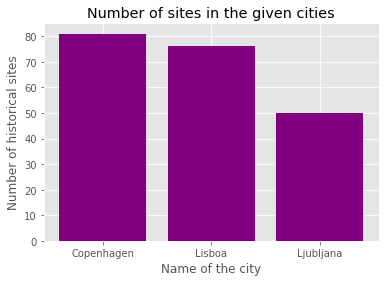

In [ ]:
name_pos = [i for i, _ in enumerate(name_cities)]

plt.bar(name_pos, num_historic_sites, color='purple')
plt.xlabel("Name of the city")
plt.ylabel("Number of historical sites")
plt.title("Number of sites in the given cities")

plt.xticks(name_pos, name_cities)

plt.savefig('figures/hist_venues.png')
plt.show()


To conclude this part, we have gathered information on the sqr m parameters and the rent fees in different capitals in the world. We had an initial money range that we could spend/sqrm and also we set a minimum for the money income we want to get/month. Besides that to get a good investment we wanted to have a low price/rent ratio. Now this is the money constraints which served as our initial filter.

The second filter was that the location should be in Western Europe. This is partly a cultural and economical need, and partly a personal preference, to be able to visit the place once/year. 

With our geographical and financial constraints we have been left with only 3 cities. 

As long as we want to rent the house to tourists who are interested in siteseeing and not only parties it is important to have our estate in a city that is full of historical buildings.

Geopy gave back the coordinates of the city centers and we have set a range limit from that to 3000 m. In this range it has turned out that Copenhagen had the highest number of sites in its center.

With these consedirations the target city of our exploration will be __Copenhagen__.

# End of part one 

# Part 2

In this part we want to use data from this site: http://insideairbnb.com/index.html. The data is on the one hand fresh /2021 february/, and on the other hand very well detailed. 

First let's explore the available informations  clean and visualize the data. 

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# important to get the raw files HTTP address to load the .csv file 
url = 'https://raw.githubusercontent.com/antalpatrik21/Coursera_Capstone/main/listings%20(1).csv'

In [ ]:
airbnb_1 = pd.read_csv(url)

In [ ]:
airbnb_1.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,6983,Copenhagen 'N Livin',16774,Simon,NaN,Nrrebro,55.68798,12.54571,Private room,354,2,168,2019-07-19,1.20,1,0
1,26057,Lovely house - most attractive area,109777,Kari,NaN,Indre By,55.69163,12.57459,Entire home/apt,2400,3,50,2019-12-14,0.57,1,363
2,29118,Best Location in Cool Istedgade,125230,Nana,NaN,Vesterbro-Kongens Enghave,55.67069,12.55430,Entire home/apt,725,7,22,2019-08-02,0.17,1,177
3,31094,"Very central and cozy, new kitchen",129976,Ebbe,NaN,Vesterbro-Kongens Enghave,55.66744,12.55516,Entire home/apt,750,2,17,2017-08-25,0.13,1,301
4,32379,120 m2 artist flat on Vesterbro,140105,Lise,NaN,Vesterbro-Kongens Enghave,55.67297,12.55327,Entire home/apt,930,3,73,2019-08-17,0.57,1,54


In [ ]:
lats_rent = airbnb_1['latitude'].tolist() 
longs_rent = airbnb_1['longitude'].tolist() 

In [ ]:
print(lats_rent[ : 10])
print(longs_rent[: 10])

[55.68798, 55.69163, 55.67069, 55.66744, 55.67297, 55.71158, 55.68572, 55.66782, 55.70491, 55.68575]
[12.54571, 12.57459, 12.5543, 12.55516, 12.55327, 12.56879, 12.56749, 12.54843, 12.55331, 12.53567]


In [ ]:
print(f'There are {airbnb_1.id.nunique()} unique records in the listing data.')

There are 8785 unique records in the listing data.


In [ ]:
airbnb_1.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

In [ ]:
neighbourhoods = airbnb_1.groupby(by='neighbourhood').count()[['id']].sort_values(by='id', ascending=False)
neighbourhoods

,id
neighbourhood,
Indre By,1677
Vesterbro-Kongens Enghave,1360
Nrrebro,1301
Frederiksberg,980
sterbro,950
Amager Vest,812
Amager st,630
Valby,366
Bispebjerg,310


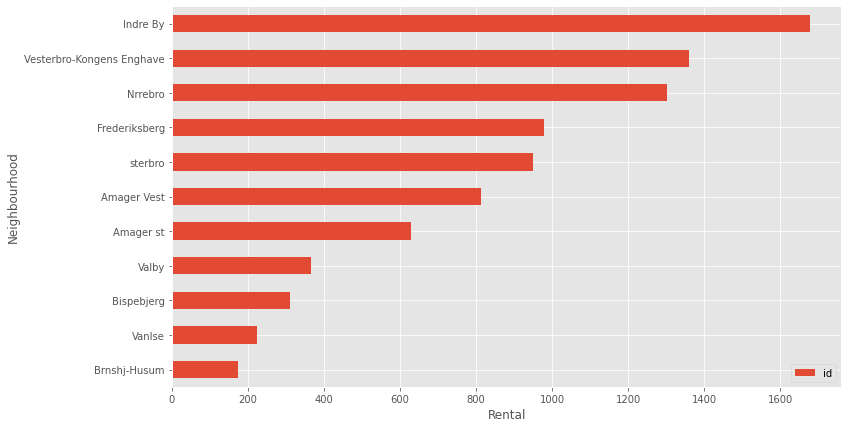

In [ ]:
neighbourhoods.sort_values(by='id').plot(kind='barh' , figsize = (12,7))
plt.ylabel('Neighbourhood')
plt.xlabel('Rental')
plt.savefig('figures/neighbourhoods.png')

### Let's import the GeoJSON file to have the neighborhoods in the area. 

In [ ]:
# now let's use the url of the raw file to have the GeoJSON file 

copenhagen_boroughs_url = 'https://raw.githubusercontent.com/antalpatrik21/Coursera_Capstone/main/neighbourhoods%20(1).geojson'
copenhagen_boroughs = requests.get(copenhagen_boroughs_url).json()

def boroughs_style(feature):
    return { 'color': 'blue', 'fill': False }

According to sites the main square of Copenhagen is the __City Hall Square__. So let's retrieve the coordinates of it and use it as the center of our map.

In [ ]:
address = 'City Hall Square,Copenhagen, Denmark'
geolocator = Nominatim(user_agent="foursquare_agent")
location_center = geolocator.geocode(address)
lat_c_cop = location_center.latitude
long_c_cop = location_center.longitude
print(lat_c_cop, long_c_cop)

55.67606225 12.568908906831943


In [ ]:
# create map of Copenhagen  using latitude and longitude values
map_cop_centered_neigh = folium.Map(location=[lat_c_cop , long_c_cop], zoom_start=12)

# add markers to map
folium.Marker([lat_c_cop, long_c_cop],
              popup='CENTER-City Hall Square',
              icon=folium.Icon(color='black', icon_color='white', icon='fa-university ',  prefix='fa')
             ).add_to(map_cop_centered_neigh)

# with zip we can pair lists together
for lat, lon in zip(lats_rent, longs_rent):
    color = 'red' 
    folium.CircleMarker([lat, lon], radius=3, color=color, fill=True, fill_color=color, fill_opacity=1).add_to(map_cop_centered_neigh) 
folium.GeoJson(copenhagen_boroughs, style_function=boroughs_style, name='geojson').add_to(map_cop_centered_neigh)
map_cop_centered_neigh

In [ ]:
# add markers to map
folium.Marker([lat_c_cop, long_c_cop],
              popup='CENTER-City Hall Square',
              icon=folium.Icon(color='black', icon_color='white', icon='fa-university ',  prefix='fa')
             ).add_to(map_cop_centered_neigh)

# with zip we can pair lists together
for lat, lon in zip(lats_rent, longs_rent):
    color = 'red' 
    folium.CircleMarker([lat, lon], radius=3, color=color, fill=True, fill_color=color, fill_opacity=1).add_to(map_cop_centered_neigh) 

map_cop_centered_neigh

In [ ]:
rents_latlons = [[lat, lon] for lat, lon in zip(lats_rent, longs_rent)]

In [ ]:
from folium import plugins
from folium.plugins import HeatMap
cop_center = [lat_c_cop, long_c_cop]
map_cop_centered_neigh = folium.Map(location=[lat_c_cop, long_c_cop], zoom_start=12)
folium.TileLayer('cartodbpositron').add_to(map_cop_centered_neigh) #cartodbpositron cartodbdark_matter
HeatMap(rents_latlons).add_to(map_cop_centered_neigh)
folium.Marker([lat_c_cop, long_c_cop],
              popup='CENTER-City Hall Square',
              icon=folium.Icon(color='black', icon_color='white', icon='fa-university ',  prefix='fa')
             ).add_to(map_cop_centered_neigh)
folium.Circle(cop_center, radius=1000, fill=False, color='white').add_to(map_cop_centered_neigh)
folium.Circle(cop_center, radius=2000, fill=False, color='white').add_to(map_cop_centered_neigh)
folium.Circle(cop_center, radius=3000, fill=False, color='white').add_to(map_cop_centered_neigh)
folium.GeoJson(copenhagen_boroughs, style_function=boroughs_style, name='geojson').add_to(map_cop_centered_neigh)
map_cop_centered_neigh

Compare the heatmap to the bar chart it is obvious that the size of the regions are different so the total amount of appartmants might not be relevant. We want to have a place which is close to the city center so we may go with neighbourhoods that are more close to the city center. 

We have a promising region in Vesterbro/Kgs.Enghave  close to the center so we will limit our exploration on this region. But as we can see from the bar chart the it has the second largest number of rents. Another promising region is Osterbro that has a nearly empty region in the the promising 3km region and also the overall rent numbers are lower. 

It won't be a bad idea to make a grid using the center and find spots in this area that are not full of available rents. 
In the limited spots we could check for the surroundings of them and make a classification to see which neighbourhoods are idea for tourists, but not full of rents. 
Make a circle around them that is as big as the length limit for the Forsquare API calls. 

To do that we will generate a grid around the city center in a circle with a radius of 3 km. In it the grid points will represent the neighborhoods, and they will be equally distanced(600 m) from each other. The neighborhood will be a place that is within a 300 m range from the neighborhood center. 

To accurately calculate distances we need to create our grid of locations in Cartesian 2D coordinate system which allows us to calculate distances in meters (not in latitude/longitude degrees). Then we'll project those coordinates back to latitude/longitude degrees to be shown on Folium map. So let's create functions to convert between WGS84 spherical coordinate system (latitude/longitude degrees) and UTM Cartesian coordinate system (X/Y coordinates in meters).

In [ ]:
!pip install pyproj

     |████████████████████████████████| 6.3 MB 6.2 MB/s 


In [ ]:
import pyproj
import shapely.geometry

In [ ]:
import math

def lonlat_to_xy(lon, lat):
    proj_latlon = pyproj.Proj(proj='latlong',datum='WGS84')
    proj_xy = pyproj.Proj(proj="utm", zone=33, datum='WGS84')
    xy = pyproj.transform(proj_latlon, proj_xy, lat, lon)
    return xy[0], xy[1]

def xy_to_lonlat(x, y):
    proj_latlon = pyproj.Proj(proj='latlong',datum='WGS84')
    proj_xy = pyproj.Proj(proj="utm", zone=33, datum='WGS84')
    lonlat = pyproj.transform(proj_xy, proj_latlon, x, y)
    return lonlat[0], lonlat[1]


# Pitagoras: 

def calc_xy_distance(x1, y1, x2, y2):
    dx = x2 - x1
    dy = y2 - y1
    return math.sqrt(dx*dx + dy*dy)

print('Coordinate transformation check')
print('-------------------------------')
print('Copenhagen center longitude={}, latitude={}'.format(long_c_cop, lat_c_cop))
x, y = lonlat_to_xy(long_c_cop, lat_c_cop)
print('Coopenhagen center UTM X={}, Y={}'.format(x, y))
xy_to_lonlat(x, y)
la, lo = xy_to_lonlat(x, y)
print('Copenhagen center longitude={}, latitude={}'.format(lo, la))

Coordinate transformation check
-------------------------------
Copenhagen center longitude=12.568908906831943, latitude=55.67606225
Coopenhagen center UTM X=5296276.173749306, Y=1815170.6500095322
Copenhagen center longitude=12.56890890683196, latitude=55.676062250000015


In [ ]:
#ACT
xx, yy = lonlat_to_xy(long_c_cop, lat_c_cop) # City center in Cartesian coordinates

k = math.sqrt(3) / 2 # Vertical offset for hexagonal grid cells
x_min = xx - 3000
x_step = 300
y_min = yy - 3000 - (int(21/k)*k*300 - 6000)/2
y_step = 300 * k 

latitudes = []
longitudes = []
distances_from_center = []
xs = []
ys = []
for i in range(0, int(21/k)):
    y = y_min + i * y_step
    x_offset = 150 if i%2==0 else 0
    for j in range(0, 21):
        x = x_min + j * x_step + x_offset
        distance_from_center = calc_xy_distance(xx, yy, x, y)
        if (distance_from_center <= 3001):
            lat, lon = xy_to_lonlat(x, y)
            latitudes.append(lat)
            longitudes.append(lon)
            distances_from_center.append(distance_from_center)
            xs.append(x)
            ys.append(y)

print(len(latitudes), 'candidate neighborhood centers generated.')

364 candidate neighborhood centers generated.


In [ ]:
import numpy as np
xx, yy = lonlat_to_xy(long_c_cop, lat_c_cop) # City center in Cartesian coordinates
c = np.array([xx,yy])
n = 364
r = 3000


In [ ]:
import functions.grid as gr

In [ ]:
import importlib

In [ ]:
importlib.reload(gr)

<module 'functions.grid' from '/content/drive/MyDrive/Coursera Capstone/functions/grid.py'>

In [ ]:
cg = gr.disk_grid_fibonacci(n=n, r = r, c = c)

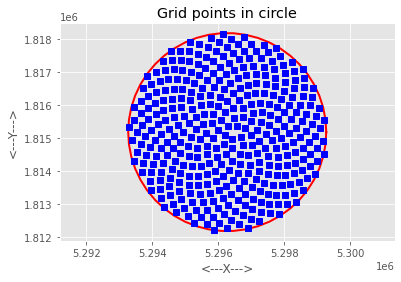


  Graphics data saved in file "ok"


In [ ]:
gr.disk_grid_display(n = n, r = r, c = c, ng = n, cg = cg, filename='ok' )

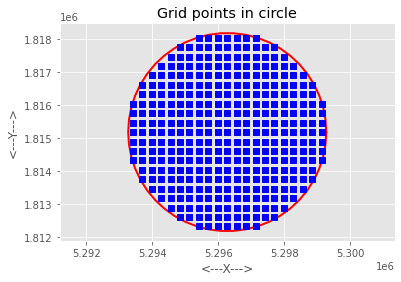


  Graphics data saved in file "okok"


In [ ]:
ng = gr.disk_grid_regular_count(n= 10,r=r,c=c)
cg = gr.disk_grid_regular(n = 10, r = r, c = c, ng = ng)
gr.disk_grid_display(n,r,c,ng,cg,'okok')

In [ ]:
ng

349

In [ ]:
cg.shape

(2, 349)

In [ ]:
cg[1]

array([1815170.65000953, 1815170.65000953, 1815170.65000953,
       1815170.65000953, 1815170.65000953, 1815170.65000953,
       1815170.65000953, 1815170.65000953, 1815170.65000953,
       1815170.65000953, 1815170.65000953, 1815170.65000953,
       1815170.65000953, 1815170.65000953, 1815170.65000953,
       1815170.65000953, 1815170.65000953, 1815170.65000953,
       1815170.65000953, 1815170.65000953, 1815170.65000953,
       1815456.36429525, 1814884.93572382, 1815456.36429525,
       1815456.36429525, 1814884.93572382, 1814884.93572382,
       1815456.36429525, 1815456.36429525, 1814884.93572382,
       1814884.93572382, 1815456.36429525, 1815456.36429525,
       1814884.93572382, 1814884.93572382, 1815456.36429525,
       1815456.36429525, 1814884.93572382, 1814884.93572382,
       1815456.36429525, 1815456.36429525, 1814884.93572382,
       1814884.93572382, 1815456.36429525, 1815456.36429525,
       1814884.93572382, 1814884.93572382, 1815456.36429525,
       1815456.36429525,

In [ ]:
import functions.utm as utm

In [ ]:

UTM = [12.57, 55.67]

In [ ]:
c.tolist()

[5296276.173749306, 1815170.6500095322]

In [ ]:
z, l, x, y = utm.project(UTM)
print(z)
print(l)

33
U


In [ ]:
lng, lat = utm.unproject(z, l, x, y)
print(lng)
print(lat)

12.57
55.669999999999995


In [ ]:
# convert back to long lat coordinates 
z = 33
l = 'U'
latitudes = []
longitudes = []
xs=[]
ys=[]
distances_from_center = []

for i in range(0, cg.shape[1]):
  x = cg[0][i]
  y = cg[1][i]
  xs.append(x)
  ys.append(y)
  distance_from_center = calc_xy_distance(xx, yy, x, y)
  distances_from_center.append(distance_from_center)
  lat, lon = utm.unproject(z,l,x, y)
  latitudes.append(lat)
  longitudes.append(lon)
print(len(latitudes), 'candidate neighborhood centers generated.')

349 candidate neighborhood centers generated.


As we had conversation difficulties the only goal for us is to make a grid that has equally distanced points in is 600m's from the center of another and 6 km's from the center. We want points that are in this range bc our original exploration on the heatmap targated this region. 

In [ ]:
map_cop_centered_neigh = folium.Map(location=cop_center, zoom_start=12)

# add markers to map
folium.Marker([lat_c_cop, long_c_cop],
              popup='CENTER-City Hall Square',
              icon=folium.Icon(color='black', icon_color='white', icon='fa-university ',  prefix='fa')
             ).add_to(map_cop_centered_neigh)


# with zip we can pair lists together
for lat, lon in zip(latitudes, longitudes):
    label = folium.Popup('Neigh', parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=10,
        popup=label,
        color='Neigh',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_cop_centered_neigh)  

folium.Circle(cop_center, radius=1000, fill=False, color='white').add_to(map_cop_centered_neigh)
folium.Circle(cop_center, radius=2000, fill=False, color='white').add_to(map_cop_centered_neigh)
folium.Circle(cop_center, radius=3000, fill=False, color='white').add_to(map_cop_centered_neigh)
folium.GeoJson(copenhagen_boroughs, style_function=boroughs_style, name='geojson').add_to(map_cop_centered_neigh)
map_cop_centered_neigh

In [ ]:
#Now lets make a dataframe from this points:
neigh = pd.DataFrame()
neigh['latitude'] = latitudes
neigh['longitude'] = longitudes
neigh['x']= xs
neigh['y']= ys
neigh['distance from center'] = distances_from_center

In [ ]:
neigh.head()

,latitude,longitude,x,y,distance from center
0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000
1,55.678053,12.568542,5.296562e+06,1.815171e+06,285.714286
2,55.674072,12.569276,5.295990e+06,1.815171e+06,285.714286
3,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571
4,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571


In [ ]:
neigh.shape

(349, 5)

In [ ]:
neigh[neigh['distance from center']<=3000].shape

(349, 5)

In [ ]:
neigh.describe()

,latitude,longitude,x,y,distance from center
count,349.000000,349.000000,3.490000e+02,3.490000e+02,349.000000
mean,55.676062,12.568909,5.296276e+06,1.815171e+06,2006.906515
std,0.010685,0.010496,1.507352e+03,1.507352e+03,710.612518
min,55.655033,12.548256,5.293419e+06,1.812314e+06,0.000000
25%,55.667475,12.560473,5.295133e+06,1.814028e+06,1456.862718
50%,55.676062,12.568909,5.296276e+06,1.815171e+06,2080.031397
75%,55.684652,12.577347,5.297419e+06,1.816314e+06,2634.155559
max,55.697086,12.589564,5.299133e+06,1.818028e+06,2982.944717


In [ ]:
# so now all point are in this range 
airbnb_1.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

In [ ]:
# Airbnb data distance counting:
airbnb_loc = airbnb_1[['id', 'neighbourhood', 'latitude', 'longitude']]
airbnb_loc.head()
airbnb_loc.shape

(8785, 4)

In [ ]:
latitudes_air = airbnb_loc['latitude'].tolist()
longitudes_air = airbnb_loc['longitude'].tolist()
print(latitudes_air[:10])
print(longitudes_air[:10])

[55.68798, 55.69163, 55.67069, 55.66744, 55.67297, 55.71158, 55.68572, 55.66782, 55.70491, 55.68575]
[12.54571, 12.57459, 12.5543, 12.55516, 12.55327, 12.56879, 12.56749, 12.54843, 12.55331, 12.53567]


In [ ]:
cc_l, cc_ll = cop_center[0], cop_center[1]
print

<function print>

In [ ]:
lll = cop_center[1]
ll = cop_center[0]
print(lll, ll)
cc_l, cc_ll = lonlat_to_xy(lll, ll)

xs_air = []
ys_air = []
distances_air = []

for lat, long in zip(latitudes_air, longitudes_air):
    x, y = lonlat_to_xy(long, lat)
    dis = calc_xy_distance(cc_l, cc_ll, x, y)
    xs_air.append(x)
    ys_air.append(y)
    distances_air.append(dis)
print(xs_air[:10])
print(ys_air[:10])
print(distances_air[:10])

12.568908906831943 55.67606225
[5298543.621074485, 5298284.08348614, 5295918.368434668, 5295444.966479471, 5296261.791090676, 5301204.980161506, 5297652.939124608, 5295675.799089845, 5300690.576519332, 5298500.098634625]
[1812205.952915221, 1816378.2804808859, 1812968.7919541516, 1813005.644065347, 1812882.7131996462, 1816079.698672153, 1815221.9395140605, 1812065.614464324, 1813719.8462238042, 1810730.4226326924]
[3732.391489846193, 2343.09045207665, 2230.740580889735, 2319.0852213284966, 2287.982016297479, 5011.935965268485, 1377.7204041116943, 3162.545725950792, 4646.69597033129, 4966.030714119423]


In [ ]:
airbnb_loc['x'] = xs_air
airbnb_loc['y'] = ys_air
airbnb_loc['distance from center'] = distances_air
airbnb_loc.head()

,id,neighbourhood,latitude,longitude,x,y,distance from center
0,6983,Nrrebro,55.68798,12.54571,5.298544e+06,1.812206e+06,3732.391490
1,26057,Indre By,55.69163,12.57459,5.298284e+06,1.816378e+06,2343.090452
2,29118,Vesterbro-Kongens Enghave,55.67069,12.55430,5.295918e+06,1.812969e+06,2230.740581
3,31094,Vesterbro-Kongens Enghave,55.66744,12.55516,5.295445e+06,1.813006e+06,2319.085221
4,32379,Vesterbro-Kongens Enghave,55.67297,12.55327,5.296262e+06,1.812883e+06,2287.982016


In [ ]:
airbnb_loc.shape

(8785, 7)

In [ ]:
airbnb_loc_6k = airbnb_loc[airbnb_loc['distance from center']<= 3000]
airbnb_loc_6k.shape

(2638, 7)

In [ ]:
airbnb_loc_6k.head()

,id,neighbourhood,latitude,longitude,x,y,distance from center
1,26057,Indre By,55.69163,12.57459,5.298284e+06,1.816378e+06,2343.090452
2,29118,Vesterbro-Kongens Enghave,55.67069,12.55430,5.295918e+06,1.812969e+06,2230.740581
3,31094,Vesterbro-Kongens Enghave,55.66744,12.55516,5.295445e+06,1.813006e+06,2319.085221
4,32379,Vesterbro-Kongens Enghave,55.67297,12.55327,5.296262e+06,1.812883e+06,2287.982016
6,37159,Indre By,55.68572,12.56749,5.297653e+06,1.815222e+06,1377.720404


In [ ]:
air_6k_lats = airbnb_loc_6k['latitude'].tolist()
air_6k_longs = airbnb_loc_6k['longitude'].tolist()

In [ ]:
# now we have limited the neighbour points we originally had 
# visualize the neighbourhoods and the rents as well

map_cop_centered_neigh = folium.Map(location=cop_center, zoom_start=12)

# add markers to map
folium.Marker([lat_c_cop, long_c_cop],
              popup='CENTER-City Hall Square',
              icon=folium.Icon(color='black', icon_color='white', icon='fa-university ',  prefix='fa')
             ).add_to(map_cop_centered_neigh)

# with zip we can pair lists together
for lat, lon in zip(latitudes, longitudes):
    label = folium.Popup('Neigh', parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color='purple',
        fill=True,
        fill_color='#cc31c9',
        fill_opacity=0.7,
        parse_html=False).add_to(map_cop_centered_neigh)  

for lat, lon in zip(air_6k_lats, air_6k_longs):
    label = folium.Popup('Neigh', parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color='yellow',
        fill=True,
        fill_color='#fff64d',
        fill_opacity=0.7,
        parse_html=False).add_to(map_cop_centered_neigh)  
    
folium.Circle(cop_center, radius=1000, fill=False, color='white').add_to(map_cop_centered_neigh)
folium.Circle(cop_center, radius=2000, fill=False, color='white').add_to(map_cop_centered_neigh)
folium.Circle(cop_center, radius=3000, fill=False, color='white').add_to(map_cop_centered_neigh)
folium.GeoJson(copenhagen_boroughs, style_function=boroughs_style, name='geojson').add_to(map_cop_centered_neigh)
map_cop_centered_neigh

In [ ]:
list_ids = airbnb_loc_6k['id'].tolist()
list_xs = airbnb_loc_6k['x'].tolist()
list_ys = airbnb_loc_6k['y'].tolist()
neigh_xs = neigh['x'].tolist()
neigh_ys = neigh['y'].tolist()

In [ ]:
air_in_neigh = []

for x, y in zip(neigh_xs, neigh_ys):
    k = 0
    temp_l = []
    for  air_x, air_y in zip(list_xs, list_ys):
        dist = calc_xy_distance(x, y, air_x, air_y)
        #if dist < 150:
            #print(dist) 
        
        if dist <= 150:
            #print(k)
            #print(list_ids[k])
            put = list_ids[k]
            temp_l.append(put)
        k = k + 1
    lenght = len(temp_l)
    if lenght == 0:
        temp_l.append(0)
    #print(temp_l)
    air_in_neigh.append(temp_l)

In [ ]:
len(air_in_neigh)

349

In [ ]:
neigh_with_rents = neigh
neigh.head()

,latitude,longitude,x,y,distance from center
0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000
1,55.678053,12.568542,5.296562e+06,1.815171e+06,285.714286
2,55.674072,12.569276,5.295990e+06,1.815171e+06,285.714286
3,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571
4,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571


In [ ]:
neigh_with_rents['rents'] = air_in_neigh

In [ ]:
neigh_with_rents.head()

,latitude,longitude,x,y,distance from center,rents
0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714..."
1,55.678053,12.568542,5.296562e+06,1.815171e+06,285.714286,"[1714518, 2713104, 8437007, 10714307, 12116943..."
2,55.674072,12.569276,5.295990e+06,1.815171e+06,285.714286,[0]
3,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571,"[1005766, 2915555, 4193537, 10188373, 11836215..."
4,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571,"[12807843, 32950026, 39465549]"


In [ ]:
list_of_rents = neigh_with_rents['rents'].tolist()
number_rents = []
for rent in list_of_rents:
    if(rent[0] == 0):
        number_rents.append(0)
    else:
        length = len(rent)
        number_rents.append(length)

In [ ]:
neigh_with_rents['number of rents'] = number_rents

In [ ]:
neigh_with_rents.head()

,latitude,longitude,x,y,distance from center,rents,number of rents
0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12
1,55.678053,12.568542,5.296562e+06,1.815171e+06,285.714286,"[1714518, 2713104, 8437007, 10714307, 12116943...",20
2,55.674072,12.569276,5.295990e+06,1.815171e+06,285.714286,[0],0
3,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571,"[1005766, 2915555, 4193537, 10188373, 11836215...",10
4,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571,"[12807843, 32950026, 39465549]",3


In [ ]:
neigh_lats = neigh_with_rents['latitude'].tolist()
neigh_longs = neigh_with_rents['longitude'].tolist()
neigh_rents = neigh_with_rents['rents'].tolist()
neigh_distance_from_center = neigh_with_rents['distance from center'].tolist()

In [ ]:
air_choosing_rent = airbnb_loc_6k
air_choosing_rent.set_index('id', inplace=True)

In [ ]:
air_choosing_rent.head()

,neighbourhood,latitude,longitude,x,y,distance from center
id,,,,,,
26057,Indre By,55.69163,12.57459,5.298284e+06,1.816378e+06,2343.090452
29118,Vesterbro-Kongens Enghave,55.67069,12.55430,5.295918e+06,1.812969e+06,2230.740581
31094,Vesterbro-Kongens Enghave,55.66744,12.55516,5.295445e+06,1.813006e+06,2319.085221
32379,Vesterbro-Kongens Enghave,55.67297,12.55327,5.296262e+06,1.812883e+06,2287.982016
37159,Indre By,55.68572,12.56749,5.297653e+06,1.815222e+06,1377.720404


In [ ]:
air_choosing_rent.loc[31094,'distance from center']

2319.0852213284966

In [ ]:

import random
def gen_rand_col():
    random_number = random.randint(0,16777215)
    hex_number = str(hex(random_number))
    hex_number ='#'+ hex_number[2:]
    return hex_number
    

In [ ]:
# now we have limited the neighbour points we originally had 
# visualize the neighbourhoods and the rents as well

map_cop_centered_neigh = folium.Map(location=cop_center, zoom_start=12)

# add markers to map
folium.Marker([lat_c_cop, long_c_cop],
              popup='CENTER-City Hall Square',
              icon=folium.Icon(color='black', icon_color='white', icon='fa-university ',  prefix='fa')
             ).add_to(map_cop_centered_neigh)

# with zip we can pair lists together
for lat, lon, rents, dist in zip(neigh_lats, neigh_longs, neigh_rents, neigh_distance_from_center):            
    col = gen_rand_col()
    for r in rents:
        if (r == 0):
            pass
        else:
            lat_rent = air_choosing_rent.loc[r, 'latitude']
            long_rent = air_choosing_rent.loc[r, 'longitude']
        label = folium.Popup('Rent neighbour center coordinates: {} {}'.format(lat, lon), parse_html=True)
        folium.CircleMarker(
            [lat_rent, long_rent],
            radius=5,
            popup=label,
            color=col,
            fill=True,
            fill_color=col,
            fill_opacity=0.7,
            parse_html=False).add_to(map_cop_centered_neigh) 
        
    folium.Marker([lat, lon],
            popup='Neighbourhood center, number of rents here {}'.format(len(rents)),
            icon=folium.Icon(color='black', icon_color='white', icon='fa-street-view ',  prefix='fa')
             ).add_to(map_cop_centered_neigh)       
        
folium.GeoJson(copenhagen_boroughs, style_function=boroughs_style, name='geojson').add_to(map_cop_centered_neigh)
map_cop_centered_neigh

The goal with the number of Airbnb's in the neighbourhood is to find places that is already used for this purposes but the local market is not full. So we want to find statistical details about the neighbourhoods and find ones that have the value in the interquartile range. This means that the number of rents in the neighbouroods we desire is between the __25th and 75th percentile__. So we have values that is around the median +/- 25%. 

In [ ]:
neigh_with_rents.describe()

,latitude,longitude,x,y,distance from center,number of rents
count,349.000000,349.000000,3.490000e+02,3.490000e+02,349.000000,349.000000
mean,55.676062,12.568909,5.296276e+06,1.815171e+06,2006.906515,6.429799
std,0.010685,0.010496,1.507352e+03,1.507352e+03,710.612518,6.475757
min,55.655033,12.548256,5.293419e+06,1.812314e+06,0.000000,0.000000
25%,55.667475,12.560473,5.295133e+06,1.814028e+06,1456.862718,1.000000
50%,55.676062,12.568909,5.296276e+06,1.815171e+06,2080.031397,4.000000
75%,55.684652,12.577347,5.297419e+06,1.816314e+06,2634.155559,11.000000
max,55.697086,12.589564,5.299133e+06,1.818028e+06,2982.944717,30.000000


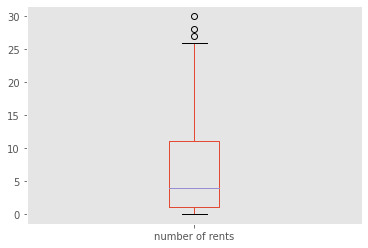

In [ ]:
neigh_with_rents.boxplot(column =['number of rents'], grid = False)

In [ ]:
import seaborn as sns

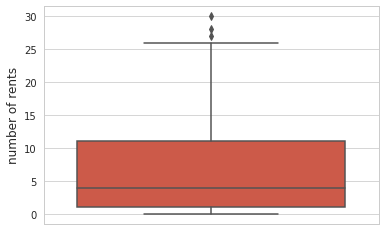

In [ ]:
sns.set_style("whitegrid")
  
sns.boxplot(y = 'number of rents', data = neigh_with_rents)

In [ ]:
non_outliers = neigh_with_rents[neigh_with_rents['number of rents'] < 25]
non_outliers.head()

,latitude,longitude,x,y,distance from center,rents,number of rents
0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12
1,55.678053,12.568542,5.296562e+06,1.815171e+06,285.714286,"[1714518, 2713104, 8437007, 10714307, 12116943...",20
2,55.674072,12.569276,5.295990e+06,1.815171e+06,285.714286,[0],0
3,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571,"[1005766, 2915555, 4193537, 10188373, 11836215...",10
4,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571,"[12807843, 32950026, 39465549]",3


In [ ]:
non_outliers.shape

(345, 7)

In [ ]:
neigh_with_rents.shape

(349, 7)

In [ ]:
neigh_with_rents.describe()

,latitude,longitude,x,y,distance from center,number of rents
count,349.000000,349.000000,3.490000e+02,3.490000e+02,349.000000,349.000000
mean,55.676062,12.568909,5.296276e+06,1.815171e+06,2006.906515,6.429799
std,0.010685,0.010496,1.507352e+03,1.507352e+03,710.612518,6.475757
min,55.655033,12.548256,5.293419e+06,1.812314e+06,0.000000,0.000000
25%,55.667475,12.560473,5.295133e+06,1.814028e+06,1456.862718,1.000000
50%,55.676062,12.568909,5.296276e+06,1.815171e+06,2080.031397,4.000000
75%,55.684652,12.577347,5.297419e+06,1.816314e+06,2634.155559,11.000000
max,55.697086,12.589564,5.299133e+06,1.818028e+06,2982.944717,30.000000


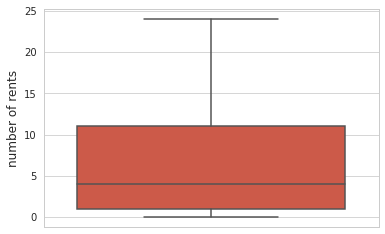

In [ ]:
sns.set_style("whitegrid")
  
sns.boxplot(y = 'number of rents', data = non_outliers)

In [ ]:
neigh_with_rents.to_csv('neigh_coords_with_rents.csv', index=False)

In [ ]:
# so the goal is the interquartile range, so neighbourhoods with rent number between 1 and 26. 
# limit the dataset

idea_num_rents = neigh_with_rents[(neigh_with_rents['number of rents'] >= 1) & (neigh_with_rents['number of rents'] <=11)]
idea_num_rents.head()

,latitude,longitude,x,y,distance from center,rents,number of rents
3,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571,"[1005766, 2915555, 4193537, 10188373, 11836215...",10
4,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571,"[12807843, 32950026, 39465549]",3
5,55.682033,12.567807,5.297133e+06,1.815171e+06,857.142857,"[7633989, 9003537, 44262680]",3
6,55.670091,12.570011,5.295419e+06,1.815171e+06,857.142857,"[30174695, 31020275, 42836619]",3
11,55.688004,12.566705,5.297990e+06,1.815171e+06,1714.285714,"[119322, 1806840, 7744999, 12301681, 42634248]",5


In [ ]:
idea_num_rents.shape

(203, 7)

In [ ]:
idea_num_rents.reset_index(inplace=True, drop = True)

In [ ]:
idea_num_rents.head()

,latitude,longitude,x,y,distance from center,rents,number of rents
0,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571,"[1005766, 2915555, 4193537, 10188373, 11836215...",10
1,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571,"[12807843, 32950026, 39465549]",3
2,55.682033,12.567807,5.297133e+06,1.815171e+06,857.142857,"[7633989, 9003537, 44262680]",3
3,55.670091,12.570011,5.295419e+06,1.815171e+06,857.142857,"[30174695, 31020275, 42836619]",3
4,55.688004,12.566705,5.297990e+06,1.815171e+06,1714.285714,"[119322, 1806840, 7744999, 12301681, 42634248]",5


In [ ]:
url = 'https://raw.githubusercontent.com/antalpatrik21/Coursera_Capstone/main/listings_detailed.csv'

In [ ]:
airbnb2_detailed = pd.read_csv(url)

In [ ]:
airbnb2_detailed.head()

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,6983,https://www.airbnb.com/rooms/6983,20210225053436,2021-02-25,Copenhagen 'N Livin',Lovely apartment located in the hip Nørrebro a...,"Nice bars and cozy cafes just minutes away, ye...",https://a0.muscache.com/pictures/42044170/f63c...,16774,https://www.airbnb.com/users/show/16774,...,10.0,9.0,9.0,NaN,f,1,0,1,0,1.20
1,26057,https://www.airbnb.com/rooms/26057,20210225053436,2021-02-26,Lovely house - most attractive area,Our lovely house in the center of the city is ...,The neighborhood is the most famous one and th...,https://a0.muscache.com/pictures/miso/Hosting-...,109777,https://www.airbnb.com/users/show/109777,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.57
2,29118,https://www.airbnb.com/rooms/29118,20210225053436,2021-02-26,Best Location in Cool Istedgade,<b>The space</b><br />The apartment is situate...,NaN,https://a0.muscache.com/pictures/236213/33956c...,125230,https://www.airbnb.com/users/show/125230,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.17
3,31094,https://www.airbnb.com/rooms/31094,20210225053436,2021-02-26,"Very central and cozy, new kitchen","<b>The space</b><br />Welcome to our home, we ...","What else is nearby?<br />To be honest, I thin...",https://a0.muscache.com/pictures/19408864/7c4c...,129976,https://www.airbnb.com/users/show/129976,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.13
4,32379,https://www.airbnb.com/rooms/32379,20210225053436,2021-02-27,120 m2 artist flat on Vesterbro,Bright Artistic luxury apartment in very trend...,"Værnedamsvej area is super hip area, we call i...",https://a0.muscache.com/pictures/4088872/c50ae...,140105,https://www.airbnb.com/users/show/140105,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.57


In [ ]:
airbnb2_detailed.shape

(8785, 74)

In [ ]:
airbnb2_detailed.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'description',
       'neighborhood_overview', 'picture_url', 'host_id', 'host_url',
       'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'calendar_upd

In [ ]:
merging_source = airbnb2_detailed[['id', 'last_scraped', 'host_name', 'host_since', 'host_location', 'host_about', 'host_is_superhost', 'host_has_profile_pic', 'host_identity_verified', 'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude', 'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms', 'bedrooms', 'beds', 'amenities', 'price', 'minimum_nights', 'first_review', 'last_review', 'number_of_reviews', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 'review_scores_location', 'calculated_host_listings_count']]

In [ ]:
merging_source.describe()

,id,neighbourhood_group_cleansed,latitude,longitude,accommodates,bathrooms,bedrooms,beds,minimum_nights,number_of_reviews,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,calculated_host_listings_count
count,8.785000e+03,0.0,8785.000000,8785.000000,8785.000000,0.0,8582.000000,8725.000000,8785.000000,8785.000000,7259.000000,7259.000000,7260.000000,7260.000000,7259.000000,8785.000000
mean,2.396404e+07,NaN,55.679729,12.560093,3.481161,NaN,1.692263,2.136275,4.203187,20.936710,9.741838,9.414933,9.840771,9.854132,9.715526,6.899146
std,1.478228e+07,NaN,0.018981,0.031733,1.807415,NaN,1.421539,1.548874,13.999261,37.075553,0.651873,0.913617,0.562639,0.564179,0.580709,28.919422
min,6.983000e+03,NaN,55.616420,12.454010,0.000000,NaN,1.000000,0.000000,1.000000,0.000000,2.000000,2.000000,2.000000,2.000000,2.000000,1.000000
25%,1.040420e+07,NaN,55.666480,12.543230,2.000000,NaN,1.000000,1.000000,2.000000,2.000000,10.000000,9.000000,10.000000,10.000000,10.000000,1.000000
50%,2.490314e+07,NaN,55.680190,12.558600,3.000000,NaN,1.000000,2.000000,2.000000,8.000000,10.000000,10.000000,10.000000,10.000000,10.000000,1.000000
75%,3.701247e+07,NaN,55.693790,12.581890,4.000000,NaN,2.000000,3.000000,4.000000,24.000000,10.000000,10.000000,10.000000,10.000000,10.000000,1.000000
max,4.831335e+07,NaN,55.732200,12.639800,16.000000,NaN,101.000000,25.000000,600.000000,640.000000,10.000000,10.000000,10.000000,10.000000,10.000000,192.000000


In [ ]:
neigh_with_rents.head()

,latitude,longitude,x,y,distance from center,rents,number of rents
0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12
1,55.678053,12.568542,5.296562e+06,1.815171e+06,285.714286,"[1714518, 2713104, 8437007, 10714307, 12116943...",20
2,55.674072,12.569276,5.295990e+06,1.815171e+06,285.714286,[0],0
3,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571,"[1005766, 2915555, 4193537, 10188373, 11836215...",10
4,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571,"[12807843, 32950026, 39465549]",3


In [ ]:
used_rents = neigh_with_rents['rents'].tolist()

In [ ]:
rents_id_list = []

for i in used_rents:
    for k in i:
        if k == 0:
            pass
        else:
            rents_id_list.append(k)
            

In [ ]:
len(rents_id_list)

2244

In [ ]:
# select the rents that are part of our analysis based on their id's

#airbnb_detailed_6k = airbnb2_detailed[airbnb2_detailed['id'].values in rents_id_list]

In [ ]:
airbnb_detailed_6k = pd.DataFrame(columns=airbnb2_detailed.columns)

In [ ]:
airbnb_detailed_6k

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month


In [ ]:
iterat = airbnb2_detailed.shape[0]

In [ ]:
for i in range(0, iterat):
    print('.', end = ' ')
    row = airbnb2_detailed.iloc[i]
    anid = row['id']
    logic = anid in rents_id_list
    if logic:
        airbnb_detailed_6k = airbnb_detailed_6k.append(row)
        


. . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . 

In [ ]:
airbnb_detailed_6k

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
1,26057,https://www.airbnb.com/rooms/26057,20210225053436,2021-02-26,Lovely house - most attractive area,Our lovely house in the center of the city is ...,The neighborhood is the most famous one and th...,https://a0.muscache.com/pictures/miso/Hosting-...,109777,https://www.airbnb.com/users/show/109777,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.57
2,29118,https://www.airbnb.com/rooms/29118,20210225053436,2021-02-26,Best Location in Cool Istedgade,<b>The space</b><br />The apartment is situate...,NaN,https://a0.muscache.com/pictures/236213/33956c...,125230,https://www.airbnb.com/users/show/125230,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.17
3,31094,https://www.airbnb.com/rooms/31094,20210225053436,2021-02-26,"Very central and cozy, new kitchen","<b>The space</b><br />Welcome to our home, we ...","What else is nearby?<br />To be honest, I thin...",https://a0.muscache.com/pictures/19408864/7c4c...,129976,https://www.airbnb.com/users/show/129976,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.13
4,32379,https://www.airbnb.com/rooms/32379,20210225053436,2021-02-27,120 m2 artist flat on Vesterbro,Bright Artistic luxury apartment in very trend...,"Værnedamsvej area is super hip area, we call i...",https://a0.muscache.com/pictures/4088872/c50ae...,140105,https://www.airbnb.com/users/show/140105,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.57
6,37159,https://www.airbnb.com/rooms/37159,20210225053436,2021-02-26,Unique space on greatest location,Situated in the arty Nansensgade quarters and...,"Our neighborhood is just the great and quit, b...",https://a0.muscache.com/pictures/936f0a23-4847...,160390,https://www.airbnb.com/users/show/160390,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8739,48098861,https://www.airbnb.com/rooms/48098861,20210225053436,2021-02-26,Central Furnished Studio+Bikes Netflix & Big Tv,Clean Studio with own Kitchen + Free Coffee & ...,Just the perfect location and you really have ...,https://a0.muscache.com/pictures/5ae776fa-afac...,370723090,https://www.airbnb.com/users/show/370723090,...,NaN,NaN,NaN,NaN,t,2,2,0,0,NaN
8745,48139393,https://www.airbnb.com/rooms/48139393,20210225053436,2021-02-26,Bo i luksus i Københavns svar på Marbella,NaN,NaN,https://a0.muscache.com/pictures/d8b93207-cd80...,388241413,https://www.airbnb.com/users/show/388241413,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
8767,48208848,https://www.airbnb.com/rooms/48208848,20210225053436,2021-02-27,Skøn og rummelig lejlighed med udsigt over kan...,Skøn gammel lejlighed lige ved hjertet af Købe...,NaN,https://a0.muscache.com/pictures/5fcb24da-9217...,388953393,https://www.airbnb.com/users/show/388953393,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
8780,48295173,https://www.airbnb.com/rooms/48295173,20210225053436,2021-02-26,Whole Apartment to yourself,NaN,NaN,https://a0.muscache.com/pictures/8644cf04-4cea...,312493112,https://www.airbnb.com/users/show/312493112,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN


In [ ]:
a = airbnb2_detailed.iloc[0]

In [ ]:
a['id']

6983

In [ ]:
airbnb_detailed_6k=airbnb_detailed_6k.append(a)

In [ ]:
airbnb_detailed_6k.reset_index(drop=True, inplace=True)

In [ ]:
airbnb_detailed_6k

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,26057,https://www.airbnb.com/rooms/26057,20210225053436,2021-02-26,Lovely house - most attractive area,Our lovely house in the center of the city is ...,The neighborhood is the most famous one and th...,https://a0.muscache.com/pictures/miso/Hosting-...,109777,https://www.airbnb.com/users/show/109777,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.57
1,29118,https://www.airbnb.com/rooms/29118,20210225053436,2021-02-26,Best Location in Cool Istedgade,<b>The space</b><br />The apartment is situate...,NaN,https://a0.muscache.com/pictures/236213/33956c...,125230,https://www.airbnb.com/users/show/125230,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.17
2,31094,https://www.airbnb.com/rooms/31094,20210225053436,2021-02-26,"Very central and cozy, new kitchen","<b>The space</b><br />Welcome to our home, we ...","What else is nearby?<br />To be honest, I thin...",https://a0.muscache.com/pictures/19408864/7c4c...,129976,https://www.airbnb.com/users/show/129976,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.13
3,32379,https://www.airbnb.com/rooms/32379,20210225053436,2021-02-27,120 m2 artist flat on Vesterbro,Bright Artistic luxury apartment in very trend...,"Værnedamsvej area is super hip area, we call i...",https://a0.muscache.com/pictures/4088872/c50ae...,140105,https://www.airbnb.com/users/show/140105,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.57
4,37159,https://www.airbnb.com/rooms/37159,20210225053436,2021-02-26,Unique space on greatest location,Situated in the arty Nansensgade quarters and...,"Our neighborhood is just the great and quit, b...",https://a0.muscache.com/pictures/936f0a23-4847...,160390,https://www.airbnb.com/users/show/160390,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,https://www.airbnb.com/rooms/48139393,20210225053436,2021-02-26,Bo i luksus i Københavns svar på Marbella,NaN,NaN,https://a0.muscache.com/pictures/d8b93207-cd80...,388241413,https://www.airbnb.com/users/show/388241413,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
2191,48208848,https://www.airbnb.com/rooms/48208848,20210225053436,2021-02-27,Skøn og rummelig lejlighed med udsigt over kan...,Skøn gammel lejlighed lige ved hjertet af Købe...,NaN,https://a0.muscache.com/pictures/5fcb24da-9217...,388953393,https://www.airbnb.com/users/show/388953393,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
2192,48295173,https://www.airbnb.com/rooms/48295173,20210225053436,2021-02-26,Whole Apartment to yourself,NaN,NaN,https://a0.muscache.com/pictures/8644cf04-4cea...,312493112,https://www.airbnb.com/users/show/312493112,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
2193,48313347,https://www.airbnb.com/rooms/48313347,20210225053436,2021-02-27,Penthouse Apartment by the Meet Packaging Dist...,Top floor penthouse apartment with a view acro...,NaN,https://a0.muscache.com/pictures/b97e2ee1-9bf0...,389948305,https://www.airbnb.com/users/show/389948305,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN


In [ ]:
airbnb_detailed_6k[airbnb_detailed_6k['id'] == 1891808]

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month


In [ ]:
in_df = airbnb_detailed_6k

In [ ]:
in_df_detailed = airbnb_detailed_6k

In [ ]:
data2 = airbnb_detailed_6k

In [ ]:
data2.to_csv('airbnb_6k_detailed.csv',index=False)

__Now we have the dataset__
# Now let's use the cleaning and visualization methods to further analize the data from the Inside Airbnb site. 
source: https://www.kaggle.com/mhmdpkts/predict-price-ann-data-cleaning-future-engineering


In [ ]:
#load fundamental libraary
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt #visualization
import seaborn as sns #visualization

import warnings
warnings.filterwarnings('ignore')

In [ ]:
#get significant features for according to me from this dataset and show 1 example
important_features = ["id","room_type","reviews_per_month","number_of_reviews","minimum_nights","calculated_host_listings_count","availability_365","longitude","latitude","price"]
in_df = in_df[important_features]
in_df.head(1)

,id,room_type,reviews_per_month,number_of_reviews,minimum_nights,calculated_host_listings_count,availability_365,longitude,latitude,price
0,26057,Entire home/apt,0.57,50,3,1,363,12.57459,55.69163,"$2,400.00"


In [ ]:
in_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2195 entries, 0 to 2194
Data columns (total 10 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              2195 non-null   object 
 1   room_type                       2195 non-null   object 
 2   reviews_per_month               1905 non-null   float64
 3   number_of_reviews               2195 non-null   object 
 4   minimum_nights                  2195 non-null   object 
 5   calculated_host_listings_count  2195 non-null   object 
 6   availability_365                2195 non-null   object 
 7   longitude                       2195 non-null   float64
 8   latitude                        2195 non-null   float64
 9   price                           2195 non-null   object 
dtypes: float64(3), object(7)
memory usage: 171.6+ KB


In [ ]:
# let's count the number of null values (NaN) in the dataset and then visualize it with seaborn 
in_df.isnull().sum()

id                                  0
room_type                           0
reviews_per_month                 290
number_of_reviews                   0
minimum_nights                      0
calculated_host_listings_count      0
availability_365                    0
longitude                           0
latitude                            0
price                               0
dtype: int64

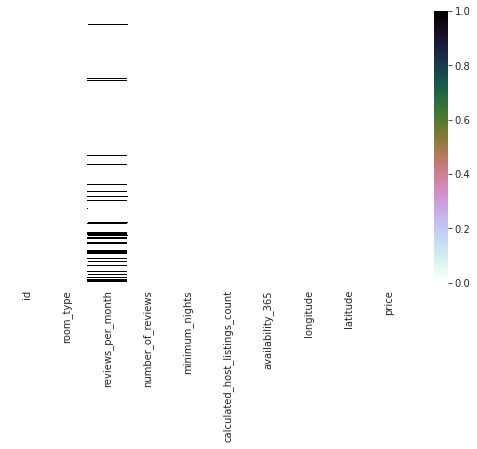

In [ ]:
#look at nulls
fig, ax = plt.subplots(figsize = (9, 5))
sns.heatmap(in_df.isnull(), cmap = "cubehelix_r", yticklabels='')
plt.show()

In the reviews_per_month column there are lots of Nan values. It gives us a better understanding than number_of_reviews as it gives us a time relation, but the number of missing values would make our predictions less accurate so I will delete this row. 

In [ ]:
del in_df["reviews_per_month"]

In [ ]:
in_df.head()

,id,room_type,number_of_reviews,minimum_nights,calculated_host_listings_count,availability_365,longitude,latitude,price
0,26057,Entire home/apt,50,3,1,363,12.57459,55.69163,"$2,400.00"
1,29118,Entire home/apt,22,7,1,177,12.55430,55.67069,$725.00
2,31094,Entire home/apt,17,2,1,301,12.55516,55.66744,$750.00
3,32379,Entire home/apt,73,3,1,54,12.55327,55.67297,$930.00
4,37159,Entire home/apt,11,5,1,349,12.56749,55.68572,"$2,317.00"


In [ ]:
in_df.isnull().sum()

id                                0
room_type                         0
number_of_reviews                 0
minimum_nights                    0
calculated_host_listings_count    0
availability_365                  0
longitude                         0
latitude                          0
price                             0
dtype: int64

 Now that we have no NaN value we can continue our analysis

Now we will create a more detailed summary table from the original for further exploration

In [ ]:
in_df_detailed.head()

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,26057,https://www.airbnb.com/rooms/26057,20210225053436,2021-02-26,Lovely house - most attractive area,Our lovely house in the center of the city is ...,The neighborhood is the most famous one and th...,https://a0.muscache.com/pictures/miso/Hosting-...,109777,https://www.airbnb.com/users/show/109777,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.57
1,29118,https://www.airbnb.com/rooms/29118,20210225053436,2021-02-26,Best Location in Cool Istedgade,<b>The space</b><br />The apartment is situate...,NaN,https://a0.muscache.com/pictures/236213/33956c...,125230,https://www.airbnb.com/users/show/125230,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.17
2,31094,https://www.airbnb.com/rooms/31094,20210225053436,2021-02-26,"Very central and cozy, new kitchen","<b>The space</b><br />Welcome to our home, we ...","What else is nearby?<br />To be honest, I thin...",https://a0.muscache.com/pictures/19408864/7c4c...,129976,https://www.airbnb.com/users/show/129976,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.13
3,32379,https://www.airbnb.com/rooms/32379,20210225053436,2021-02-27,120 m2 artist flat on Vesterbro,Bright Artistic luxury apartment in very trend...,"Værnedamsvej area is super hip area, we call i...",https://a0.muscache.com/pictures/4088872/c50ae...,140105,https://www.airbnb.com/users/show/140105,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.57
4,37159,https://www.airbnb.com/rooms/37159,20210225053436,2021-02-26,Unique space on greatest location,Situated in the arty Nansensgade quarters and...,"Our neighborhood is just the great and quit, b...",https://a0.muscache.com/pictures/936f0a23-4847...,160390,https://www.airbnb.com/users/show/160390,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.09


In [ ]:
in_df_detailed.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'description',
       'neighborhood_overview', 'picture_url', 'host_id', 'host_url',
       'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'calendar_upd

In [ ]:
nulls = (in_df_detailed.isnull().sum()).tolist()

In [ ]:
nulls

[0,
 0,
 0,
 0,
 0,
 44,
 901,
 0,
 0,
 0,
 0,
 0,
 5,
 862,
 882,
 882,
 783,
 0,
 0,
 0,
 704,
 0,
 0,
 0,
 0,
 0,
 901,
 0,
 2195,
 0,
 0,
 0,
 0,
 0,
 2195,
 6,
 45,
 18,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 2195,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 290,
 290,
 313,
 313,
 313,
 313,
 313,
 313,
 313,
 2195,
 0,
 0,
 0,
 0,
 0,
 290]

In [ ]:
# As we can see there are lots of missing values in more than one columns 

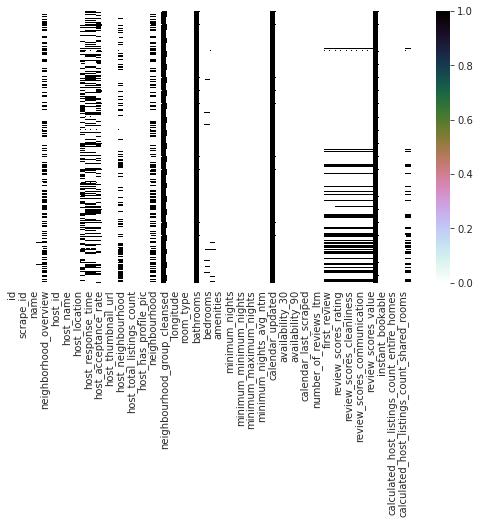

In [ ]:
# now let's visualize the distribution of the missing values
# isnull() function returns with the original dataframe but the values are True/Faulse according to the original value in place 
fig, ax = plt.subplots(figsize = (9, 5))
sns.heatmap(in_df_detailed.isnull(), cmap = "cubehelix_r", yticklabels='')
plt.show()

In [ ]:
in_df_detailed.columns.values

array(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name',
       'description', 'neighborhood_overview', 'picture_url', 'host_id',
       'host_url', 'host_name', 'host_since', 'host_location',
       'host_about', 'host_response_time', 'host_response_rate',
       'host_acceptance_rate', 'host_is_superhost', 'host_thumbnail_url',
       'host_picture_url', 'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed',
       'latitude', 'longitude', 'property_type', 'room_type',
       'accommodates', 'bathrooms', 'bathrooms_text', 'bedrooms', 'beds',
       'amenities', 'price', 'minimum_nights', 'maximum_nights',
       'minimum_minimum_nights', 'maximum_minimum_nights',
       'minimum_maximum_nights', 'maximum_maximum_nights',
       'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm',
       'calen

In [ ]:
in_df_detailed.shape

(2195, 74)

In [ ]:
# create a formula to calculate the reltive occurance of nan values in a coulumn 
round(in_df_detailed['host_location'].isna().sum()/(in_df_detailed.shape[0]),5)

0.00228

In [ ]:
# based on the relative occurance there set a limit 
# now let's ingnore features that contains more than 20% of missing data 

cols = in_df_detailed.columns.values
lenght = in_df_detailed.shape[0]
col_list = [] 
for i in cols:
    x = in_df_detailed[i]
    rate = round(x.isna().sum()/lenght,3)
    if rate < 0.20:
        col_list.append(i)
        print(i,"contain :%",100*rate ," ok :)")
    else:
        print(i,"contain :%",rate*100 ," fail !!")

id contain :% 0.0  ok :)
listing_url contain :% 0.0  ok :)
scrape_id contain :% 0.0  ok :)
last_scraped contain :% 0.0  ok :)
name contain :% 0.0  ok :)
description contain :% 2.0  ok :)
neighborhood_overview contain :% 41.0  fail !!
picture_url contain :% 0.0  ok :)
host_id contain :% 0.0  ok :)
host_url contain :% 0.0  ok :)
host_name contain :% 0.0  ok :)
host_since contain :% 0.0  ok :)
host_location contain :% 0.2  ok :)
host_about contain :% 39.300000000000004  fail !!
host_response_time contain :% 40.2  fail !!
host_response_rate contain :% 40.2  fail !!
host_acceptance_rate contain :% 35.699999999999996  fail !!
host_is_superhost contain :% 0.0  ok :)
host_thumbnail_url contain :% 0.0  ok :)
host_picture_url contain :% 0.0  ok :)
host_neighbourhood contain :% 32.1  fail !!
host_listings_count contain :% 0.0  ok :)
host_total_listings_count contain :% 0.0  ok :)
host_verifications contain :% 0.0  ok :)
host_has_profile_pic contain :% 0.0  ok :)
host_identity_verified contain :% 

In [ ]:
len(col_list)

63

As we can see from the original 74 columns we got only 63  which is good for the 20% limit. So we have lost 11 columns 

In [ ]:
#get important feature
get_features = ["id","amenities","availability_365","instant_bookable",
                "review_scores_rating",
               "bedrooms","beds","accommodates","host_total_listings_count","host_has_profile_pic",
               "host_identity_verified","property_type","host_is_superhost","room_type","maximum_nights","minimum_nights", "neighbourhood_cleansed", "latitude", "longitude", "price"]
in_df_detail = in_df_detailed[get_features]
in_df_detail

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,host_identity_verified,property_type,host_is_superhost,room_type,maximum_nights,minimum_nights,neighbourhood_cleansed,latitude,longitude,price
0,26057,"[""Washer"", ""Kitchen"", ""Crib"", ""Dryer"", ""Refrig...",363,f,98.0,4.0,4.0,6,1.0,t,t,Entire house,f,Entire home/apt,30,3,Indre By,55.69163,12.57459,"$2,400.00"
1,29118,"[""Children\u2019s dinnerware"", ""Children\u2019...",177,f,98.0,1.0,1.0,2,1.0,t,t,Entire apartment,f,Entire home/apt,14,7,Vesterbro-Kongens Enghave,55.67069,12.55430,$725.00
2,31094,"[""Kitchen"", ""Cable TV"", ""Wifi"", ""Heating"", ""TV""]",301,f,97.0,1.0,3.0,3,1.0,t,t,Entire apartment,f,Entire home/apt,10,2,Vesterbro-Kongens Enghave,55.66744,12.55516,$750.00
3,32379,"[""Children\u2019s books and toys"", ""Washer"", ""...",54,f,98.0,1.0,2.0,3,3.0,t,t,Entire apartment,f,Entire home/apt,365,3,Vesterbro-Kongens Enghave,55.67297,12.55327,$930.00
4,37159,"[""Washer"", ""Essentials"", ""Dedicated workspace""...",349,f,100.0,2.0,3.0,4,1.0,t,t,Entire apartment,f,Entire home/apt,21,5,Indre By,55.68572,12.56749,"$2,317.00"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,"[""Hot water"", ""Washer"", ""Essentials"", ""Kitchen...",27,f,NaN,1.0,4.0,4,0.0,t,t,Entire apartment,f,Entire home/apt,7,1,Vesterbro-Kongens Enghave,55.65959,12.56375,"$1,800.00"
2191,48208848,"[""Private entrance"", ""Washer"", ""Essentials"", ""...",77,f,NaN,2.0,6.0,6,0.0,t,t,Entire apartment,f,Entire home/apt,45,7,Amager Vest,55.66813,12.58069,$750.00
2192,48295173,"[""Washer"", ""Essentials"", ""Kitchen"", ""Long term...",55,f,NaN,1.0,3.0,3,2.0,t,t,Entire apartment,f,Entire home/apt,1125,1,Nrrebro,55.69197,12.55946,$649.00
2193,48313347,"[""Washer"", ""Essentials"", ""Dedicated workspace""...",0,f,NaN,2.0,2.0,4,0.0,t,f,Entire apartment,f,Entire home/apt,1125,3,Vesterbro-Kongens Enghave,55.67045,12.56428,$520.00


In [ ]:
# Now we have detailed information of 5870 id's in 17 columns that have maximum 20% of missing values

In [ ]:
len(in_df_detail['id'].unique())

2195

In [ ]:
#there is a duplication as the id should be unique
in_df_detail = in_df_detail.drop_duplicates(subset=['id'])

In [ ]:
in_df_detail.reset_index(drop=True, inplace=True)

In [ ]:
in_df_detail

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,host_identity_verified,property_type,host_is_superhost,room_type,maximum_nights,minimum_nights,neighbourhood_cleansed,latitude,longitude,price
0,26057,"[""Washer"", ""Kitchen"", ""Crib"", ""Dryer"", ""Refrig...",363,f,98.0,4.0,4.0,6,1.0,t,t,Entire house,f,Entire home/apt,30,3,Indre By,55.69163,12.57459,"$2,400.00"
1,29118,"[""Children\u2019s dinnerware"", ""Children\u2019...",177,f,98.0,1.0,1.0,2,1.0,t,t,Entire apartment,f,Entire home/apt,14,7,Vesterbro-Kongens Enghave,55.67069,12.55430,$725.00
2,31094,"[""Kitchen"", ""Cable TV"", ""Wifi"", ""Heating"", ""TV""]",301,f,97.0,1.0,3.0,3,1.0,t,t,Entire apartment,f,Entire home/apt,10,2,Vesterbro-Kongens Enghave,55.66744,12.55516,$750.00
3,32379,"[""Children\u2019s books and toys"", ""Washer"", ""...",54,f,98.0,1.0,2.0,3,3.0,t,t,Entire apartment,f,Entire home/apt,365,3,Vesterbro-Kongens Enghave,55.67297,12.55327,$930.00
4,37159,"[""Washer"", ""Essentials"", ""Dedicated workspace""...",349,f,100.0,2.0,3.0,4,1.0,t,t,Entire apartment,f,Entire home/apt,21,5,Indre By,55.68572,12.56749,"$2,317.00"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,"[""Hot water"", ""Washer"", ""Essentials"", ""Kitchen...",27,f,NaN,1.0,4.0,4,0.0,t,t,Entire apartment,f,Entire home/apt,7,1,Vesterbro-Kongens Enghave,55.65959,12.56375,"$1,800.00"
2191,48208848,"[""Private entrance"", ""Washer"", ""Essentials"", ""...",77,f,NaN,2.0,6.0,6,0.0,t,t,Entire apartment,f,Entire home/apt,45,7,Amager Vest,55.66813,12.58069,$750.00
2192,48295173,"[""Washer"", ""Essentials"", ""Kitchen"", ""Long term...",55,f,NaN,1.0,3.0,3,2.0,t,t,Entire apartment,f,Entire home/apt,1125,1,Nrrebro,55.69197,12.55946,$649.00
2193,48313347,"[""Washer"", ""Essentials"", ""Dedicated workspace""...",0,f,NaN,2.0,2.0,4,0.0,t,f,Entire apartment,f,Entire home/apt,1125,3,Vesterbro-Kongens Enghave,55.67045,12.56428,$520.00


In [ ]:
cent_lat = cop_center[0]
cent_long = cop_center[1]

Now there each id is unique

In [ ]:
from geopy.distance import great_circle

In [ ]:
# From the previous calculations with cartesian coordinates we have only results that are within 6km from the center of Copenhagen.
# Now let's calculate distance from lar and long valued and check the results

#create distance feature from latitude and longtitude 

def distance_from_copenhagen(lat, lon):
    copenhagen_centre = (cop_center[0], cop_center[1]) # make a tuple from a lsit 
    record = (lat, lon)
    return (great_circle(copenhagen_centre, record).km)*1000

#add distanse dataset
in_df_detail['distance(m)'] = in_df_detail.apply(lambda x: distance_from_copenhagen(x.latitude, x.longitude), axis=1)


in_df_detail.head(1)


,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,property_type,host_is_superhost,room_type,maximum_nights,minimum_nights,neighbourhood_cleansed,latitude,longitude,price,distance(m)
0,26057,"[""Washer"", ""Kitchen"", ""Crib"", ""Dryer"", ""Refrig...",363,f,98.0,4.0,4.0,6,1.0,t,...,Entire house,f,Entire home/apt,30,3,Indre By,55.69163,12.57459,"$2,400.00",1767.311295


In [ ]:
in_df_detail[in_df_detail['distance(m)']< 3000]

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,property_type,host_is_superhost,room_type,maximum_nights,minimum_nights,neighbourhood_cleansed,latitude,longitude,price,distance(m)
0,26057,"[""Washer"", ""Kitchen"", ""Crib"", ""Dryer"", ""Refrig...",363,f,98.0,4.0,4.0,6,1.0,t,...,Entire house,f,Entire home/apt,30,3,Indre By,55.69163,12.57459,"$2,400.00",1767.311295
1,29118,"[""Children\u2019s dinnerware"", ""Children\u2019...",177,f,98.0,1.0,1.0,2,1.0,t,...,Entire apartment,f,Entire home/apt,14,7,Vesterbro-Kongens Enghave,55.67069,12.55430,$725.00,1093.605026
2,31094,"[""Kitchen"", ""Cable TV"", ""Wifi"", ""Heating"", ""TV""]",301,f,97.0,1.0,3.0,3,1.0,t,...,Entire apartment,f,Entire home/apt,10,2,Vesterbro-Kongens Enghave,55.66744,12.55516,$750.00,1289.380861
3,32379,"[""Children\u2019s books and toys"", ""Washer"", ""...",54,f,98.0,1.0,2.0,3,3.0,t,...,Entire apartment,f,Entire home/apt,365,3,Vesterbro-Kongens Enghave,55.67297,12.55327,$930.00,1039.130215
4,37159,"[""Washer"", ""Essentials"", ""Dedicated workspace""...",349,f,100.0,2.0,3.0,4,1.0,t,...,Entire apartment,f,Entire home/apt,21,5,Indre By,55.68572,12.56749,"$2,317.00",1077.572194
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,"[""Hot water"", ""Washer"", ""Essentials"", ""Kitchen...",27,f,NaN,1.0,4.0,4,0.0,t,...,Entire apartment,f,Entire home/apt,7,1,Vesterbro-Kongens Enghave,55.65959,12.56375,"$1,800.00",1859.987070
2191,48208848,"[""Private entrance"", ""Washer"", ""Essentials"", ""...",77,f,NaN,2.0,6.0,6,0.0,t,...,Entire apartment,f,Entire home/apt,45,7,Amager Vest,55.66813,12.58069,$750.00,1150.529203
2192,48295173,"[""Washer"", ""Essentials"", ""Kitchen"", ""Long term...",55,f,NaN,1.0,3.0,3,2.0,t,...,Entire apartment,f,Entire home/apt,1125,1,Nrrebro,55.69197,12.55946,$649.00,1865.402129
2193,48313347,"[""Washer"", ""Essentials"", ""Dedicated workspace""...",0,f,NaN,2.0,2.0,4,0.0,t,...,Entire apartment,f,Entire home/apt,1125,3,Vesterbro-Kongens Enghave,55.67045,12.56428,$520.00,688.251631


In [ ]:
from statistics import mean
mean(in_df_detail['distance(m)'].tolist())

1185.594938366401

The average distance from the center is closer to the center that could mean, that there are more rents closer to the center. 

In [ ]:
#nominal_categorical
print(in_df_detail.room_type.unique())


['Entire home/apt' 'Private room' 'Hotel room' 'Shared room']


In [ ]:
x = in_df_detail[["room_type"]] #create a dataframe from roomtype 
print(x[:5])
print(type(x))
print(x.info())

         room_type
0  Entire home/apt
1  Entire home/apt
2  Entire home/apt
3  Entire home/apt
4  Entire home/apt
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2195 entries, 0 to 2194
Data columns (total 1 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   room_type  2195 non-null   object
dtypes: object(1)
memory usage: 17.3+ KB
None


Now we set the values for categorical, which set limitation of the possible values. 
According to Pandas reference:
All values of the Categorical are either in __categories or np.nan__. Assigning values outside of categories will raise a ValueError. Order is defined by the order of the categories, not lexical order of the values.

In [ ]:
x.room_type = pd.Categorical(x['room_type'])

In [ ]:
print(x)
print(x.dtypes)

            room_type
0     Entire home/apt
1     Entire home/apt
2     Entire home/apt
3     Entire home/apt
4     Entire home/apt
...               ...
2190  Entire home/apt
2191  Entire home/apt
2192  Entire home/apt
2193  Entire home/apt
2194     Private room

[2195 rows x 1 columns]
room_type    category
dtype: object


In [ ]:
del in_df_detail['room_type']

In [ ]:
# convert the cathergorical variable into seperate columns with the 0/1 according to the room_type
dummies_room_type = pd.get_dummies(x, prefix = 'room_type')
# with concat we can combine dataframes together
in_df_detail = pd.concat([in_df_detail,dummies_room_type], axis=1)
in_df_detail.head(3)

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,minimum_nights,neighbourhood_cleansed,latitude,longitude,price,distance(m),room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
0,26057,"[""Washer"", ""Kitchen"", ""Crib"", ""Dryer"", ""Refrig...",363,f,98.0,4.0,4.0,6,1.0,t,...,3,Indre By,55.69163,12.57459,"$2,400.00",1767.311295,1,0,0,0
1,29118,"[""Children\u2019s dinnerware"", ""Children\u2019...",177,f,98.0,1.0,1.0,2,1.0,t,...,7,Vesterbro-Kongens Enghave,55.67069,12.55430,$725.00,1093.605026,1,0,0,0
2,31094,"[""Kitchen"", ""Cable TV"", ""Wifi"", ""Heating"", ""TV""]",301,f,97.0,1.0,3.0,3,1.0,t,...,2,Vesterbro-Kongens Enghave,55.66744,12.55516,$750.00,1289.380861,1,0,0,0


In [ ]:
dummies_room_type

,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
0,1,0,0,0
1,1,0,0,0
2,1,0,0,0
3,1,0,0,0
4,1,0,0,0
...,...,...,...,...
2190,1,0,0,0
2191,1,0,0,0
2192,1,0,0,0
2193,1,0,0,0


In [ ]:
# clarify the shortened data as well 

In [ ]:
len(in_df['id'].unique())

2195

In [ ]:
in_df = in_df.drop_duplicates(subset=['id'])
in_df.reset_index(inplace = True, drop = True)

In [ ]:
in_df_mod  =  in_df.copy()

In [ ]:
in_df_mod

,id,room_type,number_of_reviews,minimum_nights,calculated_host_listings_count,availability_365,longitude,latitude,price
0,26057,Entire home/apt,50,3,1,363,12.57459,55.69163,"$2,400.00"
1,29118,Entire home/apt,22,7,1,177,12.55430,55.67069,$725.00
2,31094,Entire home/apt,17,2,1,301,12.55516,55.66744,$750.00
3,32379,Entire home/apt,73,3,1,54,12.55327,55.67297,$930.00
4,37159,Entire home/apt,11,5,1,349,12.56749,55.68572,"$2,317.00"
...,...,...,...,...,...,...,...,...,...
2190,48139393,Entire home/apt,0,1,1,27,12.56375,55.65959,"$1,800.00"
2191,48208848,Entire home/apt,0,7,1,77,12.58069,55.66813,$750.00
2192,48295173,Entire home/apt,0,1,1,55,12.55946,55.69197,$649.00
2193,48313347,Entire home/apt,0,3,1,0,12.56428,55.67045,$520.00


In [ ]:
# Now go back to the original dataset 
in_df_detail

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,minimum_nights,neighbourhood_cleansed,latitude,longitude,price,distance(m),room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
0,26057,"[""Washer"", ""Kitchen"", ""Crib"", ""Dryer"", ""Refrig...",363,f,98.0,4.0,4.0,6,1.0,t,...,3,Indre By,55.69163,12.57459,"$2,400.00",1767.311295,1,0,0,0
1,29118,"[""Children\u2019s dinnerware"", ""Children\u2019...",177,f,98.0,1.0,1.0,2,1.0,t,...,7,Vesterbro-Kongens Enghave,55.67069,12.55430,$725.00,1093.605026,1,0,0,0
2,31094,"[""Kitchen"", ""Cable TV"", ""Wifi"", ""Heating"", ""TV""]",301,f,97.0,1.0,3.0,3,1.0,t,...,2,Vesterbro-Kongens Enghave,55.66744,12.55516,$750.00,1289.380861,1,0,0,0
3,32379,"[""Children\u2019s books and toys"", ""Washer"", ""...",54,f,98.0,1.0,2.0,3,3.0,t,...,3,Vesterbro-Kongens Enghave,55.67297,12.55327,$930.00,1039.130215,1,0,0,0
4,37159,"[""Washer"", ""Essentials"", ""Dedicated workspace""...",349,f,100.0,2.0,3.0,4,1.0,t,...,5,Indre By,55.68572,12.56749,"$2,317.00",1077.572194,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,"[""Hot water"", ""Washer"", ""Essentials"", ""Kitchen...",27,f,NaN,1.0,4.0,4,0.0,t,...,1,Vesterbro-Kongens Enghave,55.65959,12.56375,"$1,800.00",1859.987070,1,0,0,0
2191,48208848,"[""Private entrance"", ""Washer"", ""Essentials"", ""...",77,f,NaN,2.0,6.0,6,0.0,t,...,7,Amager Vest,55.66813,12.58069,$750.00,1150.529203,1,0,0,0
2192,48295173,"[""Washer"", ""Essentials"", ""Kitchen"", ""Long term...",55,f,NaN,1.0,3.0,3,2.0,t,...,1,Nrrebro,55.69197,12.55946,$649.00,1865.402129,1,0,0,0
2193,48313347,"[""Washer"", ""Essentials"", ""Dedicated workspace""...",0,f,NaN,2.0,2.0,4,0.0,t,...,3,Vesterbro-Kongens Enghave,55.67045,12.56428,$520.00,688.251631,1,0,0,0


In [ ]:
# let1S MAKE A COPY FOR FURTHER MODIFICATIONS 

in_df_det_mod = in_df_detail.copy()
in_df_det_mod.head(3)

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,minimum_nights,neighbourhood_cleansed,latitude,longitude,price,distance(m),room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
0,26057,"[""Washer"", ""Kitchen"", ""Crib"", ""Dryer"", ""Refrig...",363,f,98.0,4.0,4.0,6,1.0,t,...,3,Indre By,55.69163,12.57459,"$2,400.00",1767.311295,1,0,0,0
1,29118,"[""Children\u2019s dinnerware"", ""Children\u2019...",177,f,98.0,1.0,1.0,2,1.0,t,...,7,Vesterbro-Kongens Enghave,55.67069,12.55430,$725.00,1093.605026,1,0,0,0
2,31094,"[""Kitchen"", ""Cable TV"", ""Wifi"", ""Heating"", ""TV""]",301,f,97.0,1.0,3.0,3,1.0,t,...,2,Vesterbro-Kongens Enghave,55.66744,12.55516,$750.00,1289.380861,1,0,0,0


In [ ]:
in_df_det_mod.columns.values

array(['id', 'amenities', 'availability_365', 'instant_bookable',
       'review_scores_rating', 'bedrooms', 'beds', 'accommodates',
       'host_total_listings_count', 'host_has_profile_pic',
       'host_identity_verified', 'property_type', 'host_is_superhost',
       'maximum_nights', 'minimum_nights', 'neighbourhood_cleansed',
       'latitude', 'longitude', 'price', 'distance(m)',
       'room_type_Entire home/apt', 'room_type_Hotel room',
       'room_type_Private room', 'room_type_Shared room'], dtype=object)

In [ ]:
# create a function that can convert the string type logic values to numeric variables 

def string2bool(p):
    if p == "t" or p == "T":
        return 1.0
    elif p == "f" or p == "F":
        return 0.0
    else:
        return None 


In [ ]:
in_df_det_mod

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,minimum_nights,neighbourhood_cleansed,latitude,longitude,price,distance(m),room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
0,26057,"[""Washer"", ""Kitchen"", ""Crib"", ""Dryer"", ""Refrig...",363,f,98.0,4.0,4.0,6,1.0,t,...,3,Indre By,55.69163,12.57459,"$2,400.00",1767.311295,1,0,0,0
1,29118,"[""Children\u2019s dinnerware"", ""Children\u2019...",177,f,98.0,1.0,1.0,2,1.0,t,...,7,Vesterbro-Kongens Enghave,55.67069,12.55430,$725.00,1093.605026,1,0,0,0
2,31094,"[""Kitchen"", ""Cable TV"", ""Wifi"", ""Heating"", ""TV""]",301,f,97.0,1.0,3.0,3,1.0,t,...,2,Vesterbro-Kongens Enghave,55.66744,12.55516,$750.00,1289.380861,1,0,0,0
3,32379,"[""Children\u2019s books and toys"", ""Washer"", ""...",54,f,98.0,1.0,2.0,3,3.0,t,...,3,Vesterbro-Kongens Enghave,55.67297,12.55327,$930.00,1039.130215,1,0,0,0
4,37159,"[""Washer"", ""Essentials"", ""Dedicated workspace""...",349,f,100.0,2.0,3.0,4,1.0,t,...,5,Indre By,55.68572,12.56749,"$2,317.00",1077.572194,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,"[""Hot water"", ""Washer"", ""Essentials"", ""Kitchen...",27,f,NaN,1.0,4.0,4,0.0,t,...,1,Vesterbro-Kongens Enghave,55.65959,12.56375,"$1,800.00",1859.987070,1,0,0,0
2191,48208848,"[""Private entrance"", ""Washer"", ""Essentials"", ""...",77,f,NaN,2.0,6.0,6,0.0,t,...,7,Amager Vest,55.66813,12.58069,$750.00,1150.529203,1,0,0,0
2192,48295173,"[""Washer"", ""Essentials"", ""Kitchen"", ""Long term...",55,f,NaN,1.0,3.0,3,2.0,t,...,1,Nrrebro,55.69197,12.55946,$649.00,1865.402129,1,0,0,0
2193,48313347,"[""Washer"", ""Essentials"", ""Dedicated workspace""...",0,f,NaN,2.0,2.0,4,0.0,t,...,3,Vesterbro-Kongens Enghave,55.67045,12.56428,$520.00,688.251631,1,0,0,0


In [ ]:
in_df_det_mod[['host_is_superhost']]

,host_is_superhost
0,f
1,f
2,f
3,f
4,f
...,...
2190,f
2191,f
2192,f
2193,f


In [ ]:
# make a list holding the column names that are boolean

boolean_columns = ['host_is_superhost','host_has_profile_pic',
                    'host_identity_verified','instant_bookable']

# go through alll the mentioned columns and apply the function on their values 
#use the map function
'''
A map function is used to substitute each element in a Pandas Series for a value derieved from a function or dictionary/Series. 
'''
for i in boolean_columns:
    in_df_det_mod[i] = in_df_det_mod[i].map(string2bool) # apply the function to all element of the choosen column


In [ ]:
in_df_det_mod.head()

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,minimum_nights,neighbourhood_cleansed,latitude,longitude,price,distance(m),room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
0,26057,"[""Washer"", ""Kitchen"", ""Crib"", ""Dryer"", ""Refrig...",363,0.0,98.0,4.0,4.0,6,1.0,1.0,...,3,Indre By,55.69163,12.57459,"$2,400.00",1767.311295,1,0,0,0
1,29118,"[""Children\u2019s dinnerware"", ""Children\u2019...",177,0.0,98.0,1.0,1.0,2,1.0,1.0,...,7,Vesterbro-Kongens Enghave,55.67069,12.55430,$725.00,1093.605026,1,0,0,0
2,31094,"[""Kitchen"", ""Cable TV"", ""Wifi"", ""Heating"", ""TV""]",301,0.0,97.0,1.0,3.0,3,1.0,1.0,...,2,Vesterbro-Kongens Enghave,55.66744,12.55516,$750.00,1289.380861,1,0,0,0
3,32379,"[""Children\u2019s books and toys"", ""Washer"", ""...",54,0.0,98.0,1.0,2.0,3,3.0,1.0,...,3,Vesterbro-Kongens Enghave,55.67297,12.55327,$930.00,1039.130215,1,0,0,0
4,37159,"[""Washer"", ""Essentials"", ""Dedicated workspace""...",349,0.0,100.0,2.0,3.0,4,1.0,1.0,...,5,Indre By,55.68572,12.56749,"$2,317.00",1077.572194,1,0,0,0


In [ ]:
# create an amenities counter function that can be applied in columns:

def amenities_counter(x):
    return len(x.split(","))



In [ ]:
# than apply this function on the selected column:

in_df_det_mod.amenities = in_df_det_mod.amenities.map(amenities_counter)
in_df_det_mod.head(3)

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,minimum_nights,neighbourhood_cleansed,latitude,longitude,price,distance(m),room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
0,26057,30,363,0.0,98.0,4.0,4.0,6,1.0,1.0,...,3,Indre By,55.69163,12.57459,"$2,400.00",1767.311295,1,0,0,0
1,29118,28,177,0.0,98.0,1.0,1.0,2,1.0,1.0,...,7,Vesterbro-Kongens Enghave,55.67069,12.55430,$725.00,1093.605026,1,0,0,0
2,31094,5,301,0.0,97.0,1.0,3.0,3,1.0,1.0,...,2,Vesterbro-Kongens Enghave,55.66744,12.55516,$750.00,1289.380861,1,0,0,0


In [ ]:
in_df_det_mod.columns.values

array(['id', 'amenities', 'availability_365', 'instant_bookable',
       'review_scores_rating', 'bedrooms', 'beds', 'accommodates',
       'host_total_listings_count', 'host_has_profile_pic',
       'host_identity_verified', 'property_type', 'host_is_superhost',
       'maximum_nights', 'minimum_nights', 'neighbourhood_cleansed',
       'latitude', 'longitude', 'price', 'distance(m)',
       'room_type_Entire home/apt', 'room_type_Hotel room',
       'room_type_Private room', 'room_type_Shared room'], dtype=object)

In [ ]:
# now clean $ sign

def clean_price(x):
    y = x.replace(",", "")  # this is for removing the , that makes the number more easibly readable 
    return float(y.replace("$",""))

in_df_det_mod.price = in_df_det_mod.price.map(clean_price)
in_df_det_mod.head(3)

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,minimum_nights,neighbourhood_cleansed,latitude,longitude,price,distance(m),room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
0,26057,30,363,0.0,98.0,4.0,4.0,6,1.0,1.0,...,3,Indre By,55.69163,12.57459,2400.0,1767.311295,1,0,0,0
1,29118,28,177,0.0,98.0,1.0,1.0,2,1.0,1.0,...,7,Vesterbro-Kongens Enghave,55.67069,12.55430,725.0,1093.605026,1,0,0,0
2,31094,5,301,0.0,97.0,1.0,3.0,3,1.0,1.0,...,2,Vesterbro-Kongens Enghave,55.66744,12.55516,750.0,1289.380861,1,0,0,0


In [ ]:
in_df_det_mod.isnull().sum()

id                             0
amenities                      0
availability_365               0
instant_bookable               0
review_scores_rating         313
bedrooms                      45
beds                          18
accommodates                   0
host_total_listings_count      0
host_has_profile_pic           0
host_identity_verified         0
property_type                  0
host_is_superhost              0
maximum_nights                 0
minimum_nights                 0
neighbourhood_cleansed         0
latitude                       0
longitude                      0
price                          0
distance(m)                    0
room_type_Entire home/apt      0
room_type_Hotel room           0
room_type_Private room         0
room_type_Shared room          0
dtype: int64

In [ ]:
#get features that contain nulls -- this gives us more clue on what is going on in the background
null_cols = []
nulls_inthe_columns = []
for i in in_df_det_mod.columns.values:
    x = in_df_det_mod[i].isna().sum() 
    if x >0 :
        null_cols.append(i)
        nulls_inthe_columns.append(x)

print("Features that contain nulls: \t",null_cols)
print("Number of features with missing values are {} in the cleaned dataset.".format(nulls_inthe_columns))

Features that contain nulls: 	 ['review_scores_rating', 'bedrooms', 'beds']
Number of features with missing values are [313, 45, 18] in the cleaned dataset.


In [ ]:
# we have 3 columns that have missig values in it. Both of them contain numeric variables 
# we won't delete any relevant information from the dataset instead we will fill the missing values with the meadian of the given column 

for i in null_cols:
    median = in_df_det_mod[i].median()
    in_df_det_mod[i] = in_df_det_mod[i].fillna(median) ## we can find the NaN values and replace with the given argument with fillna(argument)


In [ ]:
# now run the isnull function to check if the function worked as it is supposed to:

in_df_det_mod.isnull().sum()

id                           0
amenities                    0
availability_365             0
instant_bookable             0
review_scores_rating         0
bedrooms                     0
beds                         0
accommodates                 0
host_total_listings_count    0
host_has_profile_pic         0
host_identity_verified       0
property_type                0
host_is_superhost            0
maximum_nights               0
minimum_nights               0
neighbourhood_cleansed       0
latitude                     0
longitude                    0
price                        0
distance(m)                  0
room_type_Entire home/apt    0
room_type_Hotel room         0
room_type_Private room       0
room_type_Shared room        0
dtype: int64

In [ ]:
#Great! 
# now check what are the values that are included in one of our cleaned dataframe but not in the other: 

x  = in_df_det_mod.columns.values
y = in_df_mod.columns.values

print("In the more detailed column there are these columns: \n\n")
print(x, '\n')
print("In the less detailed column there are these columns: \n\n")
print(y, '\n')

In the more detailed column there are these columns: 


['id' 'amenities' 'availability_365' 'instant_bookable'
 'review_scores_rating' 'bedrooms' 'beds' 'accommodates'
 'host_total_listings_count' 'host_has_profile_pic'
 'host_identity_verified' 'property_type' 'host_is_superhost'
 'maximum_nights' 'minimum_nights' 'neighbourhood_cleansed' 'latitude'
 'longitude' 'price' 'distance(m)' 'room_type_Entire home/apt'
 'room_type_Hotel room' 'room_type_Private room' 'room_type_Shared room'] 

In the less detailed column there are these columns: 


['id' 'room_type' 'number_of_reviews' 'minimum_nights'
 'calculated_host_listings_count' 'availability_365' 'longitude'
 'latitude' 'price'] 



In [ ]:
features_in_x = len(x)
print(features_in_x)

24


In [ ]:
original_attributes_x = []
original_attributes_y = []
common_attributes = []

for o in x:
    if o in y:
        common_attributes.append(o)
    else:
        original_attributes_x.append(o)

for i in y: 
    if i not in x:
        original_attributes_y.append(i)

print(original_attributes_x)
print(original_attributes_y)
print(common_attributes)
        

['amenities', 'instant_bookable', 'review_scores_rating', 'bedrooms', 'beds', 'accommodates', 'host_total_listings_count', 'host_has_profile_pic', 'host_identity_verified', 'property_type', 'host_is_superhost', 'maximum_nights', 'neighbourhood_cleansed', 'distance(m)', 'room_type_Entire home/apt', 'room_type_Hotel room', 'room_type_Private room', 'room_type_Shared room']
['room_type', 'number_of_reviews', 'calculated_host_listings_count']
['id', 'availability_365', 'minimum_nights', 'latitude', 'longitude', 'price']


In [ ]:
x  = in_df_det_mod.columns.values
y = in_df_mod.columns.values

print("In the more detailed column there are these columns: \n\n")
print(x, '\n')
print("In the less detailed column there are these columns: \n\n")
print(y, '\n')

In the more detailed column there are these columns: 


['id' 'amenities' 'availability_365' 'instant_bookable'
 'review_scores_rating' 'bedrooms' 'beds' 'accommodates'
 'host_total_listings_count' 'host_has_profile_pic'
 'host_identity_verified' 'property_type' 'host_is_superhost'
 'maximum_nights' 'minimum_nights' 'neighbourhood_cleansed' 'latitude'
 'longitude' 'price' 'distance(m)' 'room_type_Entire home/apt'
 'room_type_Hotel room' 'room_type_Private room' 'room_type_Shared room'] 

In the less detailed column there are these columns: 


['id' 'room_type' 'number_of_reviews' 'minimum_nights'
 'calculated_host_listings_count' 'availability_365' 'longitude'
 'latitude' 'price'] 



In [ ]:
# the common colummns are cleared in the detailed dataframe so lets use this for the table where the other table is added 

# the 3 extra culomns need to be added to our table based on the id column in an inner join 

#concat
add = in_df_mod[original_attributes_y]
type(add)

pandas.core.frame.DataFrame

In [ ]:
data = pd.concat([in_df_det_mod, add],axis=1)
data.shape

(2195, 27)

In [ ]:
data.number_of_reviews

0        50
1        22
2        17
3        73
4        11
       ... 
2190      0
2191      0
2192      0
2193      0
2194    168
Name: number_of_reviews, Length: 2195, dtype: object

In [ ]:
data

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,longitude,price,distance(m),room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,room_type,number_of_reviews,calculated_host_listings_count
0,26057,30,363,0.0,98.0,4.0,4.0,6,1.0,1.0,...,12.57459,2400.0,1767.311295,1,0,0,0,Entire home/apt,50,1
1,29118,28,177,0.0,98.0,1.0,1.0,2,1.0,1.0,...,12.55430,725.0,1093.605026,1,0,0,0,Entire home/apt,22,1
2,31094,5,301,0.0,97.0,1.0,3.0,3,1.0,1.0,...,12.55516,750.0,1289.380861,1,0,0,0,Entire home/apt,17,1
3,32379,35,54,0.0,98.0,1.0,2.0,3,3.0,1.0,...,12.55327,930.0,1039.130215,1,0,0,0,Entire home/apt,73,1
4,37159,12,349,0.0,100.0,2.0,3.0,4,1.0,1.0,...,12.56749,2317.0,1077.572194,1,0,0,0,Entire home/apt,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,11,27,0.0,97.0,1.0,4.0,4,0.0,1.0,...,12.56375,1800.0,1859.987070,1,0,0,0,Entire home/apt,0,1
2191,48208848,13,77,0.0,97.0,2.0,6.0,6,0.0,1.0,...,12.58069,750.0,1150.529203,1,0,0,0,Entire home/apt,0,1
2192,48295173,8,55,0.0,97.0,1.0,3.0,3,2.0,1.0,...,12.55946,649.0,1865.402129,1,0,0,0,Entire home/apt,0,1
2193,48313347,10,0,0.0,97.0,2.0,2.0,4,0.0,1.0,...,12.56428,520.0,688.251631,1,0,0,0,Entire home/apt,0,1


In [ ]:
original_attributes_y.append('id')
add2 = in_df_mod[original_attributes_y]

In [ ]:
data_try = in_df_det_mod.merge(add2, how='inner', on='id')

In [ ]:
data_try

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,longitude,price,distance(m),room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,room_type,number_of_reviews,calculated_host_listings_count
0,26057,30,363,0.0,98.0,4.0,4.0,6,1.0,1.0,...,12.57459,2400.0,1767.311295,1,0,0,0,Entire home/apt,50,1
1,29118,28,177,0.0,98.0,1.0,1.0,2,1.0,1.0,...,12.55430,725.0,1093.605026,1,0,0,0,Entire home/apt,22,1
2,31094,5,301,0.0,97.0,1.0,3.0,3,1.0,1.0,...,12.55516,750.0,1289.380861,1,0,0,0,Entire home/apt,17,1
3,32379,35,54,0.0,98.0,1.0,2.0,3,3.0,1.0,...,12.55327,930.0,1039.130215,1,0,0,0,Entire home/apt,73,1
4,37159,12,349,0.0,100.0,2.0,3.0,4,1.0,1.0,...,12.56749,2317.0,1077.572194,1,0,0,0,Entire home/apt,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,11,27,0.0,97.0,1.0,4.0,4,0.0,1.0,...,12.56375,1800.0,1859.987070,1,0,0,0,Entire home/apt,0,1
2191,48208848,13,77,0.0,97.0,2.0,6.0,6,0.0,1.0,...,12.58069,750.0,1150.529203,1,0,0,0,Entire home/apt,0,1
2192,48295173,8,55,0.0,97.0,1.0,3.0,3,2.0,1.0,...,12.55946,649.0,1865.402129,1,0,0,0,Entire home/apt,0,1
2193,48313347,10,0,0.0,97.0,2.0,2.0,4,0.0,1.0,...,12.56428,520.0,688.251631,1,0,0,0,Entire home/apt,0,1


In [ ]:
data.equals(data_try)

True

In [ ]:
# we can use either one of them 
#let's use the data for further analysis


In [ ]:
data.head()

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,longitude,price,distance(m),room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,room_type,number_of_reviews,calculated_host_listings_count
0,26057,30,363,0.0,98.0,4.0,4.0,6,1.0,1.0,...,12.57459,2400.0,1767.311295,1,0,0,0,Entire home/apt,50,1
1,29118,28,177,0.0,98.0,1.0,1.0,2,1.0,1.0,...,12.55430,725.0,1093.605026,1,0,0,0,Entire home/apt,22,1
2,31094,5,301,0.0,97.0,1.0,3.0,3,1.0,1.0,...,12.55516,750.0,1289.380861,1,0,0,0,Entire home/apt,17,1
3,32379,35,54,0.0,98.0,1.0,2.0,3,3.0,1.0,...,12.55327,930.0,1039.130215,1,0,0,0,Entire home/apt,73,1
4,37159,12,349,0.0,100.0,2.0,3.0,4,1.0,1.0,...,12.56749,2317.0,1077.572194,1,0,0,0,Entire home/apt,11,1


In [ ]:
# get rid of the ouliers using the Z-score

#write a function to filter the outliers - outlier detection with z score
def detect_outlier(data_1):
    feature_outliers=[]
    threshold=7
    mean_1 = np.mean(data_1)
    std_1 =np.std(data_1)
    
    counter=0
    for y in data_1:
        z_score= (y - mean_1)/std_1 
        if np.abs(z_score) > threshold:
            feature_outliers.append(counter)
        counter += 1
    return feature_outliers


In [ ]:
data.columns

Index(['id', 'amenities', 'availability_365', 'instant_bookable',
       'review_scores_rating', 'bedrooms', 'beds', 'accommodates',
       'host_total_listings_count', 'host_has_profile_pic',
       'host_identity_verified', 'property_type', 'host_is_superhost',
       'maximum_nights', 'minimum_nights', 'neighbourhood_cleansed',
       'latitude', 'longitude', 'price', 'distance(m)',
       'room_type_Entire home/apt', 'room_type_Hotel room',
       'room_type_Private room', 'room_type_Shared room', 'room_type',
       'number_of_reviews', 'calculated_host_listings_count'],
      dtype='object')

In [ ]:
data['property_type']

0                    Entire house
1                Entire apartment
2                Entire apartment
3                Entire apartment
4                Entire apartment
                  ...            
2190             Entire apartment
2191             Entire apartment
2192             Entire apartment
2193             Entire apartment
2194    Private room in apartment
Name: property_type, Length: 2195, dtype: object

In [ ]:
# seems like we forgot to convert the property values to dummies
x = data[["property_type"]] #create a dataframe from roomtype 
print(x[:5])
print(type(x))
print(x.info())

      property_type
0      Entire house
1  Entire apartment
2  Entire apartment
3  Entire apartment
4  Entire apartment
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2195 entries, 0 to 2194
Data columns (total 1 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   property_type  2195 non-null   object
dtypes: object(1)
memory usage: 17.3+ KB
None


In [ ]:
x.room_type = pd.Categorical(x['property_type'])

In [ ]:
del data['property_type']

In [ ]:
# convert the cathergorical variable into seperate columns with the 0/1 according to the room_type

dummies_property_type = pd.get_dummies(x, prefix = 'room_type')
dummies_property_type


,room_type_Boat,room_type_Entire apartment,room_type_Entire condominium,room_type_Entire guest suite,room_type_Entire house,room_type_Entire loft,room_type_Entire serviced apartment,room_type_Entire townhouse,room_type_Houseboat,room_type_Private room,...,room_type_Private room in serviced apartment,room_type_Private room in tiny house,room_type_Private room in townhouse,room_type_Private room in villa,room_type_Room in boutique hotel,room_type_Room in hostel,room_type_Room in hotel,room_type_Room in serviced apartment,room_type_Shared room in hostel,room_type_Tiny house
0,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2191,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2192,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2193,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# with concat we can combine dataframes together

data = pd.concat([data,dummies_property_type], axis=1)
data.head(3)

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,room_type_Private room in serviced apartment,room_type_Private room in tiny house,room_type_Private room in townhouse,room_type_Private room in villa,room_type_Room in boutique hotel,room_type_Room in hostel,room_type_Room in hotel,room_type_Room in serviced apartment,room_type_Shared room in hostel,room_type_Tiny house
0,26057,30,363,0.0,98.0,4.0,4.0,6,1.0,1.0,...,0,0,0,0,0,0,0,0,0,0
1,29118,28,177,0.0,98.0,1.0,1.0,2,1.0,1.0,...,0,0,0,0,0,0,0,0,0,0
2,31094,5,301,0.0,97.0,1.0,3.0,3,1.0,1.0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# as we left a string variable in the dataset we need to drop this column (the data is saved in the dummy varieables before)

data.drop(['room_type'], axis = 1, inplace=True)

In [ ]:
x = data.columns.tolist()

y = x.remove('neighbourhood_cleansed')
print(x.index('room_type_Private room'))
y = x.remove('room_type_Private room') 
y = x.remove('room_type_Private room') 

print(y)

print(x)

20
None
['id', 'amenities', 'availability_365', 'instant_bookable', 'review_scores_rating', 'bedrooms', 'beds', 'accommodates', 'host_total_listings_count', 'host_has_profile_pic', 'host_identity_verified', 'host_is_superhost', 'maximum_nights', 'minimum_nights', 'latitude', 'longitude', 'price', 'distance(m)', 'room_type_Entire home/apt', 'room_type_Hotel room', 'room_type_Shared room', 'number_of_reviews', 'calculated_host_listings_count', 'room_type_Boat', 'room_type_Entire apartment', 'room_type_Entire condominium', 'room_type_Entire guest suite', 'room_type_Entire house', 'room_type_Entire loft', 'room_type_Entire serviced apartment', 'room_type_Entire townhouse', 'room_type_Houseboat', 'room_type_Private room in apartment', 'room_type_Private room in bed and breakfast', 'room_type_Private room in condominium', 'room_type_Private room in guest suite', 'room_type_Private room in hostel', 'room_type_Private room in house', 'room_type_Private room in loft', 'room_type_Private room in

In [ ]:
outliers = np.array([]) # for holding the outliers 
print("--Feature and Outlier Counts--\n")
for i in x:   # i wll be one column name
    f_out = detect_outlier(data[i]) # we will send a Pandas Series in  the function --> f_out is a list 
    outliers = np.concatenate((outliers,np.asarray(f_out))) # convert the list to an array and than add it to the existing array in a new row --> the default axis value is 0 which means it will be added in a new row not a column 
    print(i ," outlier count :",len(f_out))  # print out the number of outliers in the columns 
    
outliers = np.unique(outliers,0)
print("Total Unique Outlier Index Count:",len(outliers))

--Feature and Outlier Counts--

id  outlier count : 0
amenities  outlier count : 0
availability_365  outlier count : 0
instant_bookable  outlier count : 0
review_scores_rating  outlier count : 3
bedrooms  outlier count : 0
beds  outlier count : 0
accommodates  outlier count : 0
host_total_listings_count  outlier count : 0
host_has_profile_pic  outlier count : 3
host_identity_verified  outlier count : 0
host_is_superhost  outlier count : 0
maximum_nights  outlier count : 0
minimum_nights  outlier count : 10
latitude  outlier count : 0
longitude  outlier count : 0
price  outlier count : 4
distance(m)  outlier count : 0
room_type_Entire home/apt  outlier count : 0
room_type_Hotel room  outlier count : 17
room_type_Shared room  outlier count : 4
number_of_reviews  outlier count : 6
calculated_host_listings_count  outlier count : 0
room_type_Boat  outlier count : 2
room_type_Entire apartment  outlier count : 0
room_type_Entire condominium  outlier count : 0
room_type_Entire guest suite  out

In [ ]:
clean_data = data.drop(outliers,axis=0)
clean_data.describe()

,amenities,instant_bookable,review_scores_rating,bedrooms,beds,host_total_listings_count,host_has_profile_pic,host_identity_verified,host_is_superhost,latitude,...,room_type_Private room in serviced apartment,room_type_Private room in tiny house,room_type_Private room in townhouse,room_type_Private room in villa,room_type_Room in boutique hotel,room_type_Room in hostel,room_type_Room in hotel,room_type_Room in serviced apartment,room_type_Shared room in hostel,room_type_Tiny house
count,2003.000000,2003.000000,2003.000000,2003.000000,2003.000000,2003.000000,2003.0,2003.000000,2003.000000,2003.000000,...,2003.0,2003.0,2003.0,2003.0,2003.0,2003.0,2003.0,2003.0,2003.0,2003.0
mean,19.644533,0.226660,95.619571,1.648028,2.103844,15.533200,1.0,0.766850,0.181228,55.678339,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,8.428192,0.418775,5.136309,0.858890,1.394724,59.543621,0.0,0.422943,0.385303,0.009127,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,1.000000,0.000000,60.000000,1.000000,0.000000,0.000000,1.0,0.000000,0.000000,55.655160,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,13.000000,0.000000,94.000000,1.000000,1.000000,1.000000,1.0,1.000000,0.000000,55.670780,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,19.000000,0.000000,97.000000,1.000000,2.000000,1.000000,1.0,1.000000,0.000000,55.679010,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,26.000000,0.000000,99.000000,2.000000,3.000000,2.000000,1.0,1.000000,0.000000,55.685380,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,55.000000,1.000000,100.000000,7.000000,9.000000,294.000000,1.0,1.000000,1.000000,55.696990,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
clean_data['room_type_Private room']

,room_type_Private room,room_type_Private room
1,0,0
2,0,0
3,0,0
4,0,0
5,0,0
...,...,...
2190,0,0
2191,0,0
2192,0,0
2193,0,0


In [ ]:
x = clean_data.columns.tolist()
for k, i in enumerate(x):
    if i == 'room_type_Private room':
        print(k)
    

21
34


In [ ]:
clean_data['room_type_Private room']

,room_type_Private room,room_type_Private room
1,0,0
2,0,0
3,0,0
4,0,0
5,0,0
...,...,...
2190,0,0
2191,0,0
2192,0,0
2193,0,0


In [ ]:
x = clean_data['room_type_Private room']

In [ ]:
type(x)

pandas.core.frame.DataFrame

In [ ]:
y = x.iloc[:,0]

In [ ]:
y

1       0
2       0
3       0
4       0
5       0
       ..
2190    0
2191    0
2192    0
2193    0
2194    1
Name: room_type_Private room, Length: 2003, dtype: uint8

In [ ]:
type(y)

pandas.core.series.Series

In [ ]:
y = y.to_frame()

In [ ]:
y

,room_type_Private room
1,0
2,0
3,0
4,0
5,0
...,...
2190,0
2191,0
2192,0
2193,0


In [ ]:
clean_data.drop('room_type_Private room', inplace=True, axis=1)

In [ ]:
clean_data = pd.concat([clean_data, y],axis=1)

In [ ]:
clean_data[['room_type_Private room']]

,room_type_Private room
1,0
2,0
3,0
4,0
5,0
...,...
2190,0
2191,0
2192,0
2193,0


In [ ]:
# now we only have one room_type_Private room row in our dataset

In [ ]:
clean_data.describe()

,amenities,instant_bookable,review_scores_rating,bedrooms,beds,host_total_listings_count,host_has_profile_pic,host_identity_verified,host_is_superhost,latitude,...,room_type_Private room in tiny house,room_type_Private room in townhouse,room_type_Private room in villa,room_type_Room in boutique hotel,room_type_Room in hostel,room_type_Room in hotel,room_type_Room in serviced apartment,room_type_Shared room in hostel,room_type_Tiny house,room_type_Private room
count,2003.000000,2003.000000,2003.000000,2003.000000,2003.000000,2003.000000,2003.0,2003.000000,2003.000000,2003.000000,...,2003.0,2003.0,2003.0,2003.0,2003.0,2003.0,2003.0,2003.0,2003.0,2003.000000
mean,19.644533,0.226660,95.619571,1.648028,2.103844,15.533200,1.0,0.766850,0.181228,55.678339,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.110834
std,8.428192,0.418775,5.136309,0.858890,1.394724,59.543621,0.0,0.422943,0.385303,0.009127,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.314005
min,1.000000,0.000000,60.000000,1.000000,0.000000,0.000000,1.0,0.000000,0.000000,55.655160,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
25%,13.000000,0.000000,94.000000,1.000000,1.000000,1.000000,1.0,1.000000,0.000000,55.670780,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
50%,19.000000,0.000000,97.000000,1.000000,2.000000,1.000000,1.0,1.000000,0.000000,55.679010,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
75%,26.000000,0.000000,99.000000,2.000000,3.000000,2.000000,1.0,1.000000,0.000000,55.685380,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
max,55.000000,1.000000,100.000000,7.000000,9.000000,294.000000,1.0,1.000000,1.000000,55.696990,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000


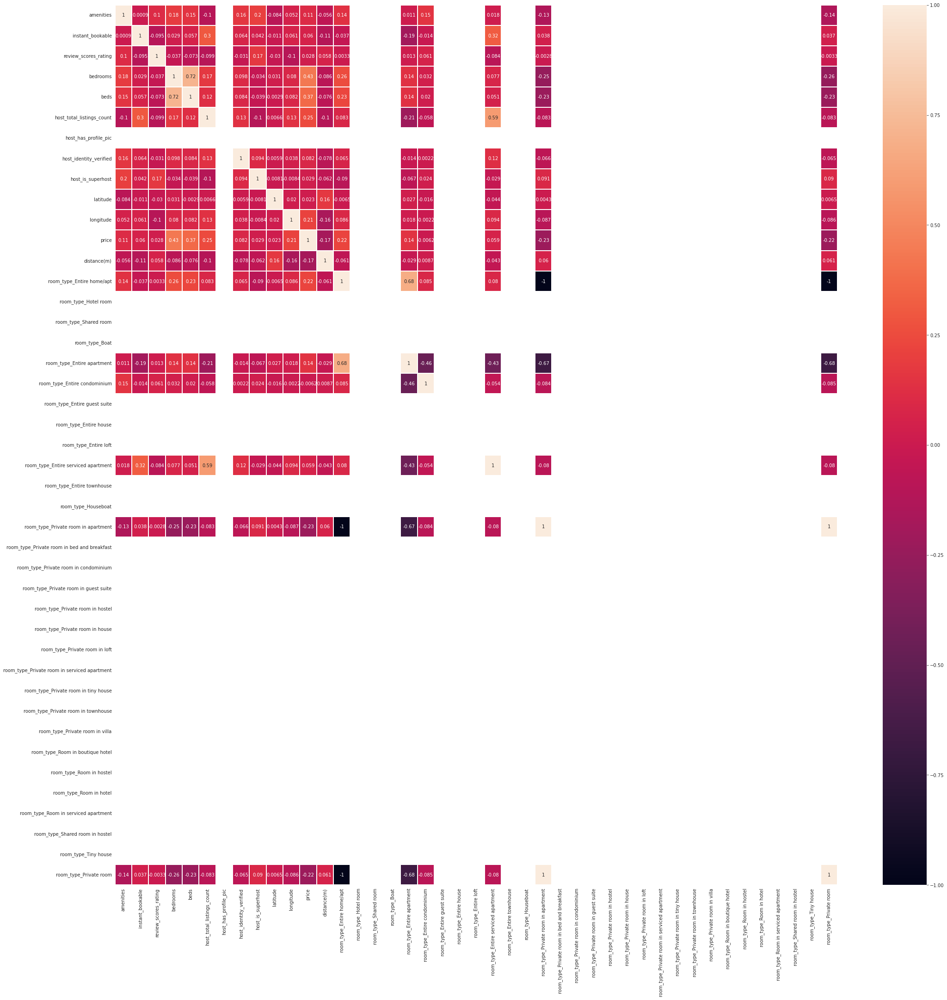

In [ ]:
# go ahead and analyze the correlation between the variables 

f, ax = plt.subplots( figsize=(35,35) )
sns.heatmap(clean_data.corr(),annot=True,linewidths=1)
plt.show()

## MODELING


In [ ]:
ana_col = clean_data.columns.tolist()
ana_col.remove('neighbourhood_cleansed')
ana_col

['id',
 'amenities',
 'availability_365',
 'instant_bookable',
 'review_scores_rating',
 'bedrooms',
 'beds',
 'accommodates',
 'host_total_listings_count',
 'host_has_profile_pic',
 'host_identity_verified',
 'host_is_superhost',
 'maximum_nights',
 'minimum_nights',
 'latitude',
 'longitude',
 'price',
 'distance(m)',
 'room_type_Entire home/apt',
 'room_type_Hotel room',
 'room_type_Shared room',
 'number_of_reviews',
 'calculated_host_listings_count',
 'room_type_Boat',
 'room_type_Entire apartment',
 'room_type_Entire condominium',
 'room_type_Entire guest suite',
 'room_type_Entire house',
 'room_type_Entire loft',
 'room_type_Entire serviced apartment',
 'room_type_Entire townhouse',
 'room_type_Houseboat',
 'room_type_Private room in apartment',
 'room_type_Private room in bed and breakfast',
 'room_type_Private room in condominium',
 'room_type_Private room in guest suite',
 'room_type_Private room in hostel',
 'room_type_Private room in house',
 'room_type_Private room in lof

In [ ]:
model_data = clean_data[ana_col]
model_data.head()

,id,amenities,availability_365,instant_bookable,review_scores_rating,bedrooms,beds,accommodates,host_total_listings_count,host_has_profile_pic,...,room_type_Private room in tiny house,room_type_Private room in townhouse,room_type_Private room in villa,room_type_Room in boutique hotel,room_type_Room in hostel,room_type_Room in hotel,room_type_Room in serviced apartment,room_type_Shared room in hostel,room_type_Tiny house,room_type_Private room
1,29118,28,177,0.0,98.0,1.0,1.0,2,1.0,1.0,...,0,0,0,0,0,0,0,0,0,0
2,31094,5,301,0.0,97.0,1.0,3.0,3,1.0,1.0,...,0,0,0,0,0,0,0,0,0,0
3,32379,35,54,0.0,98.0,1.0,2.0,3,3.0,1.0,...,0,0,0,0,0,0,0,0,0,0
4,37159,12,349,0.0,100.0,2.0,3.0,4,1.0,1.0,...,0,0,0,0,0,0,0,0,0,0
5,78381,30,364,0.0,97.0,1.0,2.0,3,1.0,1.0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
#split data test and train
from sklearn.model_selection import train_test_split

X = model_data.drop(["price"],axis=1)
y = model_data["price"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.10,random_state=42)

In [ ]:
# normalize data
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range=(0, 1))
X_train = sc.fit_transform(X_train)
X_test  = sc.transform(X_test)

In [ ]:
'''
!pip install keras
'''

'\n!pip install keras\n'

In [ ]:
import tensorflow 


In [ ]:

import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.metrics import mean_squared_error
from tensorflow.keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint

#set parameters
batch_size = 32
epochs = 25

model = Sequential()
model.add(Dense(512,input_shape=(X_train.shape[1],), activation= 'relu'))
model.add(Dropout(0.2))
model.add(Dense(256, activation= 'relu'))
model.add(Dropout(0.2))
model.add(Dense(128, activation= 'relu'))
model.add(Dense(1, activation= 'relu'))

filepath="weights-improvement-{epoch:02d}-{val_loss:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

model.compile(loss = mean_squared_error,
              optimizer = Adam(),
              metrics=['mean_squared_error'])

hist = model.fit(X_train, y_train, batch_size=batch_size, epochs=epochs, verbose=1, validation_data=(X_test, y_test),callbacks=callbacks_list)


Epoch 1/25
50/57 [=========================>....] - ETA: 0s - loss: 2040005.2500 - mean_squared_error: 2040005.2500
Epoch 1: val_loss improved from inf to 441184.03125, saving model to weights-improvement-01-441184.03.hdf5
57/57 [==============================] - 1s 9ms/step - loss: 1905973.2500 - mean_squared_error: 1905973.2500 - val_loss: 441184.0312 - val_mean_squared_error: 441184.0312
Epoch 2/25
50/57 [=========================>....] - ETA: 0s - loss: 962722.6250 - mean_squared_error: 962722.6250  
Epoch 2: val_loss improved from 441184.03125 to 303872.06250, saving model to weights-improvement-02-303872.06.hdf5
57/57 [==============================] - 0s 6ms/step - loss: 900874.2500 - mean_squared_error: 900874.2500 - val_loss: 303872.0625 - val_mean_squared_error: 303872.0625
Epoch 3/25
48/57 [========================>.....] - ETA: 0s - loss: 889354.0000 - mean_squared_error: 889354.0000
Epoch 3: val_loss improved from 303872.06250 to 281943.03125, saving model to weights-impro

In [ ]:
'''
#plot training history
figsize=(10,5)
ax,_ = plt.subplots(figsize=figsize)
plt.plot(hist.history['loss'])
plt.plot(hist.history['val_loss'])
plt.title('modelloss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','test'],loc='upperleft')
plt.show()
'''

"\n#plot training history\nfigsize=(10,5)\nax,_ = plt.subplots(figsize=figsize)\nplt.plot(hist.history['loss'])\nplt.plot(hist.history['val_loss'])\nplt.title('modelloss')\nplt.ylabel('loss')\nplt.xlabel('epoch')\nplt.legend(['train','test'],loc='upperleft')\nplt.show()\n"

In [ ]:
ls

airbnb_6k_detailed.csv                  weights-improvement-07-240179.30.hdf5
disk_grid_fibonacci.png                 weights-improvement-07-888164.44.hdf5
disk_grid_fibonacci.xy                  weights-improvement-08-233866.92.hdf5
figures/                                weights-improvement-08-873732.44.hdf5
functions/                              weights-improvement-09-868685.19.hdf5
neigh_coords_with_rents.csv             weights-improvement-10-859004.06.hdf5
okok.png                                weights-improvement-11-845093.94.hdf5
ok.png                                  weights-improvement-12-843791.75.hdf5
Project_main.ipynb                      weights-improvement-13-229891.08.hdf5
weights-improvement-01-1126394.00.hdf5  weights-improvement-13-839993.06.hdf5
weights-improvement-01-441184.03.hdf5   weights-improvement-14-229293.94.hdf5
weights-improvement-02-1063381.38.hdf5  weights-improvement-14-839497.50.hdf5
weights-improvement-02-303872.06.hdf5   weights-improvement-15-8

In [ ]:
'''
import os
import copy

saved_loss_file = None
loss_min = 100000
# r=root, d=directories, f = files
for r, d, f in os.walk('./'):
    for file in f:
        if '.hdf5' in file:
            filename = os.path.join(r, file)
            loss = int(filename.split('-')[3].split('.')[0])
            if loss < loss_min:
                loss_min = loss
                saved_loss_file = filename
                
print("Saved min loss : ",loss_min,"\nFile :",saved_loss_file)
'''

'\nimport os\nimport copy\n\nsaved_loss_file = None\nloss_min = 100000\n# r=root, d=directories, f = files\nfor r, d, f in os.walk(\'./\'):\n    for file in f:\n        if \'.hdf5\' in file:\n            filename = os.path.join(r, file)\n            loss = int(filename.split(\'-\')[3].split(\'.\')[0])\n            if loss < loss_min:\n                loss_min = loss\n                saved_loss_file = filename\n                \nprint("Saved min loss : ",loss_min,"\nFile :",saved_loss_file)\n'

In [ ]:
'''
#load model
from keras.models import load_model
best_model = load_model(saved_loss_file)
'''

'\n#load model\nfrom keras.models import load_model\nbest_model = load_model(saved_loss_file)\n'

In [ ]:
'''
#prediction
pred_mlp = best_model.predict(X_test)
'''

'\n#prediction\npred_mlp = best_model.predict(X_test)\n'

In [ ]:
'''
#evaluate
print('\n# Model Evaluate')
results = best_model.evaluate(X_test, y_test)
print('Test Mse Loss:', results[0])

RMSE = np.sqrt(results[0])
print("RMSE:",RMSE)
'''

'\n#evaluate\nprint(\'\n# Model Evaluate\')\nresults = best_model.evaluate(X_test, y_test)\nprint(\'Test Mse Loss:\', results[0])\n\nRMSE = np.sqrt(results[0])\nprint("RMSE:",RMSE)\n'

# NEW DATA PROCESSING


https://www.kaggle.com/chirag9073/airbnb-analysis-visualization-and-prediction

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [ ]:
airbnb = data2.copy(deep=True)

In [ ]:
airbnb.head()

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,26057,https://www.airbnb.com/rooms/26057,20210225053436,2021-02-26,Lovely house - most attractive area,Our lovely house in the center of the city is ...,The neighborhood is the most famous one and th...,https://a0.muscache.com/pictures/miso/Hosting-...,109777,https://www.airbnb.com/users/show/109777,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.57
1,29118,https://www.airbnb.com/rooms/29118,20210225053436,2021-02-26,Best Location in Cool Istedgade,<b>The space</b><br />The apartment is situate...,NaN,https://a0.muscache.com/pictures/236213/33956c...,125230,https://www.airbnb.com/users/show/125230,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.17
2,31094,https://www.airbnb.com/rooms/31094,20210225053436,2021-02-26,"Very central and cozy, new kitchen","<b>The space</b><br />Welcome to our home, we ...","What else is nearby?<br />To be honest, I thin...",https://a0.muscache.com/pictures/19408864/7c4c...,129976,https://www.airbnb.com/users/show/129976,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.13
3,32379,https://www.airbnb.com/rooms/32379,20210225053436,2021-02-27,120 m2 artist flat on Vesterbro,Bright Artistic luxury apartment in very trend...,"Værnedamsvej area is super hip area, we call i...",https://a0.muscache.com/pictures/4088872/c50ae...,140105,https://www.airbnb.com/users/show/140105,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.57
4,37159,https://www.airbnb.com/rooms/37159,20210225053436,2021-02-26,Unique space on greatest location,Situated in the arty Nansensgade quarters and...,"Our neighborhood is just the great and quit, b...",https://a0.muscache.com/pictures/936f0a23-4847...,160390,https://www.airbnb.com/users/show/160390,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.09


In [ ]:
airbnb.shape

(2195, 74)

# We came back after the price analysis with the knowledge of what popularity and score means. 
_____________________

# Let's continue our analysis with the data and calculate the popularity scores 

In [ ]:
data2

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,26057,https://www.airbnb.com/rooms/26057,20210225053436,2021-02-26,Lovely house - most attractive area,Our lovely house in the center of the city is ...,The neighborhood is the most famous one and th...,https://a0.muscache.com/pictures/miso/Hosting-...,109777,https://www.airbnb.com/users/show/109777,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.57
1,29118,https://www.airbnb.com/rooms/29118,20210225053436,2021-02-26,Best Location in Cool Istedgade,<b>The space</b><br />The apartment is situate...,NaN,https://a0.muscache.com/pictures/236213/33956c...,125230,https://www.airbnb.com/users/show/125230,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.17
2,31094,https://www.airbnb.com/rooms/31094,20210225053436,2021-02-26,"Very central and cozy, new kitchen","<b>The space</b><br />Welcome to our home, we ...","What else is nearby?<br />To be honest, I thin...",https://a0.muscache.com/pictures/19408864/7c4c...,129976,https://www.airbnb.com/users/show/129976,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.13
3,32379,https://www.airbnb.com/rooms/32379,20210225053436,2021-02-27,120 m2 artist flat on Vesterbro,Bright Artistic luxury apartment in very trend...,"Værnedamsvej area is super hip area, we call i...",https://a0.muscache.com/pictures/4088872/c50ae...,140105,https://www.airbnb.com/users/show/140105,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.57
4,37159,https://www.airbnb.com/rooms/37159,20210225053436,2021-02-26,Unique space on greatest location,Situated in the arty Nansensgade quarters and...,"Our neighborhood is just the great and quit, b...",https://a0.muscache.com/pictures/936f0a23-4847...,160390,https://www.airbnb.com/users/show/160390,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,https://www.airbnb.com/rooms/48139393,20210225053436,2021-02-26,Bo i luksus i Københavns svar på Marbella,NaN,NaN,https://a0.muscache.com/pictures/d8b93207-cd80...,388241413,https://www.airbnb.com/users/show/388241413,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
2191,48208848,https://www.airbnb.com/rooms/48208848,20210225053436,2021-02-27,Skøn og rummelig lejlighed med udsigt over kan...,Skøn gammel lejlighed lige ved hjertet af Købe...,NaN,https://a0.muscache.com/pictures/5fcb24da-9217...,388953393,https://www.airbnb.com/users/show/388953393,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
2192,48295173,https://www.airbnb.com/rooms/48295173,20210225053436,2021-02-26,Whole Apartment to yourself,NaN,NaN,https://a0.muscache.com/pictures/8644cf04-4cea...,312493112,https://www.airbnb.com/users/show/312493112,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
2193,48313347,https://www.airbnb.com/rooms/48313347,20210225053436,2021-02-27,Penthouse Apartment by the Meet Packaging Dist...,Top floor penthouse apartment with a view acro...,NaN,https://a0.muscache.com/pictures/b97e2ee1-9bf0...,389948305,https://www.airbnb.com/users/show/389948305,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN


In [ ]:
data2

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,26057,https://www.airbnb.com/rooms/26057,20210225053436,2021-02-26,Lovely house - most attractive area,Our lovely house in the center of the city is ...,The neighborhood is the most famous one and th...,https://a0.muscache.com/pictures/miso/Hosting-...,109777,https://www.airbnb.com/users/show/109777,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.57
1,29118,https://www.airbnb.com/rooms/29118,20210225053436,2021-02-26,Best Location in Cool Istedgade,<b>The space</b><br />The apartment is situate...,NaN,https://a0.muscache.com/pictures/236213/33956c...,125230,https://www.airbnb.com/users/show/125230,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.17
2,31094,https://www.airbnb.com/rooms/31094,20210225053436,2021-02-26,"Very central and cozy, new kitchen","<b>The space</b><br />Welcome to our home, we ...","What else is nearby?<br />To be honest, I thin...",https://a0.muscache.com/pictures/19408864/7c4c...,129976,https://www.airbnb.com/users/show/129976,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.13
3,32379,https://www.airbnb.com/rooms/32379,20210225053436,2021-02-27,120 m2 artist flat on Vesterbro,Bright Artistic luxury apartment in very trend...,"Værnedamsvej area is super hip area, we call i...",https://a0.muscache.com/pictures/4088872/c50ae...,140105,https://www.airbnb.com/users/show/140105,...,10.0,10.0,9.0,NaN,f,1,1,0,0,0.57
4,37159,https://www.airbnb.com/rooms/37159,20210225053436,2021-02-26,Unique space on greatest location,Situated in the arty Nansensgade quarters and...,"Our neighborhood is just the great and quit, b...",https://a0.muscache.com/pictures/936f0a23-4847...,160390,https://www.airbnb.com/users/show/160390,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,https://www.airbnb.com/rooms/48139393,20210225053436,2021-02-26,Bo i luksus i Københavns svar på Marbella,NaN,NaN,https://a0.muscache.com/pictures/d8b93207-cd80...,388241413,https://www.airbnb.com/users/show/388241413,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
2191,48208848,https://www.airbnb.com/rooms/48208848,20210225053436,2021-02-27,Skøn og rummelig lejlighed med udsigt over kan...,Skøn gammel lejlighed lige ved hjertet af Købe...,NaN,https://a0.muscache.com/pictures/5fcb24da-9217...,388953393,https://www.airbnb.com/users/show/388953393,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
2192,48295173,https://www.airbnb.com/rooms/48295173,20210225053436,2021-02-26,Whole Apartment to yourself,NaN,NaN,https://a0.muscache.com/pictures/8644cf04-4cea...,312493112,https://www.airbnb.com/users/show/312493112,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
2193,48313347,https://www.airbnb.com/rooms/48313347,20210225053436,2021-02-27,Penthouse Apartment by the Meet Packaging Dist...,Top floor penthouse apartment with a view acro...,NaN,https://a0.muscache.com/pictures/b97e2ee1-9bf0...,389948305,https://www.airbnb.com/users/show/389948305,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN


In [ ]:
data2.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'description',
       'neighborhood_overview', 'picture_url', 'host_id', 'host_url',
       'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'calendar_upd

In [ ]:
data2.neighbourhood_cleansed.isna().sum()

0

In [ ]:
data2.reviews_per_month.isna().sum()

290

In [ ]:
data2.review_scores_value.isna().sum()

313

In [ ]:
# As we want to use the the to give a popularity score to all existing listings in the 6km areas. 
# So we will replace them by the average of the column 
avg_month = data2['reviews_per_month'].mean()
avg_values = data2['review_scores_value'].mean()
print(avg_month, avg_values)

data2['reviews_per_month'].fillna(avg_month, inplace=True)
data2['review_scores_value'].fillna(avg_values, inplace=True)

0.7298740157480301 9.38575982996812


In [ ]:

data2[['reviews_per_month', 'review_scores_value']].isnull().sum()

reviews_per_month      0
review_scores_value    0
dtype: int64

In [ ]:
data2[data2['reviews_per_month'] == 0].shape[0]

0

In [ ]:
data2[data2['review_scores_value'] == 0].shape[0]

0

In [ ]:
data2[['reviews_per_month', 'review_scores_value']].describe()

,reviews_per_month,review_scores_value
count,2195.000000,2195.00000
mean,0.729874,9.38576
std,0.832473,0.69637
min,0.010000,2.00000
25%,0.230000,9.00000
50%,0.540000,9.38576
75%,0.780000,10.00000
max,8.570000,10.00000


In [ ]:
def popularity(x, y):
    pop = x * y 
    return pop


In [ ]:

pop_clean = data2.apply( lambda row: popularity(row['reviews_per_month'],row['review_scores_value'] ), axis=1)
data2['popularity_score'] = pop_clean

In [ ]:
data2

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,popularity_score
0,26057,https://www.airbnb.com/rooms/26057,20210225053436,2021-02-26,Lovely house - most attractive area,Our lovely house in the center of the city is ...,The neighborhood is the most famous one and th...,https://a0.muscache.com/pictures/miso/Hosting-...,109777,https://www.airbnb.com/users/show/109777,...,10.0,10.00000,NaN,f,1,1,0,0,0.570000,5.700000
1,29118,https://www.airbnb.com/rooms/29118,20210225053436,2021-02-26,Best Location in Cool Istedgade,<b>The space</b><br />The apartment is situate...,NaN,https://a0.muscache.com/pictures/236213/33956c...,125230,https://www.airbnb.com/users/show/125230,...,10.0,10.00000,NaN,f,1,1,0,0,0.170000,1.700000
2,31094,https://www.airbnb.com/rooms/31094,20210225053436,2021-02-26,"Very central and cozy, new kitchen","<b>The space</b><br />Welcome to our home, we ...","What else is nearby?<br />To be honest, I thin...",https://a0.muscache.com/pictures/19408864/7c4c...,129976,https://www.airbnb.com/users/show/129976,...,10.0,9.00000,NaN,f,1,1,0,0,0.130000,1.170000
3,32379,https://www.airbnb.com/rooms/32379,20210225053436,2021-02-27,120 m2 artist flat on Vesterbro,Bright Artistic luxury apartment in very trend...,"Værnedamsvej area is super hip area, we call i...",https://a0.muscache.com/pictures/4088872/c50ae...,140105,https://www.airbnb.com/users/show/140105,...,10.0,9.00000,NaN,f,1,1,0,0,0.570000,5.130000
4,37159,https://www.airbnb.com/rooms/37159,20210225053436,2021-02-26,Unique space on greatest location,Situated in the arty Nansensgade quarters and...,"Our neighborhood is just the great and quit, b...",https://a0.muscache.com/pictures/936f0a23-4847...,160390,https://www.airbnb.com/users/show/160390,...,10.0,10.00000,NaN,f,1,1,0,0,0.090000,0.900000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,https://www.airbnb.com/rooms/48139393,20210225053436,2021-02-26,Bo i luksus i Københavns svar på Marbella,NaN,NaN,https://a0.muscache.com/pictures/d8b93207-cd80...,388241413,https://www.airbnb.com/users/show/388241413,...,NaN,9.38576,NaN,f,1,1,0,0,0.729874,6.850422
2191,48208848,https://www.airbnb.com/rooms/48208848,20210225053436,2021-02-27,Skøn og rummelig lejlighed med udsigt over kan...,Skøn gammel lejlighed lige ved hjertet af Købe...,NaN,https://a0.muscache.com/pictures/5fcb24da-9217...,388953393,https://www.airbnb.com/users/show/388953393,...,NaN,9.38576,NaN,f,1,1,0,0,0.729874,6.850422
2192,48295173,https://www.airbnb.com/rooms/48295173,20210225053436,2021-02-26,Whole Apartment to yourself,NaN,NaN,https://a0.muscache.com/pictures/8644cf04-4cea...,312493112,https://www.airbnb.com/users/show/312493112,...,NaN,9.38576,NaN,f,1,1,0,0,0.729874,6.850422
2193,48313347,https://www.airbnb.com/rooms/48313347,20210225053436,2021-02-27,Penthouse Apartment by the Meet Packaging Dist...,Top floor penthouse apartment with a view acro...,NaN,https://a0.muscache.com/pictures/b97e2ee1-9bf0...,389948305,https://www.airbnb.com/users/show/389948305,...,NaN,9.38576,NaN,f,1,1,0,0,0.729874,6.850422


In [ ]:
bound = data2['popularity_score'].quantile(q=.98)
#remove the top 2%
bound_b = data2['popularity_score'].quantile(q=.02)
#remove the botton 2%
bound_mean = data2['popularity_score'].mean()
bound_mean

6.825603745860006

In [ ]:
# replace the extreme values with the new mean 

ser_scores = data2['popularity_score']

per_lis = []
for score in ser_scores.tolist():
    if score <= bound_b:
        per_lis.append(bound_mean)
    elif score >= bound:
        per_lis.append(bound_mean)
    else:
        per_lis.append(score)

new_ser = pd.Series(per_lis)
print(ser_scores.describe())
print(new_ser.describe())

data2['popularity_score'] = new_ser 

count    2195.000000
mean        6.825604
std         7.735894
min         0.080000
25%         2.160000
50%         5.130000
75%         7.200000
max        77.130000
Name: popularity_score, dtype: float64
count    2195.000000
mean        6.256021
std         5.442966
min         0.450000
25%         2.340000
50%         5.580000
75%         6.930000
max        32.500000
dtype: float64


In [ ]:
#normalize (0-10)
max_value = data2['popularity_score'].max()
min_value = data2['popularity_score'].min()
diff = max_value-min_value
data2['popularity_score_norm'] = ((data2['popularity_score'] - min_value) / (diff)) * 10 
data2

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,popularity_score,popularity_score_norm
0,26057,https://www.airbnb.com/rooms/26057,20210225053436,2021-02-26,Lovely house - most attractive area,Our lovely house in the center of the city is ...,The neighborhood is the most famous one and th...,https://a0.muscache.com/pictures/miso/Hosting-...,109777,https://www.airbnb.com/users/show/109777,...,10.00000,NaN,f,1,1,0,0,0.570000,5.700000,1.638066
1,29118,https://www.airbnb.com/rooms/29118,20210225053436,2021-02-26,Best Location in Cool Istedgade,<b>The space</b><br />The apartment is situate...,NaN,https://a0.muscache.com/pictures/236213/33956c...,125230,https://www.airbnb.com/users/show/125230,...,10.00000,NaN,f,1,1,0,0,0.170000,1.700000,0.390016
2,31094,https://www.airbnb.com/rooms/31094,20210225053436,2021-02-26,"Very central and cozy, new kitchen","<b>The space</b><br />Welcome to our home, we ...","What else is nearby?<br />To be honest, I thin...",https://a0.muscache.com/pictures/19408864/7c4c...,129976,https://www.airbnb.com/users/show/129976,...,9.00000,NaN,f,1,1,0,0,0.130000,1.170000,0.224649
3,32379,https://www.airbnb.com/rooms/32379,20210225053436,2021-02-27,120 m2 artist flat on Vesterbro,Bright Artistic luxury apartment in very trend...,"Værnedamsvej area is super hip area, we call i...",https://a0.muscache.com/pictures/4088872/c50ae...,140105,https://www.airbnb.com/users/show/140105,...,9.00000,NaN,f,1,1,0,0,0.570000,5.130000,1.460218
4,37159,https://www.airbnb.com/rooms/37159,20210225053436,2021-02-26,Unique space on greatest location,Situated in the arty Nansensgade quarters and...,"Our neighborhood is just the great and quit, b...",https://a0.muscache.com/pictures/936f0a23-4847...,160390,https://www.airbnb.com/users/show/160390,...,10.00000,NaN,f,1,1,0,0,0.090000,0.900000,0.140406
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2190,48139393,https://www.airbnb.com/rooms/48139393,20210225053436,2021-02-26,Bo i luksus i Københavns svar på Marbella,NaN,NaN,https://a0.muscache.com/pictures/d8b93207-cd80...,388241413,https://www.airbnb.com/users/show/388241413,...,9.38576,NaN,f,1,1,0,0,0.729874,6.850422,1.997012
2191,48208848,https://www.airbnb.com/rooms/48208848,20210225053436,2021-02-27,Skøn og rummelig lejlighed med udsigt over kan...,Skøn gammel lejlighed lige ved hjertet af Købe...,NaN,https://a0.muscache.com/pictures/5fcb24da-9217...,388953393,https://www.airbnb.com/users/show/388953393,...,9.38576,NaN,f,1,1,0,0,0.729874,6.850422,1.997012
2192,48295173,https://www.airbnb.com/rooms/48295173,20210225053436,2021-02-26,Whole Apartment to yourself,NaN,NaN,https://a0.muscache.com/pictures/8644cf04-4cea...,312493112,https://www.airbnb.com/users/show/312493112,...,9.38576,NaN,f,1,1,0,0,0.729874,6.850422,1.997012
2193,48313347,https://www.airbnb.com/rooms/48313347,20210225053436,2021-02-27,Penthouse Apartment by the Meet Packaging Dist...,Top floor penthouse apartment with a view acro...,NaN,https://a0.muscache.com/pictures/b97e2ee1-9bf0...,389948305,https://www.airbnb.com/users/show/389948305,...,9.38576,NaN,f,1,1,0,0,0.729874,6.850422,1.997012


In [ ]:
safe_data2 = data2.copy()

In [ ]:
data2 = data2.drop_duplicates()
data2.reset_index(inplace=True, drop = True)

In [ ]:
data2.neighbourhood_cleansed

0                        Indre By
1       Vesterbro-Kongens Enghave
2       Vesterbro-Kongens Enghave
3       Vesterbro-Kongens Enghave
4                        Indre By
                  ...            
2190    Vesterbro-Kongens Enghave
2191                  Amager Vest
2192                      Nrrebro
2193    Vesterbro-Kongens Enghave
2194                      Nrrebro
Name: neighbourhood_cleansed, Length: 2195, dtype: object

In [ ]:
data2['popularity_score_norm'].describe()

count    2195.000000
mean        1.811551
std         1.698273
min         0.000000
25%         0.589704
50%         1.600624
75%         2.021841
max        10.000000
Name: popularity_score_norm, dtype: float64

In [ ]:
# Now let's explore the venues around the neighbour centers in a distance of 600m

In [ ]:
neigh_with_rents.reset_index(inplace=True, drop= False)

In [ ]:
neigh_with_rents

,index,latitude,longitude,x,y,distance from center,rents,number of rents
0,0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12
1,1,55.678053,12.568542,5.296562e+06,1.815171e+06,285.714286,"[1714518, 2713104, 8437007, 10714307, 12116943...",20
2,2,55.674072,12.569276,5.295990e+06,1.815171e+06,285.714286,[0],0
3,3,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571,"[1005766, 2915555, 4193537, 10188373, 11836215...",10
4,4,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571,"[12807843, 32950026, 39465549]",3
...,...,...,...,...,...,...,...,...
344,344,55.668345,12.550089,5.295705e+06,1.812314e+06,2913.725436,"[770907, 1293663, 2976384, 3226784, 4586402, 5...",24
345,345,55.685776,12.587357,5.297133e+06,1.818028e+06,2982.944717,"[16122707, 17472947, 24706082, 26742973, 26743...",8
346,346,55.673833,12.589564,5.295419e+06,1.818028e+06,2982.944717,"[27395293, 31143710, 44441455]",3
347,347,55.678297,12.548256,5.297133e+06,1.812314e+06,2982.944717,"[696352, 17604343, 17904675, 19085204, 4225260...",6


In [ ]:
CLIENT_ID = 'EUYYTGDFEA2H1PQWHDN5YFJRMC2LMUOFWSLQUL0TG2QLSHXT' # your Foursquare ID
CLIENT_SECRET = 'MYDFU44LUCG3Y4DXHA3WO0YB2XX3H5BY1MVAR1OFCEZZGHID' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: EUYYTGDFEA2H1PQWHDN5YFJRMC2LMUOFWSLQUL0TG2QLSHXT
CLIENT_SECRET:MYDFU44LUCG3Y4DXHA3WO0YB2XX3H5BY1MVAR1OFCEZZGHID


In [ ]:
import requests
entertainment_cat = '4d4b7104d754a06370d81259' # 'Root' category for all entertainment-related venues

cultural_venues = ['56aa371be4b08b9a8d5734db','4bf58dd8d48988d1e2931735','4bf58dd8d48988d18e941735',
                   '5032792091d4c4b30a586d5c','56aa371be4b08b9a8d573532','4deefb944765f83613cdba6e',
                   '5642206c498e4bfca532186c','4bf58dd8d48988d181941735','4bf58dd8d48988d18f941735',
                   '4bf58dd8d48988d190941735','4bf58dd8d48988d192941735','4bf58dd8d48988d191941735',
                   '4bf58dd8d48988d1e5931735','4bf58dd8d48988d1f2931735','4bf58dd8d48988d136941735',
                   '4bf58dd8d48988d137941735','507c8c4091d498d9fc8c67a9','4bf58dd8d48988d17b941735']

def is_entertain_cultur(categories, specific_filter=None):
    entertain = False
    historic = False
    for c in categories:
        category_id = c[1]
        if category_id == entertainment_cat:
            entertain = True
            
        if not(specific_filter is None) and (category_id in specific_filter):
            historic = True
            entertain = True
    return entertain, historic

def get_categories(categories):
    return [(cat['name'], cat['id']) for cat in categories]

def format_address(location):
    address = ', '.join(location['formattedAddress'])
    return address

def get_venues_near_location(lat, lon, category, client_id, client_secret, radius=1500, limit=200):
    version = '20180724'
    url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&v={}&ll={},{}&categoryId={}&radius={}&limit={}'.format(
        client_id, client_secret, version, lat, lon, category, radius, limit)
    try:
        results = requests.get(url).json()['response']['groups'][0]['items']
        venues = [(item['venue']['id'],
                   item['venue']['name'],
                   get_categories(item['venue']['categories']),
                   (item['venue']['location']['lat'], item['venue']['location']['lng']),
                   format_address(item['venue']['location']),
                   item['venue']['location']['distance']) for item in results]        
    except:
        venues = []
    return venues

In [ ]:
latitudes = neigh_with_rents['latitude'].tolist()
longitudes = neigh_with_rents['longitude'].tolist()
index = neigh_with_rents['index'].tolist()
for i in zip(latitudes, longitudes, index):
    print(i)  

(55.676062250000015, 12.56890890683196, 0)
(55.67805267213481, 12.568541626905633, 1)
(55.67407176498528, 12.56927618234398, 2)
(55.680043031389374, 12.56817434256689, 3)
(55.67208121709096, 12.569643453439797, 4)
(55.68203332776337, 12.56780705381762, 5)
(55.67009060631736, 12.57001072011752, 6)
(55.68402356125647, 12.567439760659722, 7)
(55.66809993266482, 12.570377982375248, 8)
(55.68601373186834, 12.567072463095082, 9)
(55.666109196133675, 12.5707452402111, 10)
(55.688003839598665, 12.5667051611256, 11)
(55.66411839672424, 12.571112493623172, 12)
(55.689993884447134, 12.56633785475316, 13)
(55.662127534436834, 12.571479742609572, 14)
(55.6919838664134, 12.565970543979656, 15)
(55.6601366092718, 12.571846987168412, 16)
(55.69397378549716, 12.565603228806989, 17)
(55.658145621229465, 12.572214227297799, 18)
(55.69596364169807, 12.565235909237039, 19)
(55.65615457031014, 12.572581462995824, 20)
(55.676436176553075, 12.570864126715563, 21)
(55.67568838632686, 12.56695367576506, 22)
(55

In [ ]:
def get_neigh_venues(lats, lons, index):
    entertainments = {}
    historic_venues = {}
    dic_entertain = {}
    dic_historic = {}
    ind = 0 
    print('Obtaining venues around candidate locations:', end='')
    for lat, lon, city in zip(lats, lons, index):
        
        venues = get_venues_near_location(lat, lon, entertainment_cat, CLIENT_ID, CLIENT_SECRET, radius=200, limit=100)
        print('neigh index', ind)
        print(venues)
        lis_ent = []
        lis_his = []

        for venue in venues:
            venue_id = venue[0]
            venue_name = venue[1]
            venue_categories = venue[2]
            venue_latlon = venue[3]
            venue_address = venue[4]
            venue_distance = venue[5]
            is_ent, is_hist = is_entertain_cultur(venue_categories, specific_filter=cultural_venues)
            if is_ent:
                entertain = (venue_id, venue_name, venue_latlon[0], venue_latlon[1], venue_address, venue_distance, is_hist)
                lis_ent.append(entertain)
    
                if is_hist:
                	lis_his.append(entertain)

        dic_historic[ind] = lis_his
        dic_entertain[ind] = lis_ent

        ind += 1
        print(' .', end='')
    print(' done.')

    return dic_entertain, dic_historic 

historic_venues = {}
entertainments = {}

historic_venues, entertainments = get_neigh_venues(latitudes, longitudes, index)

Obtaining venues around candidate locations:neigh index 0
[('4adcdb01f964a520845e21e3', 'Grand Teatret', [('Multiplex', '4bf58dd8d48988d180941735')], (55.6764796, 12.5709922), 'Mikkel Bryggers Gade 8, 1460 København K, Danmark', 138), ('4b9fc508f964a520f73c37e3', 'Dagmar Teatret', [('Movie Theater', '4bf58dd8d48988d17f941735')], (55.676401017948415, 12.56671743739262), 'Jernbanegade 2, 1553 København V, Danmark', 142), ('4adcdb01f964a520855e21e3', 'Gloria Biograf', [('Movie Theater', '4bf58dd8d48988d17f941735')], (55.67595137195973, 12.570244518898052), 'Rådhuspladsen 59, 1550 København V, Danmark', 84), ('4adcdafef964a520fc5d21e3', "Ripley's Believe It or Not!", [('Science Museum', '4bf58dd8d48988d191941735')], (55.676311296275465, 12.56998556749533), 'Rådhuspladsen 57, 1550 København V, Danmark', 73), ('4fafd3e2e4b0e047b27d742d', 'H. C. Andersen Eventyrhuset', [('Museum', '4bf58dd8d48988d181941735')], (55.67632793055466, 12.57024350494593), 'Bangs Boder, 5000 Odense, Danmark', 88), (

In [ ]:
len(historic_venues)

349

In [ ]:
historic_venues[0]

[('4adcdafef964a520fc5d21e3',
  "Ripley's Believe It or Not!",
  55.676311296275465,
  12.56998556749533,
  'Rådhuspladsen 57, 1550 København V, Danmark',
  73,
  True),
 ('4fafd3e2e4b0e047b27d742d',
  'H. C. Andersen Eventyrhuset',
  55.67632793055466,
  12.57024350494593,
  'Bangs Boder, 5000 Odense, Danmark',
  88,
  True),
 ('4b61413bf964a520350e2ae3',
  'The World of Hans Christian Andersen',
  55.67575085085094,
  12.568994697628844,
  'Rådhuspladsen 57, 1550 København, Danmark',
  35,
  True),
 ('4d9985a50caaa1438f7ec6b3',
  'Jens Olsen World Clock',
  55.675551744559954,
  12.569453716278076,
  'Rådhuspladsen, København, Danmark',
  66,
  True),
 ('4adcdafcf964a520675d21e3',
  'Lades Kælder',
  55.67727766226631,
  12.571154733552957,
  'Kattesundet 6, 1458 Copenhaven, Danmark',
  195,
  True),
 ('4adcdb01f964a520a35e21e3',
  'Det Lille Teater',
  55.6765187,
  12.5719046,
  'Lavendelstræde 5-7, 1462 København, Danmark',
  194,
  True),
 ('4cf4a9b81c158cfa17e4e4b5',
  'TedX Cop

We can see that we have a dictionary, where each key hold a list of tuples. Each tuple represents a historic venue that is maximum 600m's from the center of the neighbourhood. 

In [ ]:
len(historic_venues[0])

7

In [ ]:
len_dic = len(historic_venues)

In [ ]:
#number of venues in the neighbourhood: 
dict_num_hist =  {}
list_num_hist = []
for i in range(0, len_dic):
    k = len(historic_venues[i])
    dict_num_hist[i] = k
    list_num_hist.append(k)


In [ ]:
neigh_with_rents['number of venues'] = list_num_hist

In [ ]:
neigh_with_rents

,index,latitude,longitude,x,y,distance from center,rents,number of rents,number of venues
0,0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12,7
1,1,55.678053,12.568542,5.296562e+06,1.815171e+06,285.714286,"[1714518, 2713104, 8437007, 10714307, 12116943...",20,2
2,2,55.674072,12.569276,5.295990e+06,1.815171e+06,285.714286,[0],0,8
3,3,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571,"[1005766, 2915555, 4193537, 10188373, 11836215...",10,14
4,4,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571,"[12807843, 32950026, 39465549]",3,4
...,...,...,...,...,...,...,...,...,...
344,344,55.668345,12.550089,5.295705e+06,1.812314e+06,2913.725436,"[770907, 1293663, 2976384, 3226784, 4586402, 5...",24,2
345,345,55.685776,12.587357,5.297133e+06,1.818028e+06,2982.944717,"[16122707, 17472947, 24706082, 26742973, 26743...",8,7
346,346,55.673833,12.589564,5.295419e+06,1.818028e+06,2982.944717,"[27395293, 31143710, 44441455]",3,7
347,347,55.678297,12.548256,5.297133e+06,1.812314e+06,2982.944717,"[696352, 17604343, 17904675, 19085204, 4225260...",6,4


In [ ]:
neigh_with_rents['number of venues'].describe()

count    349.000000
mean       3.255014
std        3.150581
min        0.000000
25%        1.000000
50%        2.000000
75%        5.000000
max       20.000000
Name: number of venues, dtype: float64

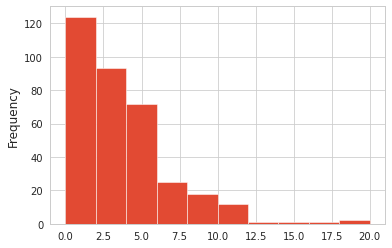

In [ ]:
neigh_with_rents['number of venues'].plot.hist()

In [ ]:
# Now let's find the average score for the rents that are in the area:
from statistics import mean
def avg_pop(lis):
    if (( lis[0] == 0) & (len(lis) == 1)):
        return 0
    
    else:
        scores = []
        for an_id in lis:
            x = data2[data2['id']== an_id].popularity_score_norm
            x = float(x)
            scores.append(x)
        
        average = mean(scores)
        return average    
    


In [ ]:
list_averages = []
rents_average_score = neigh_with_rents.apply( lambda row: avg_pop(row['rents']), axis=1)
rents_average_score

0      1.955853
1      3.319371
2      0.000000
3      1.687850
4      1.492460
         ...   
344    1.785694
345    1.316538
346    2.149766
347    0.774831
348    1.817314
Length: 349, dtype: float64

In [ ]:
neigh_with_rents['rents_avg_popularity'] = rents_average_score
neigh_with_rents

,index,latitude,longitude,x,y,distance from center,rents,number of rents,number of venues,rents_avg_popularity
0,0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12,7,1.955853
1,1,55.678053,12.568542,5.296562e+06,1.815171e+06,285.714286,"[1714518, 2713104, 8437007, 10714307, 12116943...",20,2,3.319371
2,2,55.674072,12.569276,5.295990e+06,1.815171e+06,285.714286,[0],0,8,0.000000
3,3,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571,"[1005766, 2915555, 4193537, 10188373, 11836215...",10,14,1.687850
4,4,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571,"[12807843, 32950026, 39465549]",3,4,1.492460
...,...,...,...,...,...,...,...,...,...,...
344,344,55.668345,12.550089,5.295705e+06,1.812314e+06,2913.725436,"[770907, 1293663, 2976384, 3226784, 4586402, 5...",24,2,1.785694
345,345,55.685776,12.587357,5.297133e+06,1.818028e+06,2982.944717,"[16122707, 17472947, 24706082, 26742973, 26743...",8,7,1.316538
346,346,55.673833,12.589564,5.295419e+06,1.818028e+06,2982.944717,"[27395293, 31143710, 44441455]",3,7,2.149766
347,347,55.678297,12.548256,5.297133e+06,1.812314e+06,2982.944717,"[696352, 17604343, 17904675, 19085204, 4225260...",6,4,0.774831


### Filter 
Now we have all the data needed to filter out the neighbourhoods properly. We want a neighbourhood with ots of entertainments especialy historic ones as we want more mature and wealthy people to visit our place. For this we want to get neighbourhoods that have higher value than the 50% quartile, so the median. 
Than we want a place where there is a high turnover what is quaified by the popularity score. We keep only neighbourhoods that are higher than the 70% quartile. 
But we want to exclude neighbourhoods that are already full of rents so the market is either full or the competition is great so we drop the top 10 %. 



In [ ]:
# First get a general hint from the columns
neigh_with_rents.describe()

,index,latitude,longitude,x,y,distance from center,number of rents,number of venues,rents_avg_popularity
count,349.000000,349.000000,349.000000,3.490000e+02,3.490000e+02,349.000000,349.000000,349.000000,349.000000
mean,174.000000,55.676062,12.568909,5.296276e+06,1.815171e+06,2006.906515,6.429799,3.255014,1.501557
std,100.891856,0.010685,0.010496,1.507352e+03,1.507352e+03,710.612518,6.475757,3.150581,1.251203
min,0.000000,55.655033,12.548256,5.293419e+06,1.812314e+06,0.000000,0.000000,0.000000,0.000000
25%,87.000000,55.667475,12.560473,5.295133e+06,1.814028e+06,1456.862718,1.000000,1.000000,0.822169
50%,174.000000,55.676062,12.568909,5.296276e+06,1.815171e+06,2080.031397,4.000000,2.000000,1.476679
75%,261.000000,55.684652,12.577347,5.297419e+06,1.816314e+06,2634.155559,11.000000,5.000000,1.989268
max,348.000000,55.697086,12.589564,5.299133e+06,1.818028e+06,2982.944717,30.000000,20.000000,8.620905


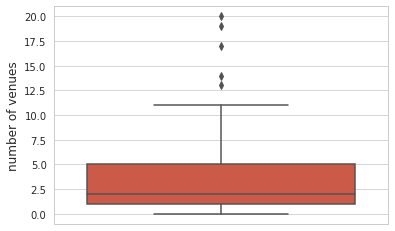

In [ ]:
sns.set_style("whitegrid")
  
sns.boxplot(y = 'number of venues', data = neigh_with_rents)

In [ ]:
limit_venues = neigh_with_rents['number of venues'].quantile(0.5)
limit_ratings = neigh_with_rents['rents_avg_popularity'].quantile(0.7)
limit_rents_top = neigh_with_rents['number of rents'].quantile(0.90)
limit_rents_top

16.0

In [ ]:
neigh_filtered_venues = neigh_with_rents[neigh_with_rents['number of venues'] >= limit_venues]
neigh_filtered_venues

,index,latitude,longitude,x,y,distance from center,rents,number of rents,number of venues,rents_avg_popularity
0,0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12,7,1.955853
1,1,55.678053,12.568542,5.296562e+06,1.815171e+06,285.714286,"[1714518, 2713104, 8437007, 10714307, 12116943...",20,2,3.319371
2,2,55.674072,12.569276,5.295990e+06,1.815171e+06,285.714286,[0],0,8,0.000000
3,3,55.680043,12.568174,5.296848e+06,1.815171e+06,571.428571,"[1005766, 2915555, 4193537, 10188373, 11836215...",10,14,1.687850
4,4,55.672081,12.569643,5.295705e+06,1.815171e+06,571.428571,"[12807843, 32950026, 39465549]",3,4,1.492460
...,...,...,...,...,...,...,...,...,...,...
344,344,55.668345,12.550089,5.295705e+06,1.812314e+06,2913.725436,"[770907, 1293663, 2976384, 3226784, 4586402, 5...",24,2,1.785694
345,345,55.685776,12.587357,5.297133e+06,1.818028e+06,2982.944717,"[16122707, 17472947, 24706082, 26742973, 26743...",8,7,1.316538
346,346,55.673833,12.589564,5.295419e+06,1.818028e+06,2982.944717,"[27395293, 31143710, 44441455]",3,7,2.149766
347,347,55.678297,12.548256,5.297133e+06,1.812314e+06,2982.944717,"[696352, 17604343, 17904675, 19085204, 4225260...",6,4,0.774831


In [ ]:
neigh_filtered_venues = neigh_filtered_venues[neigh_filtered_venues['rents_avg_popularity'] >= limit_ratings]
neigh_filtered_venues

,index,latitude,longitude,x,y,distance from center,rents,number of rents,number of venues,rents_avg_popularity
0,0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12,7,1.955853
1,1,55.678053,12.568542,5.296562e+06,1.815171e+06,285.714286,"[1714518, 2713104, 8437007, 10714307, 12116943...",20,2,3.319371
13,13,55.689994,12.566338,5.298276e+06,1.815171e+06,2000.000000,"[3846928, 17336616, 25955604]",3,5,2.093190
21,21,55.676436,12.570864,5.296276e+06,1.815456e+06,285.714286,"[2014951, 2123545, 2541416, 16268290, 20029280...",13,7,1.979878
23,23,55.678427,12.570497,5.296562e+06,1.815456e+06,404.061018,"[2805884, 6881244, 8437007, 13907755, 13914137...",28,2,2.978035
...,...,...,...,...,...,...,...,...,...,...
335,335,55.679804,12.588461,5.296276e+06,1.818028e+06,2857.142857,"[2029595, 2320048, 11143564, 14897392, 2334176...",13,7,2.039152
337,337,55.681795,12.588093,5.296562e+06,1.818028e+06,2871.393035,"[1455294, 25440004, 28148021, 41311453]",4,3,2.803465
339,339,55.674317,12.548989,5.296562e+06,1.812314e+06,2871.393035,"[1226593, 2820919, 23495332, 32180697, 3455218...",8,8,2.666382
346,346,55.673833,12.589564,5.295419e+06,1.818028e+06,2982.944717,"[27395293, 31143710, 44441455]",3,7,2.149766


In [ ]:
neigh_filtered_all = neigh_filtered_venues[neigh_filtered_venues['number of rents'] <= limit_rents_top]
neigh_filtered_all.reset_index(inplace=True, drop = True)
neigh_filtered_all

,index,latitude,longitude,x,y,distance from center,rents,number of rents,number of venues,rents_avg_popularity
0,0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12,7,1.955853
1,13,55.689994,12.566338,5.298276e+06,1.815171e+06,2000.000000,"[3846928, 17336616, 25955604]",3,5,2.093190
2,21,55.676436,12.570864,5.296276e+06,1.815456e+06,285.714286,"[2014951, 2123545, 2541416, 16268290, 20029280...",13,7,1.979878
3,25,55.677679,12.566586,5.296562e+06,1.814885e+06,404.061018,"[15494357, 22530215, 26742961, 35833605, 40908...",6,4,1.989189
4,29,55.679669,12.566219,5.296848e+06,1.814885e+06,638.876565,"[521284, 1406392, 26528828, 26742707]",4,9,2.011390
5,39,55.686388,12.569027,5.297705e+06,1.815456e+06,1456.862718,"[1496270, 2529055, 14144717, 26742972, 2862487...",10,5,2.161649
6,45,55.687630,12.564750,5.297990e+06,1.814885e+06,1737.932152,[9536683],1,2,1.997012
7,65,55.678801,12.572452,5.296562e+06,1.815742e+06,638.876565,"[10581642, 12316074, 15697358, 24084993, 24570...",12,2,2.919439
8,66,55.674820,12.573187,5.295990e+06,1.815742e+06,638.876565,"[1803867, 18030121, 18040509, 19304878, 229122...",12,7,3.481436
9,68,55.673324,12.565366,5.295990e+06,1.814599e+06,638.876565,[16255436],1,4,5.026521


In [ ]:
neigh_filtered_all.shape

(57, 10)

In [ ]:
neigh_filtered_all.shape[0]/neigh_with_rents.shape[0] * 100

16.332378223495702

In [ ]:
neigh_filtered_lats = neigh_filtered_all['latitude'].tolist()
neigh_filtered_lons = neigh_filtered_all['longitude'].tolist()
neigh_filtered_dist = neigh_filtered_all['distance from center'].tolist()
neigh_filtered_rents = neigh_filtered_all['number of rents'].tolist()
neigh_filtered_venues = neigh_filtered_all['number of venues'].tolist()
neigh_filtered_pop = neigh_filtered_all['rents_avg_popularity'].tolist()


Now we are left with only 18 % of our dataset which means 67 neightbourhoods from the 363. Now let's see if we can find a pattern in ther location, which could finally decide in which larger neighbourhood/borough should we search for apartmans to buy. 

In [ ]:
# now we have limited the neighbour points we originally had 
# visualize the neighbourhoods and the rents as well
import random
def gen_rand_col():
    random_number = random.randint(0,16777215)
    hex_number = str(hex(random_number))
    hex_number ='#'+ hex_number[2:]
    return hex_number
    
map_cop_centered_neigh = folium.Map(location=cop_center, zoom_start=12)

# add markers to map
folium.Marker([lat_c_cop, long_c_cop],
              popup='CENTER-City Hall Square',
              icon=folium.Icon(color='black', icon_color='white', icon='fa-university ',  prefix='fa')
             ).add_to(map_cop_centered_neigh)

# with zip we can pair lists together
for lat, lon, dist, num_rents, num_venues, pop in zip(neigh_filtered_lats, neigh_filtered_lons, neigh_filtered_dist, neigh_filtered_rents, neigh_filtered_venues, neigh_filtered_pop):            
        folium.Marker([lat, lon],
        popup='Neighbourhood center, number of rents: {}, venues: {}, distance from center: {}, average popularity score: {}'.format(num_rents, num_venues, dist, pop),
        icon=folium.Icon(color='black', icon_color='white', icon='fa-street-view ',  prefix='fa')
        ).add_to(map_cop_centered_neigh)       
        
folium.GeoJson(copenhagen_boroughs, style_function=boroughs_style, name='geojson').add_to(map_cop_centered_neigh)
map_cop_centered_neigh

In [ ]:
from statistics import median
lis = ['Feri']
median(lis)

'Feri'

In [ ]:
# let's get a summary of in which borough is there the most number of good neighbourhoods that are not far from the center, there are lots of historic venues there, they are quite popular among turists but not full of listings. 

def get_neigh(lis):
    if ((len(lis) == 1) & (lis[0] == 0)):
        return None
    else:
        neigh_lis = []
        for rent in lis:
            x = data2[data2['id']== rent].neighbourhood_cleansed.tolist()
            x = x[0]
            neigh_lis.append(x)
        if(len(neigh_lis) == 1):
            return neigh_lis[0]
        else:
            try:
                x = median(neigh_lis)
                return x
            except: # There is no maximum neighbourhood
                return neigh_lis[0]


In [ ]:
neighs = neigh_filtered_all.apply(lambda row: get_neigh(row['rents']), axis = 1) 

In [ ]:
neighs

0                      Indre By
1                       Nrrebro
2                      Indre By
3                      Indre By
4                      Indre By
5                      Indre By
6                      Indre By
7                      Indre By
8                      Indre By
9     Vesterbro-Kongens Enghave
10                     Indre By
11    Vesterbro-Kongens Enghave
12                     Indre By
13                     Indre By
14                     Indre By
15                     Indre By
16                     Indre By
17    Vesterbro-Kongens Enghave
18                     Indre By
19                     Indre By
20    Vesterbro-Kongens Enghave
21                     Indre By
22                     Indre By
23                     Indre By
24                     Indre By
25    Vesterbro-Kongens Enghave
26                     Indre By
27                  Amager Vest
28                     Indre By
29                     Indre By
30                     Indre By
31      

In [ ]:
neigh_filtered_all['districts'] = neighs
neigh_filtered_all.sort_values(by = 'districts', ascending=True, inplace = True)

In [ ]:
neigh_filtered_all.reset_index(inplace=True, drop=True)

In [ ]:
neigh_filtered_all.rename(columns={'index':'neighbourhood id'}, inplace=True)
neigh_filtered_all

,neighbourhood id,latitude,longitude,x,y,distance from center,rents,number of rents,number of venues,rents_avg_popularity,districts
0,170,55.665614,12.578935,5.294562e+06,1.816314e+06,2060.315015,"[2164189, 2780733, 3624406, 3643684, 6428008, ...",14,9,2.117896,Amager Vest
1,339,55.674317,12.548989,5.296562e+06,1.812314e+06,2871.393035,"[1226593, 2820919, 23495332, 32180697, 3455218...",8,8,2.666382,Frederiksberg
2,325,55.678671,12.550211,5.297133e+06,1.812599e+06,2710.523709,"[1031796, 2445629, 10435392, 10435787, 2097811...",7,4,2.587513,Frederiksberg
3,303,55.681034,12.551799,5.297419e+06,1.812885e+06,2555.506260,"[5200585, 19373432]",2,4,4.929863,Frederiksberg
4,0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12,7,1.955853,Indre By
5,346,55.673833,12.589564,5.295419e+06,1.818028e+06,2982.944717,"[27395293, 31143710, 44441455]",3,7,2.149766,Indre By
6,189,55.676184,12.558766,5.296562e+06,1.813742e+06,1456.862718,"[22111789, 39313935]",2,3,3.611544,Indre By
7,192,55.673951,12.579420,5.295705e+06,1.816599e+06,1538.618516,"[1457864, 6264689, 22350241]",3,8,6.546022,Indre By
8,195,55.683904,12.577582,5.297133e+06,1.816599e+06,1665.986256,"[4877128, 13323120, 24826721, 29695196, 33550627]",5,5,4.321997,Indre By
9,225,55.680297,12.580272,5.296562e+06,1.816885e+06,1737.932152,"[6637197, 15928190, 24299796, 34668954, 436532...",6,2,2.656310,Indre By


In [ ]:
for i in neigh_filtered_all['neighbourhood id'].tolist():
    print(i)
print('len', len(neigh_filtered_all['neighbourhood id'].tolist()))

170
339
325
303
0
346
189
192
195
225
233
257
263
301
293
315
316
323
324
328
335
337
267
163
188
45
73
159
85
107
108
65
25
29
111
66
115
117
39
150
157
158
21
69
251
209
13
326
160
288
68
72
236
114
118
318
348
len 57


In [ ]:
counts = neigh_filtered_all.groupby(by='districts').count()
counts = counts[['neighbourhood id']].reset_index()
counts.rename(columns = {'neighbourhood id' : 'counts'}, inplace = True)
counts.sort_values(by= 'counts', inplace= True)
counts.reset_index(drop= True, inplace=True)
counts

,districts,counts
0,Amager Vest,1
1,Frederiksberg,3
2,Nrrebro,3
3,Vesterbro-Kongens Enghave,10
4,Indre By,40


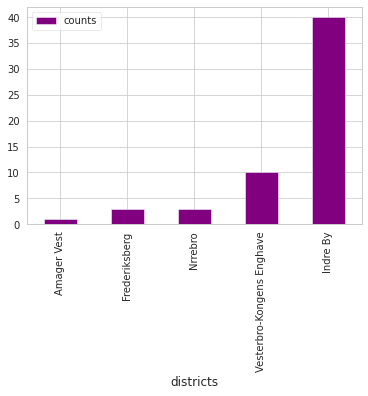

In [ ]:
counts.plot.bar(x = 'districts', y = 'counts', color = 'purple')

So from the analysis Indre By is the place where we can find the most neighbourhoods to our needs but as it is in the center and we not have yet considered the price of the house we need to keep Vesterbro where we stil have good spots both in the northern and southern part. 

Now we have found the ideal neighbourhoods that have many historic venues and also not full of rents, and the rents in this area are popular that can mean a good turnover. 

With the analyzation of the Airbnb data we have ideas on what kind of property should we buy and how to advertise it to have a popular listing. 

So in this point we can make a good suggestion to investors. As to make the decisions more easy have a clustering on all the possible venues in the neighbourhoods. 

In [ ]:
print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: EUYYTGDFEA2H1PQWHDN5YFJRMC2LMUOFWSLQUL0TG2QLSHXT
CLIENT_SECRET:MYDFU44LUCG3Y4DXHA3WO0YB2XX3H5BY1MVAR1OFCEZZGHID


In [ ]:
# let's try to ask for the venues for one neighbourhood in our 67 ones. 

neighborhood_latitude = neigh_filtered_all.loc[0, 'latitude'] # neighborhood latitude value
neighborhood_longitude = neigh_filtered_all.loc[0, 'longitude'] # neighborhood longitude value

neighborhood_name = neigh_filtered_all.loc[0, 'districts'] # distrit name

print('Latitude and longitude values of a neighbourhood in {} are {}, {}.'.format(neighborhood_name, 
                                                               neighborhood_latitude, 
                                                               neighborhood_longitude))
radius = 600 # 600 m's which is the radius of the neighbourhood
LIMIT = 100
latitude = neighborhood_latitude
longitude = neighborhood_longitude
url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, radius, LIMIT)
print(url)

# make an HTTP request for the venures through the Foursquare API:
results = requests.get(url).json()
if(results != None):
    print('200, OK')
    

Latitude and longitude values of a neighbourhood in Amager Vest are 55.66561438521698, 12.57893472051174.
https://api.foursquare.com/v2/venues/explore?client_id=EUYYTGDFEA2H1PQWHDN5YFJRMC2LMUOFWSLQUL0TG2QLSHXT&client_secret=MYDFU44LUCG3Y4DXHA3WO0YB2XX3H5BY1MVAR1OFCEZZGHID&ll=55.66561438521698,12.57893472051174&v=20180605&radius=600&limit=100
200, OK


In [ ]:
import json # library to handle JSON files
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

def get_category_type(x):
    y = pd.Series([])
    for i in range(len(nearby_venues)):
        print(x[i][0]['name'])
        y[i] = x[i][0]['name']

    nearby_venues['venue.categories'] = y 
    return y

In [ ]:
venues = results['response']['groups'][0]['items']


In [ ]:
nearby_venues = json_normalize(venues)
nearby_venues

,referralId,reasons.count,reasons.items,venue.id,venue.name,venue.location.address,venue.location.lat,venue.location.lng,venue.location.labeledLatLngs,venue.location.distance,...,venue.location.city,venue.location.state,venue.location.country,venue.location.formattedAddress,venue.categories,venue.photos.count,venue.photos.groups,venue.location.crossStreet,venue.venuePage.id,venue.location.neighborhood
0,e-0-598d8ffbdec1d6471f1f83b0-0,0,"[{'summary': 'This spot is popular', 'type': '...",598d8ffbdec1d6471f1f83b0,Andersen Bakery,Thorshavnsgade 26,55.667215,12.578749,"[{'label': 'display', 'lat': 55.66721497326351...",178,...,København,Region Hovedstaden,Danmark,"[Thorshavnsgade 26, 2300 København, Danmark]","[{'id': '4bf58dd8d48988d16a941735', 'name': 'B...",0,[],NaN,NaN,NaN
1,e-0-4ece9bee93ad987b4afc8c83-1,0,"[{'summary': 'This spot is popular', 'type': '...",4ece9bee93ad987b4afc8c83,Il Buco,NaN,55.666265,12.580132,"[{'label': 'display', 'lat': 55.66626520452843...",104,...,København,Region Hovedstaden,Danmark,"[København, Danmark]","[{'id': '4bf58dd8d48988d110941735', 'name': 'I...",0,[],NaN,NaN,NaN
2,e-0-4bd5dd844e32d13a9b9ec180-2,0,"[{'summary': 'This spot is popular', 'type': '...",4bd5dd844e32d13a9b9ec180,Wulff & Konstali,Isafjordsgade 10,55.665470,12.578323,"[{'label': 'display', 'lat': 55.66546993149633...",41,...,København S,Region Hovedstaden,Danmark,"[Isafjordsgade 10, 2300 København S, Danmark]","[{'id': '4bf58dd8d48988d16a941735', 'name': 'B...",0,[],NaN,NaN,NaN
3,e-0-4c3b05b6def90f477932fd2d-3,0,"[{'summary': 'This spot is popular', 'type': '...",4c3b05b6def90f477932fd2d,Toft Vin,Islands Brygge 25,55.666768,12.576893,"[{'label': 'display', 'lat': 55.66676772435257...",181,...,København,Region Hovedstaden,Danmark,"[Islands Brygge 25 (Egilsgade), 2300 København...","[{'id': '4bf58dd8d48988d119951735', 'name': 'W...",0,[],Egilsgade,NaN,NaN
4,e-0-4b1e85d6f964a520f61a24e3-4,0,"[{'summary': 'This spot is popular', 'type': '...",4b1e85d6f964a520f61a24e3,Islands Brygge,NaN,55.667723,12.577264,"[{'label': 'display', 'lat': 55.66772257189922...",257,...,København S,Region Hovedstaden,Danmark,"[2300 København S, Danmark]","[{'id': '4f2a25ac4b909258e854f55f', 'name': 'N...",0,[],NaN,NaN,NaN
5,e-0-557ab2e2498ea3ff8d39e4e8-5,0,"[{'summary': 'This spot is popular', 'type': '...",557ab2e2498ea3ff8d39e4e8,ROAST Coffee,Vestmannagade 4,55.668268,12.579784,"[{'label': 'display', 'lat': 55.668268, 'lng':...",300,...,København,Region Hovedstaden,Danmark,"[Vestmannagade 4, 2300 København, Danmark]","[{'id': '4bf58dd8d48988d1e0931735', 'name': 'C...",0,[],NaN,NaN,NaN
6,e-0-512603cde4b0f48093efc0da-6,0,"[{'summary': 'This spot is popular', 'type': '...",512603cde4b0f48093efc0da,Vivino HQ,"Njalsgade 21G, 1. sal",55.666227,12.580742,"[{'label': 'display', 'lat': 55.66622673793737...",132,...,København,Region Hovedstaden,Danmark,"[Njalsgade 21G, 1. sal, 2300 København, Danmark]","[{'id': '4bf58dd8d48988d125941735', 'name': 'T...",0,[],NaN,NaN,NaN
7,e-0-4bed2dc091380f47d07e9f18-7,0,"[{'summary': 'This spot is popular', 'type': '...",4bed2dc091380f47d07e9f18,Bryggen 11,Islands Brygge 11,55.668269,12.578295,"[{'label': 'display', 'lat': 55.66826866953344...",298,...,København s,Region Hovedstaden,Danmark,"[Islands Brygge 11, 2300 København s, Danmark]","[{'id': '4bf58dd8d48988d1c9941735', 'name': 'I...",0,[],NaN,NaN,NaN
8,e-0-4f69d25c1081aaf3d6bfd975-8,0,"[{'summary': 'This spot is popular', 'type': '...",4f69d25c1081aaf3d6bfd975,Havnebadet Islands Brygge,Islands Brygge 7,55.668657,12.578007,"[{'label': 'display', 'lat': 55.6686567348743,...",343,...,København S,Region Hovedstaden,Danmark,"[Islands Brygge 7, 2300 København S, Danmark]","[{'id': '4bf58dd8d48988d15e941735', 'name': 'P...",0,[],NaN,NaN,NaN
9,e-0-4b76a302f964a520b8552ee3-9,0,"[{'summary': 'This spot is popular', 'type': '...",4b76a302f964a520b8552ee3,Hatoba,Islands Brygge 9,55.668531,12.579252,"[{'label': 'display', 'lat': 55.66853065818707...",325,...,København,Region Hovedstaden,D

In [ ]:
# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]
nearby_venues

,venue.name,venue.categories,venue.location.lat,venue.location.lng
0,Andersen Bakery,"[{'id': '4bf58dd8d48988d16a941735', 'name': 'B...",55.667215,12.578749
1,Il Buco,"[{'id': '4bf58dd8d48988d110941735', 'name': 'I...",55.666265,12.580132
2,Wulff & Konstali,"[{'id': '4bf58dd8d48988d16a941735', 'name': 'B...",55.665470,12.578323
3,Toft Vin,"[{'id': '4bf58dd8d48988d119951735', 'name': 'W...",55.666768,12.576893
4,Islands Brygge,"[{'id': '4f2a25ac4b909258e854f55f', 'name': 'N...",55.667723,12.577264
5,ROAST Coffee,"[{'id': '4bf58dd8d48988d1e0931735', 'name': 'C...",55.668268,12.579784
6,Vivino HQ,"[{'id': '4bf58dd8d48988d125941735', 'name': 'T...",55.666227,12.580742
7,Bryggen 11,"[{'id': '4bf58dd8d48988d1c9941735', 'name': 'I...",55.668269,12.578295
8,Havnebadet Islands Brygge,"[{'id': '4bf58dd8d48988d15e941735', 'name': 'P...",55.668657,12.578007
9,Hatoba,"[{'id': '4bf58dd8d48988d1d2941735', 'name': 'S...",55.668531,12.579252


In [ ]:
# filter the category for each row
nearby_venues['venue.categories'] = get_category_type(nearby_venues['venue.categories'])
nearby_venues

Bakery
Italian Restaurant
Bakery
Wine Shop
Neighborhood
Coffee Shop
Tech Startup
Ice Cream Shop
Pool
Sushi Restaurant
Pier
Italian Restaurant
Café
Pool
Harbor / Marina
Scandinavian Restaurant
Coffee Shop
Restaurant
Grocery Store
Event Space
Beer Bar
Café
Hotel
Hotel Bar
Fast Food Restaurant
Hotel Bar
Bridge
Sushi Restaurant
Event Space
Sandwich Place
Gift Shop
Ice Cream Shop
Gym / Fitness Center
Seafood Restaurant
Bakery
Burger Joint
Thai Restaurant
Coffee Shop
Hotel
Gym / Fitness Center
Steakhouse
Pub
Hotel
Café
Bar
Hotel
Indian Restaurant
Bakery
Lottery Retailer
Casino
Gas Station
Hotel Bar
Italian Restaurant


,venue.name,venue.categories,venue.location.lat,venue.location.lng
0,Andersen Bakery,Bakery,55.667215,12.578749
1,Il Buco,Italian Restaurant,55.666265,12.580132
2,Wulff & Konstali,Bakery,55.665470,12.578323
3,Toft Vin,Wine Shop,55.666768,12.576893
4,Islands Brygge,Neighborhood,55.667723,12.577264
5,ROAST Coffee,Coffee Shop,55.668268,12.579784
6,Vivino HQ,Tech Startup,55.666227,12.580742
7,Bryggen 11,Ice Cream Shop,55.668269,12.578295
8,Havnebadet Islands Brygge,Pool,55.668657,12.578007
9,Hatoba,Sushi Restaurant,55.668531,12.579252


In [ ]:
# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]
nearby_venues

,name,categories,lat,lng
0,Andersen Bakery,Bakery,55.667215,12.578749
1,Il Buco,Italian Restaurant,55.666265,12.580132
2,Wulff & Konstali,Bakery,55.665470,12.578323
3,Toft Vin,Wine Shop,55.666768,12.576893
4,Islands Brygge,Neighborhood,55.667723,12.577264
5,ROAST Coffee,Coffee Shop,55.668268,12.579784
6,Vivino HQ,Tech Startup,55.666227,12.580742
7,Bryggen 11,Ice Cream Shop,55.668269,12.578295
8,Havnebadet Islands Brygge,Pool,55.668657,12.578007
9,Hatoba,Sushi Restaurant,55.668531,12.579252


In [ ]:
print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))


53 venues were returned by Foursquare.


In [ ]:
# create a single function that can get the venues for all neighbourhoods:

def getNearbyVenues(names, latitudes, longitudes, index, radius=600):
    
    venues_list=[]
    for name, lat, lng, ind in zip(names, latitudes, longitudes, index):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            ind,
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Index of neighbourhood','Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)


In [ ]:
neigh_venues = getNearbyVenues(names=neigh_filtered_all['districts'],
                                   latitudes=neigh_filtered_all['latitude'],
                                   longitudes=neigh_filtered_all['longitude'],
                                   index = neigh_filtered_all['neighbourhood id']
                                  )


Amager Vest
Frederiksberg
Frederiksberg
Frederiksberg
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Indre By
Nrrebro
Nrrebro
Nrrebro
Vesterbro-Kongens Enghave
Vesterbro-Kongens Enghave
Vesterbro-Kongens Enghave
Vesterbro-Kongens Enghave
Vesterbro-Kongens Enghave
Vesterbro-Kongens Enghave
Vesterbro-Kongens Enghave
Vesterbro-Kongens Enghave
Vesterbro-Kongens Enghave
Vesterbro-Kongens Enghave


In [ ]:
neigh_venues.head()

,Index of neighbourhood,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,170,Amager Vest,55.665614,12.578935,Andersen Bakery,55.667215,12.578749,Bakery
1,170,Amager Vest,55.665614,12.578935,Il Buco,55.666265,12.580132,Italian Restaurant
2,170,Amager Vest,55.665614,12.578935,Wulff & Konstali,55.665470,12.578323,Bakery
3,170,Amager Vest,55.665614,12.578935,Toft Vin,55.666768,12.576893,Wine Shop
4,170,Amager Vest,55.665614,12.578935,Islands Brygge,55.667723,12.577264,Neighborhood


In [ ]:
neigh_venues.shape

(4913, 8)

In [ ]:
y = pd.Series([])
y = neigh_venues.groupby('Index of neighbourhood').count().reset_index(drop = True)['Neighborhood Latitude']
y

count_df =  neigh_venues.groupby('Index of neighbourhood').count().reset_index(drop = False)
#count_df = count_df[['Neighborhood']]
count_df
count_df = count_df[['Index of neighbourhood']]


count_df.insert(1, "Count", y)

count_df

,Index of neighbourhood,Count
0,0,92
1,13,63
2,21,100
3,25,100
4,29,100
5,39,81
6,45,82
7,65,100
8,66,100
9,68,100


In [ ]:
# one hot encoding
neigh_onehot = pd.get_dummies(neigh_venues[['Venue Category']], prefix="", prefix_sep="")
neigh_onehot.head()

,African Restaurant,American Restaurant,Arcade,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Australian Restaurant,BBQ Joint,...,Tourist Information Center,Toy / Game Store,Train Station,University,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# add neighborhood column back to dataframe
neigh_onehot['Neighborhood'] = neigh_venues['Index of neighbourhood'] 

In [ ]:
neigh_onehot[['Neighborhood']]

,Neighborhood
0,170
1,170
2,170
3,170
4,170
...,...
4908,348
4909,348
4910,348
4911,348


In [ ]:
neigh_grouped = neigh_onehot.groupby('Neighborhood').mean().reset_index()
neigh_grouped

,Neighborhood,African Restaurant,American Restaurant,Arcade,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Australian Restaurant,...,Tourist Information Center,Toy / Game Store,Train Station,University,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,0,0.00,0.01087,0.000000,0.000000,0.010870,0.010870,0.000000,0.000000,0.00,...,0.00,0.021739,0.010870,0.000000,0.000000,0.010870,0.000000,0.000000,0.010870,0.000000
1,13,0.00,0.00000,0.015873,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,...,0.00,0.000000,0.000000,0.000000,0.031746,0.015873,0.015873,0.015873,0.000000,0.015873
2,21,0.00,0.01000,0.000000,0.000000,0.010000,0.010000,0.000000,0.010000,0.00,...,0.00,0.020000,0.000000,0.000000,0.000000,0.000000,0.020000,0.000000,0.010000,0.000000
3,25,0.00,0.01000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,...,0.01,0.030000,0.000000,0.000000,0.010000,0.010000,0.000000,0.010000,0.000000,0.010000
4,29,0.00,0.01000,0.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.00,...,0.01,0.020000,0.000000,0.000000,0.000000,0.010000,0.020000,0.010000,0.000000,0.000000
5,39,0.00,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,...,0.00,0.000000,0.000000,0.000000,0.012346,0.000000,0.024691,0.012346,0.000000,0.012346
6,45,0.00,0.00000,0.012195,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,...,0.00,0.000000,0.000000,0.000000,0.024390,0.012195,0.036585,0.012195,0.000000,0.012195
7,65,0.00,0.01000,0.000000,0.000000,0.010000,0.000000,0.000000,0.010000,0.00,...,0.00,0.020000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.010000,0.000000
8,66,0.00,0.01000,0.000000,0.000000,0.020000,0.010000,0.000000,0.000000,0.00,...,0.00,0.020000,0.000000,0.000000,0.000000,0.000000,0.030000,0.000000,0.010000,0.000000
9,68,0.00,0.01000,0.000000,0.000000,0.000000,0.010000,0.000000,0.010000,0.00,...,0.01,0.000000,0.010000,0.000000,0.010000,0.010000,0.010000,0.000000,0.000000,0.000000


In [ ]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [ ]:


num_top_venues = 20

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = neigh_grouped['Neighborhood']

for ind in np.arange(neigh_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(neigh_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()


,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,0,Café,Hotel,Bakery,Scandinavian Restaurant,Coffee Shop,Theme Park,Gay Bar,Cocktail Bar,Beer Bar,...,Restaurant,Toy / Game Store,Theme Park Ride / Attraction,Burger Joint,Movie Theater,Hostel,Grocery Store,Comic Shop,Clothing Store,Museum
1,13,Café,Burger Joint,Coffee Shop,Bakery,Cocktail Bar,Clothing Store,Scandinavian Restaurant,Pizza Place,Beer Bar,...,Italian Restaurant,Garden,Hotel,Steakhouse,Candy Store,Ski Shop,Indian Restaurant,Ice Cream Shop,Grocery Store,Nightclub
2,21,Café,Scandinavian Restaurant,Cocktail Bar,Hotel,Bakery,Gay Bar,Burger Joint,Music Venue,Beer Bar,...,Grocery Store,Toy / Game Store,Coffee Shop,Theme Park,Theme Park Ride / Attraction,Wine Bar,Thrift / Vintage Store,Restaurant,Bar,History Museum
3,25,Café,Hotel,Bakery,Coffee Shop,Theme Park Ride / Attraction,Theme Park,Cocktail Bar,Scandinavian Restaurant,Movie Theater,...,Gay Bar,Beer Bar,Grocery Store,French Restaurant,Burger Joint,Gift Shop,Tea Room,Theater,Hostel,Music Venue
4,29,Café,Scandinavian Restaurant,Beer Bar,Bakery,Coffee Shop,Hotel,Gay Bar,French Restaurant,Breakfast Spot,...,Sushi Restaurant,Cocktail Bar,Movie Theater,Toy / Game Store,Wine Bar,Italian Restaurant,Plaza,Creperie,Comic Shop,Clothing Store


In [ ]:
import numpy as np
from sklearn.cluster import KMeans

In [ ]:
# set number of clusters
kclusters = 3

neigh_grouped_clustering = neigh_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(neigh_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

neigh_merged = neigh_filtered_all

# merge manhattan_grouped with manhattan_data to add latitude/longitude for each neighborhood
neigh_merged = neigh_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='neighbourhood id')

neigh_merged.head() # check the last columns!

,neighbourhood id,latitude,longitude,x,y,distance from center,rents,number of rents,number of venues,rents_avg_popularity,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,170,55.665614,12.578935,5.294562e+06,1.816314e+06,2060.315015,"[2164189, 2780733, 3624406, 3643684, 6428008, ...",14,9,2.117896,...,Event Space,Gas Station,Restaurant,Gift Shop,Casino,Steakhouse,Grocery Store,Seafood Restaurant,Burger Joint,Fast Food Restaurant
1,339,55.674317,12.548989,5.296562e+06,1.812314e+06,2871.393035,"[1226593, 2820919, 23495332, 32180697, 3455218...",8,8,2.666382,...,Bar,Supermarket,Pizza Place,Vietnamese Restaurant,Thai Restaurant,Bookstore,Pub,Restaurant,Ice Cream Shop,Deli / Bodega
2,325,55.678671,12.550211,5.297133e+06,1.812599e+06,2710.523709,"[1031796, 2445629, 10435392, 10435787, 2097811...",7,4,2.587513,...,Steakhouse,Butcher,Sporting Goods Shop,Cheese Shop,Restaurant,Deli / Bodega,Furniture / Home Store,Music Store,Garden,Gym
3,303,55.681034,12.551799,5.297419e+06,1.812885e+06,2555.506260,"[5200585, 19373432]",2,4,4.929863,...,Sports Bar,Falafel Restaurant,Butcher,Sporting Goods Shop,Greek Restaurant,Convenience Store,Deli / Bodega,Supermarket,Chinese Restaurant,Scandinavian Restaurant
4,0,55.676062,12.568909,5.296276e+06,1.815171e+06,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12,7,1.955853,...,Restaurant,Toy / Game Store,Theme Park Ride / Attraction,Burger Joint,Movie Theater,Hostel,Grocery Store,Comic Shop,Clothing Store,Museum


In [ ]:
neigh_merged['Cluster Labels']

0     1
1     2
2     2
3     2
4     1
5     0
6     1
7     0
8     0
9     0
10    0
11    0
12    0
13    0
14    0
15    0
16    0
17    0
18    0
19    0
20    0
21    0
22    0
23    2
24    0
25    2
26    2
27    1
28    2
29    0
30    0
31    0
32    1
33    2
34    0
35    0
36    0
37    1
38    2
39    0
40    0
41    0
42    0
43    0
44    2
45    2
46    2
47    2
48    1
49    2
50    1
51    1
52    1
53    1
54    1
55    2
56    2
Name: Cluster Labels, dtype: int32

In [ ]:
import matplotlib.cm as cm
import matplotlib.colors as colors
#create map
map_clusters = folium.Map(location=cop_center, zoom_start=12)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i +300+ x + (i*x)**2 for i in range(3)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(neigh_merged['latitude'], neigh_merged['longitude'], neigh_merged['neighbourhood id'], neigh_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    if cluster == 1:
      fill_color = 'blue'
      color='blue'
    else:
      color=rainbow[cluster ]
      fill_color = rainbow[cluster]
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=color,
        fill=True,
        fill_color = fill_color,
        fill_opacity=0.7).add_to(map_clusters)

folium.GeoJson(copenhagen_boroughs, style_function=boroughs_style, name='geojson').add_to(map_clusters)
map_clusters

In [ ]:
col = neigh_merged.columns.to_list()[12:]

In [ ]:
num_clusters = 3
words = []
for k in range(0, num_clusters):
  print(k)
  x = neigh_merged.loc[neigh_merged['Cluster Labels'] == k, neigh_merged.columns[[1] + list(range(5, neigh_merged.shape[1]))]]
  full =  []
  for i in col:
    t = x[i].tolist()
    full.append(t)
  flat_list = [item for sublist in full for item in sublist]
  words.append(flat_list)

0
1
2


In [ ]:
from collections import Counter
cluster0_dic = dict(Counter(words[0]))
cluster1_dic = dict(Counter(words[1]))
cluster2_dic = dict(Counter(words[2]))

In [ ]:
clus_df = pd.DataFrame([cluster0_dic, cluster1_dic, cluster2_dic])

In [ ]:
clus_df

,Scandinavian Restaurant,Coffee Shop,Restaurant,Café,Furniture / Home Store,Clothing Store,Italian Restaurant,Bar,Cocktail Bar,French Restaurant,...,Candy Store,Indie Movie Theater,Cosmetics Shop,Ski Shop,Community Center,Music Store,Rock Club,Recreation Center,Record Shop,Food Service
0,29,28,22,27,22.0,20,11,23,25,23,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,11,10,6,12,NaN,1,5,8,11,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,13,15,10,16,1.0,3,10,6,15,8,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [ ]:
excluding_venues = clus_df.isnull().sum(axis=0) [clus_df.isnull().sum(axis=0) == 2].index.tolist()

In [ ]:
clus_ex_df = clus_df.loc[:, excluding_venues]

In [ ]:
clus_ex_df.head()

,Art Museum,Arts & Crafts Store,Art Gallery,Juice Bar,Jazz Club,Department Store,Dessert Shop,Wine Shop,Palace,Bridge,...,Candy Store,Indie Movie Theater,Cosmetics Shop,Ski Shop,Community Center,Music Store,Rock Club,Recreation Center,Record Shop,Food Service
0,6.0,9.0,12.0,3.0,3.0,5.0,1.0,8.0,2.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [ ]:
clus0_ex_df = clus_ex_df.iloc[0,:].to_frame().transpose().dropna(axis=1).squeeze().sort_values(ascending=False).iloc[:10].to_dict()

In [ ]:
clus1_ex_df = clus_ex_df.iloc[1,:].to_frame().transpose().dropna(axis=1).squeeze().sort_values(ascending=False).iloc[:10].to_dict()

In [ ]:
clus2_ex_df = clus_ex_df.iloc[2,:].to_frame().transpose().dropna(axis=1).squeeze().sort_values(ascending=False).iloc[:10].to_dict()

In [ ]:
clus0_ex_df

{'Art Gallery': 12.0,
 'Art Museum': 6.0,
 'Arts & Crafts Store': 9.0,
 'Bridge': 2.0,
 'Department Store': 5.0,
 'Jazz Club': 3.0,
 'Juice Bar': 3.0,
 'Palace': 2.0,
 'Thrift / Vintage Store': 5.0,
 'Wine Shop': 8.0}

In [ ]:
clus1_ex_df

Gastropub                3.0
Performing Arts Venue    3.0
Convention Center        2.0
Lounge                   2.0
Event Space              1.0
Gas Station              1.0
Food & Drink Shop        1.0
Fast Food Restaurant     1.0
Name: 1, dtype: float64

In [ ]:
clus2_ex_df

Supermarket                  4.0
Ramen Restaurant             4.0
Greek Restaurant             4.0
Vietnamese Restaurant        3.0
Middle Eastern Restaurant    3.0
Falafel Restaurant           3.0
Sporting Goods Shop          3.0
Butcher                      2.0
Cheese Shop                  2.0
Yoga Studio                  2.0
Name: 2, dtype: float64

In [ ]:
type(cluster0_dic)

dict

In [ ]:
def sort_dic(dic, n):
  sorted_lis1 = []
  sorted_dic1 = {}
  for w in sorted(dic, key=dic.get, reverse=True):
    sorted_lis1.append(w) 
  for i in sorted_lis1[:n]:
    sorted_dic1[i] = dic[i]
  return sorted_dic1


In [ ]:
cluster0_sort = sort_dic(cluster0_dic, 20)
cluster1_sort = sort_dic(cluster1_dic, 20)
cluster2_sort = sort_dic(cluster2_dic, 20)

In [ ]:
cluster0_sort

{'Art Gallery': 12,
 'Bakery': 19,
 'Bar': 23,
 'Beer Bar': 16,
 'Breakfast Spot': 13,
 'Burger Joint': 22,
 'Café': 27,
 'Clothing Store': 20,
 'Cocktail Bar': 25,
 'Coffee Shop': 28,
 'French Restaurant': 23,
 'Furniture / Home Store': 22,
 'History Museum': 11,
 'Hotel': 16,
 'Italian Restaurant': 11,
 'Plaza': 21,
 'Restaurant': 22,
 'Scandinavian Restaurant': 29,
 'Steakhouse': 12,
 'Wine Bar': 19}

In [ ]:

import os

from os import path
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def wordMap(word_freq, name):
  # using word frequency list:
  #word_freq = open("/tmp/word_freq.txt").read()
  # say it looks like this:
  #text = " ".join([(k + " ")*v for k,v in word_freq.items()])
  #print(text)
  # Generate a word cloud image
  wordcloud = WordCloud(collocations=False, relative_scaling=0.4).generate_from_frequencies(word_freq)


  # Display the generated image:
  # the matplotlib way
  # lower max_font_size

  plt.figure()
  plt.imshow(wordcloud, interpolation="bilinear")
  plt.axis("off")
  plt.savefig('figures/'+name+'.png')
  plt.show()

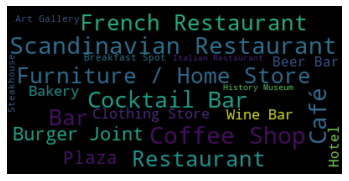

In [ ]:
wordMap(cluster0_sort, 'cluster0')


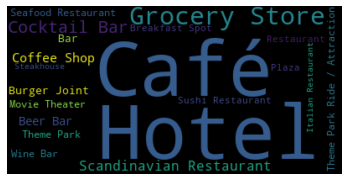

In [ ]:
wordMap(cluster1_sort, 'cluster1')

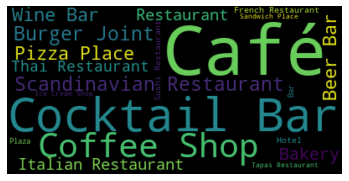

In [ ]:
wordMap(cluster2_sort, 'cluster2')

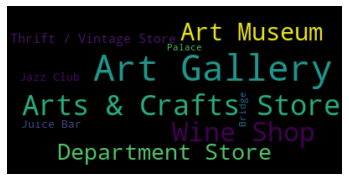

In [ ]:
wordMap(clus0_ex_df, 'differ_cluster0')

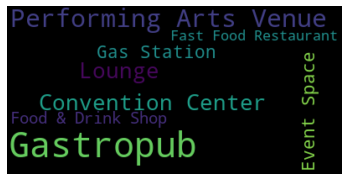

In [ ]:
wordMap(clus1_ex_df, 'differ_cluster1')

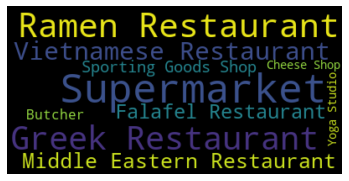

In [ ]:
wordMap(clus2_ex_df, 'differ_cluster2')

In [ ]:
dict_count = {}

x = neigh_merged.loc[neigh_merged['Cluster Labels'] == 0, neigh_merged.columns[[1] + list(range(5, neigh_merged.shape[1]))]]
cluster1_cat = list(x)
t = x[i].value_counts()
t.index[0]

'Wine Bar'

In [ ]:
num_clusters = 3
tops = []
for k in range(0, num_clusters):
  print(k)
  x = neigh_merged.loc[neigh_merged['Cluster Labels'] == k, neigh_merged.columns[[1] + list(range(5, neigh_merged.shape[1]))]]
  most_feq =  []
  for i in cluster1_cat[8:]:
    t = x[i].value_counts().index
    for c in range(0,len(t)):

      if t[c] in most_feq:
        pass

      else:
        most_feq.append(t[c])
        break

  tops.append(most_feq)

0
1
2


In [ ]:
tops[1]

['Hotel',
 'Cocktail Bar',
 'Café',
 'Scandinavian Restaurant',
 'Coffee Shop',
 'Theme Park',
 'Pool',
 'Burger Joint',
 'Sushi Restaurant',
 'Seafood Restaurant',
 'Restaurant',
 'Gas Station',
 'Grocery Store',
 'Breakfast Spot',
 'Casino',
 'Steakhouse',
 'Beer Bar',
 'Music Venue',
 'Clothing Store',
 'Fast Food Restaurant']

In [ ]:
distinct1 = []
for i in range(0,len(tops[0])):
  if((tops[0][i] not in tops[1]) & (tops[0][i] not in tops[2])):
    distinct1.append(tops[0][i])


In [ ]:
distinct2 = []
for i in range(0,len(tops[0])):
  if((tops[1][i] not in tops[0]) & (tops[1][i] not in tops[2])):
    distinct2.append(tops[1][i])

In [ ]:
distinct3 = []
for i in range(0,len(tops[0])):
  if((tops[2][i] not in tops[0]) & (tops[2][i] not in tops[1])):
    distinct3.append(tops[2][i])

In [ ]:
distinct = [distinct1, distinct2, distinct3]
for k,i in enumerate(distinct): 
  print(f'Cluster {k}: {i}')

Cluster 0: ['French Restaurant', 'Museum', 'Bookstore', 'History Museum', 'Arts & Crafts Store', 'Art Gallery', 'Sandwich Place', "Men's Store"]
Cluster 1: ['Hotel', 'Theme Park', 'Pool', 'Seafood Restaurant', 'Gas Station', 'Grocery Store', 'Casino', 'Steakhouse', 'Fast Food Restaurant']
Cluster 2: ['Pizza Place', 'Italian Restaurant', 'Vietnamese Restaurant', 'Greek Restaurant', 'Deli / Bodega', 'Music Store', 'Ice Cream Shop', 'Gym']


In [ ]:
print('Nuber of rows: {} in cluster {}'.format(x.shape[0], 0))
dict_count['Cluster 0'] = x.shape[0]

Nuber of rows: 16 in cluster 0


In [ ]:
x = neigh_merged.loc[neigh_merged['Cluster Labels'] == 1, neigh_merged.columns[[1] + list(range(5, neigh_merged.shape[1]))]]
x

,latitude,distance from center,rents,number of rents,number of venues,rents_avg_popularity,districts,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,55.665614,2060.315015,"[2164189, 2780733, 3624406, 3643684, 6428008, ...",14,9,2.117896,Amager Vest,1,Bakery,Hotel,...,Event Space,Gas Station,Restaurant,Gift Shop,Casino,Steakhouse,Grocery Store,Seafood Restaurant,Burger Joint,Fast Food Restaurant
4,55.676062,0.000000,"[4298831, 8927403, 28204455, 31144301, 3213714...",12,7,1.955853,Indre By,1,Café,Hotel,...,Restaurant,Toy / Game Store,Theme Park Ride / Attraction,Burger Joint,Movie Theater,Hostel,Grocery Store,Comic Shop,Clothing Store,Museum
6,55.676184,1456.862718,"[22111789, 39313935]",2,3,3.611544,Indre By,1,Hotel,Cocktail Bar,...,Movie Theater,Italian Restaurant,Wine Bar,Salad Place,French Restaurant,Burger Joint,Sandwich Place,Music Venue,Plaza,Chinese Restaurant
27,55.680538,1428.571429,[24797705],1,5,2.078003,Indre By,1,Hotel,Scandinavian Restaurant,...,Gay Bar,Convention Center,Movie Theater,Breakfast Spot,Music Venue,Concert Hall,Park,Plaza,Playground,Pizza Place
32,55.677679,404.061018,"[15494357, 22530215, 26742961, 35833605, 40908...",6,4,1.989189,Indre By,1,Café,Hotel,...,Gay Bar,Beer Bar,Grocery Store,French Restaurant,Burger Joint,Gift Shop,Tea Room,Theater,Hostel,Music Venue
37,55.680912,1212.183053,"[928173, 6175735, 6315899, 6586974, 26928875, ...",7,5,2.354180,Indre By,1,Café,Beer Bar,...,Grocery Store,Sandwich Place,Gay Bar,Seafood Restaurant,Shoe Store,Movie Theater,Salad Place,Music Venue,Concert Hall,Convention Center
48,55.668596,1428.571429,[568346],1,5,7.847114,Vesterbro-Kongens Enghave,1,Hotel,Coffee Shop,...,Scandinavian Restaurant,Seafood Restaurant,Italian Restaurant,Breakfast Spot,Restaurant,Plaza,Beer Bar,Wine Bar,Theme Park Ride / Attraction,Steakhouse
50,55.673324,638.876565,[16255436],1,4,5.026521,Vesterbro-Kongens Enghave,1,Hotel,Theme Park Ride / Attraction,...,Gastropub,Gay Bar,Grocery Store,Breakfast Spot,Theater,Performing Arts Venue,Beer Bar,Bar,Bakery,Vegetarian / Vegan Restaurant
51,55.671334,808.122036,[21443084],1,4,8.377535,Vesterbro-Kongens Enghave,1,Hotel,Scandinavian Restaurant,...,Plaza,Pizza Place,Performing Arts Venue,Gastropub,Coffee Shop,Wine Bar,Lounge,Bar,Movie Theater,Japanese Restaurant
52,55.667848,1916.629695,[11301096],1,4,1.856474,Vesterbro-Kongens Enghave,1,Hotel,Café,...,Restaurant,Gym,Italian Restaurant,Breakfast Spot,Hotel Bar,Beer Bar,Grocery Store,Seafood Restaurant,Food & Drink Shop,Convenience Store


In [ ]:
print('Nuber of rows: {} in cluster {}'.format(x.shape[0], 0))
dict_count['Cluster 1'] = x.shape[0]

Nuber of rows: 12 in cluster 0


In [ ]:
x = neigh_merged.loc[neigh_merged['Cluster Labels'] == 2, neigh_merged.columns[[1] + list(range(5, neigh_merged.shape[1]))]]
x

,latitude,distance from center,rents,number of rents,number of venues,rents_avg_popularity,districts,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
1,55.674317,2871.393035,"[1226593, 2820919, 23495332, 32180697, 3455218...",8,8,2.666382,Frederiksberg,2,Café,Cocktail Bar,...,Bar,Supermarket,Pizza Place,Vietnamese Restaurant,Thai Restaurant,Bookstore,Pub,Restaurant,Ice Cream Shop,Deli / Bodega
2,55.678671,2710.523709,"[1031796, 2445629, 10435392, 10435787, 2097811...",7,4,2.587513,Frederiksberg,2,Café,French Restaurant,...,Steakhouse,Butcher,Sporting Goods Shop,Cheese Shop,Restaurant,Deli / Bodega,Furniture / Home Store,Music Store,Garden,Gym
3,55.681034,2555.506260,"[5200585, 19373432]",2,4,4.929863,Frederiksberg,2,Pizza Place,Café,...,Sports Bar,Falafel Restaurant,Butcher,Sporting Goods Shop,Greek Restaurant,Convenience Store,Deli / Bodega,Supermarket,Chinese Restaurant,Scandinavian Restaurant
23,55.682528,1616.244071,[859185],1,4,1.989268,Indre By,2,Café,Beer Bar,...,Bar,Convenience Store,Plaza,Burger Joint,Greek Restaurant,Chinese Restaurant,Cocktail Bar,Shoe Store,Gym,Gourmet Shop
25,55.687630,1737.932152,[9536683],1,2,1.997012,Indre By,2,Café,Coffee Shop,...,Vegetarian / Vegan Restaurant,Cocktail Bar,Clothing Store,Italian Restaurant,Ramen Restaurant,Cosmetics Shop,Creperie,Rock Club,Yoga Studio,Food Court
26,55.682781,1030.157507,"[225323, 2452011, 14010280, 20402568, 26417304...",12,2,1.893969,Indre By,2,Café,Coffee Shop,...,Tapas Restaurant,Tea Room,Bookstore,Park,Breakfast Spot,Men's Store,Toy / Game Store,Wine Bar,Greek Restaurant,Comic Shop
28,55.688752,1807.015806,"[2616719, 3198821, 10332346, 10858144, 1309440...",8,3,2.819423,Indre By,2,Café,Coffee Shop,...,Dance Studio,Yoga Studio,Salad Place,Ramen Restaurant,Sandwich Place,Science Museum,Deli / Bodega,Food Court,Plaza,Pizza Place
33,55.679669,638.876565,"[521284, 1406392, 26528828, 26742707]",4,9,2.011390,Indre By,2,Café,Scandinavian Restaurant,...,Sushi Restaurant,Cocktail Bar,Movie Theater,Toy / Game Store,Wine Bar,Italian Restaurant,Plaza,Creperie,Comic Shop,Clothing Store
38,55.686388,1456.862718,"[1496270, 2529055, 14144717, 26742972, 2862487...",10,5,2.161649,Indre By,2,Café,Coffee Shop,...,Garden,Bar,French Restaurant,Burger Joint,Tapas Restaurant,Restaurant,Botanical Garden,Science Museum,Ramen Restaurant,Sandwich Place
44,55.687751,2634.155559,"[1787198, 2137836, 2463144, 4798431, 6412978, ...",9,4,2.775900,Nrrebro,2,Café,Coffee Shop,...,Sandwich Place,Seafood Restaurant,Taco Place,Bakery,Ice Cream Shop,Theater,Asian Restaurant,Vegetarian / Vegan Restaurant,Cocktail Bar,Falafel Restaurant


In [ ]:
print('Nuber of rows: {} in cluster {}'.format(x.shape[0], 0))
dict_count['Cluster 2'] = x.shape[0]

Nuber of rows: 16 in cluster 0


In [ ]:
x = neigh_merged.loc[neigh_merged['Cluster Labels'] == 3, neigh_merged.columns[[1] + list(range(5, neigh_merged.shape[1]))]]
x

,latitude,distance from center,rents,number of rents,number of venues,rents_avg_popularity,districts,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue


In [ ]:
print('Nuber of rows: {} in cluster {}'.format(x.shape[0], 0))
dict_count['Cluster 3'] = x.shape[0]

Nuber of rows: 0 in cluster 0


In [ ]:
x = neigh_merged.loc[neigh_merged['Cluster Labels'] == 4, neigh_merged.columns[[1] + list(range(5, neigh_merged.shape[1]))]]
x

,latitude,distance from center,rents,number of rents,number of venues,rents_avg_popularity,districts,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue


In [ ]:
print('Nuber of rows: {} in cluster {}'.format(x.shape[0], 0))
dict_count['Cluster 4'] = x.shape[0]

Nuber of rows: 0 in cluster 0


In [ ]:
x = neigh_merged.loc[neigh_merged['Cluster Labels'] == 5, neigh_merged.columns[[1] + list(range(5, neigh_merged.shape[1]))]]
x

,latitude,distance from center,rents,number of rents,number of venues,rents_avg_popularity,districts,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue


In [ ]:
print('Nuber of rows: {} in cluster {}'.format(x.shape[0], 0))
dict_count['Cluster 5'] = x.shape[0]

Nuber of rows: 0 in cluster 0


In [ ]:
print(dict_count)

{'Cluster 0': 16, 'Cluster 1': 12, 'Cluster 2': 16, 'Cluster 3': 0, 'Cluster 4': 0, 'Cluster 5': 0}


In [ ]:
count = pd.DataFrame.from_dict(dict_count, orient='index').reset_index()
count.rename(columns = {"index" : "Clusters" , 0 : "Numbers of clusters" }, inplace = True)
import plotly.express as px

fig = px.bar(count, x="Clusters", y="Numbers of clusters", color="Clusters", title="Number distribution of clusters")
fig.show()

In [ ]:
count

,Clusters,Numbers of clusters
0,Cluster 0,16
1,Cluster 1,12
2,Cluster 2,16
3,Cluster 3,0
4,Cluster 4,0
5,Cluster 5,0


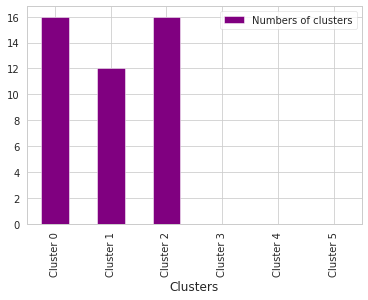

In [ ]:
count.plot.bar(x="Clusters", y="Numbers of clusters", color='purple')